In [1]:
import numpy as np
import os
import datetime as datetime
import pandas as pd


os.system('source /home/jackalak/heartbeat/cdf38_0-dist/bin/definitions.B')
os.environ["CDF_LIB"] = '/home/jackalak/heartbeat/cdf38_0-dist/lib'
from spacepy import pycdf
import matplotlib.pyplot as plt


import numpy as np
import pandas as pd
from datetime import timedelta

from nasaomnireader import omnireader

import ftplib
import os


import numpy as np
import os
import datetime as datetime
import pandas as pd





import pickle
import glob



import tensorflow as tf
from tensorflow import keras


import datetime

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
import tensorflow

import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout
from sklearn import preprocessing


from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

import matplotlib.pyplot as plt
%matplotlib notebook

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.layers import Input

Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/nasaomnireader-0.1.0-py3.6.egg/nasaomnireader/__init__.py", line 5, in <module>
    from nasaomnireader.omnireader_config import config
ModuleNotFoundError: No module named 'nasaomnireader.omnireader_config'

Solar wind data files will be saved to /home/jackalak/.local/share/nasaomnireader


In [2]:

# LOAD THE COMBINED SOURTHERN HEMISPHERE AND NORTHERN HEMISPHERE AS CREATED ABOVE
test = pd.DataFrame()

for ii in [17,18,6,7,8,9,12,13,14,15,16,]:

    filescname = "./sc_df_cleaned_" + str(ii) + ".pkl"
    pickle_file = open(filescname, "rb") 

    test =pd.concat([test,pickle.load(pickle_file)] )
    
# filescname = "./all_sc_df_1min_SH_NH_combined.pkl"
# pickle_file = open(filescname, "rb") 
# test =pickle.load(pickle_file)
print(test.columns.tolist())

['ELE_AVG_ENERGY', 'ELE_AVG_ENERGY_STD', 'ELE_TOTAL_ENERGY_FLUX', 'ELE_TOTAL_ENERGY_FLUX_STD', 'SC_AACGM_LAT', 'SC_AACGM_LON', 'SC_AACGM_LTIME', 'ELE_TOTAL_COUNTS', 'ELE_COUNT_1', 'ELE_COUNT_2', 'ELE_COUNT_3', 'ELE_COUNT_4', 'ELE_COUNT_5', 'ELE_COUNT_6', 'ELE_COUNT_7', 'ELE_COUNT_8', 'ELE_COUNT_9', 'ELE_COUNT_10', 'ELE_COUNT_11', 'ELE_COUNT_12', 'ELE_COUNT_13', 'ELE_COUNT_14', 'ELE_COUNT_15', 'ELE_COUNT_16', 'ELE_COUNT_17', 'ELE_COUNT_18', 'ELE_COUNT_19', 'ELE_diff_1', 'ELE_diff_2', 'ELE_diff_3', 'ELE_diff_4', 'ELE_diff_5', 'ELE_diff_6', 'ELE_diff_7', 'ELE_diff_8', 'ELE_diff_9', 'ELE_diff_10', 'ELE_diff_11', 'ELE_diff_12', 'ELE_diff_13', 'ELE_diff_14', 'ELE_diff_15', 'ELE_diff_16', 'ELE_diff_17', 'ELE_diff_18', 'ELE_diff_19', 'Bz', 'By', 'Vsw', 'Vx', 'Psw', 'AE', 'AL', 'AU', 'SymH', 'Clock Angle', 'newell', 'borovsky', 'Kp', 'F107', 'PC', 'Bx', 'Bz_6hr', 'By_6hr', 'Vsw_6hr', 'Vx_6hr', 'Psw_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'Clock Angle_6hr', 'newell_6hr', 'borovsky_6hr', 

In [3]:

def plot_model_counts(df_results):
    
    plt.figure()
    plt.plot(y_val_log[:])
    plt.plot(df_results[:])
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    plt.figure()
    plt.plot(10**y_val_log[:]*1.6e-6)
    plt.plot(10**df_results[:]*1.6e-6)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
    plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    minr = np.min(y_val_log.values)
    maxr = np.max(y_val_log.values)
    plt.figure()
    plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.legend(['result','val'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    errors= y_val_log.values-df_results.values[:,0]
    plt.figure();
    plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1)
    plt.title('Errors over SC_AACGM_LAT Bins')


    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/bin_total
    plt.figure()
    plt.scatter(np.linspace(45,90,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.show()
    
    errors= y_val_log.values-df_results.values[:,0]
    plt.figure();
    plt.scatter(y_val_log.values,errors,s=1)
    plt.title('Errors over target Bins')

    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((y_val_log[j]-0)/((8-0)/200))
        if (i < 200) and(i > 0):
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/(bin_total+.00001)
    plt.figure()
    plt.scatter(np.linspace(0,8,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over target Bins')    
    plt.show()

    import matplotlib.colors as mcolors
    gamma = 0.2#[0.8, 0.5, 0.3]
    errors= y_val_log.values-df_results.values[:,0]

    plt.figure();
    plt.hist2d(y_val_log.values, errors,
                  bins=50, norm=mcolors.PowerNorm(gamma))
    plt.colorbar()
    plt.title('Error Density')
    plt.xlabel('log10(y_true)')
    plt.ylabel('log10(y_true-y_pred)')

    plt.show()

In [4]:

def plot_model(df_results):
    
    plt.figure()
    plt.plot(y_val_log[:])
    plt.plot(df_results[:])
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    plt.figure()
    plt.plot(10**y_val_log[:]*1.6e-6)
    plt.plot(10**df_results[:]*1.6e-6)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
    plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    minr = np.min(y_val_log.values)
    maxr = np.max(y_val_log.values)
    plt.figure()
    plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.legend(['result','val'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    errors= y_val_log.values-df_results.values[:,0]
    plt.figure();
    plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1)
    plt.title('Errors over SC_AACGM_LAT Bins')


    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/bin_total
    plt.figure()
    plt.scatter(np.linspace(45,90,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.show()
    
    errors= y_val_log.values-df_results.values[:,0]
    plt.figure();
    plt.scatter(y_val_log.values,errors,s=1)
    plt.title('Errors over target Bins')

    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((y_val_log[j]-6)/((14-6)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/(bin_total+.00001)
    plt.figure()
    plt.scatter(np.linspace(0,8,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over target Bins')    
    plt.show()

    import matplotlib.colors as mcolors
    gamma = 0.2#[0.8, 0.5, 0.3]
    errors= y_val_log.values-df_results.values[:,0]

    plt.figure();
    plt.hist2d(y_val_log.values, errors,
                  bins=50, norm=mcolors.PowerNorm(gamma))
    plt.colorbar()
    plt.title('Error Density')
    plt.xlabel('log10(y_true)')
    plt.ylabel('log10(y_true-y_pred)')

    plt.show()

In [5]:

# LOAD THE COMBINED SOURTHERN HEMISPHERE AND NORTHERN HEMISPHERE AS CREATED ABOVE
df_cumulative = pd.DataFrame()
for ii in [17,18,6,7,8,9,12,13,14,15,16,]:
    filescname = "./sc_df_cleaned_" + str(ii) + ".pkl"
    pickle_file = open(filescname, "rb") 
    df_cumulative =pd.concat([df_cumulative,pickle.load(pickle_file)] )

df_cumulative=df_cumulative[['SC_AACGM_LAT', 'ELE_TOTAL_ENERGY_FLUX', 'SC_ID', 'sin_ut',
                             'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME',
                             'F107', 'AE', 'AL', 'AU', 'SymH', 
                             'F107_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'F107_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 
                             'F107_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 
                             'F107_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 
                             ]]

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['SC_ID'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])

del df_cumulative



# Construct X and y
feature_cols = [c for c in df_train.columns if not 'ELE' in c]
print( (feature_cols))
#print(df_cumulative.columns)
X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

del df_train

import tensorflow.keras.backend as K
from tensorflow.keras.layers import Input

def custom_loss(y_true, y_pred):
    

    loss = K.mean( 
        2.5*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,11.5),'float32')*K.cast(K.less_equal(y_pred,11.5),'float32') +
        5*(y_true-y_pred)*(y_true-y_pred) 
        *K.cast(K.greater(y_true,12.),'float32')*K.cast(K.less_equal(y_pred,12.0),'float32') +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,12.5),'float32')*K.cast(K.less_equal(y_pred,12.5),'float32')  
        +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,12.75),'float32')*K.cast(K.less_equal(y_pred,12.75),'float32')  
        +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,13.),'float32')*K.cast(K.less_equal(y_pred,13.),'float32')  
    )             
                 
            
    loss =  loss+K.mean((y_true-y_pred)*(y_true-y_pred))

    return loss

['SC_AACGM_LAT', 'SC_ID', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME', 'F107', 'AE', 'AL', 'AU', 'SymH', 'F107_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'F107_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'F107_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'F107_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr']


Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 33)]              0         
_________________________________________________________________
dense_9 (Dense)              (None, 256)               8704      
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_11 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_12 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_13 (Dense)             (None, 1024)             

Epoch 70/4000
188/188 - 4s - loss: 0.8819 - mse: 0.6130 - val_loss: 0.9021 - val_mse: 0.6981
Epoch 71/4000
188/188 - 4s - loss: 0.8812 - mse: 0.6117 - val_loss: 0.9015 - val_mse: 0.7246
Epoch 72/4000
188/188 - 4s - loss: 0.8795 - mse: 0.6112 - val_loss: 0.8950 - val_mse: 0.7213
Epoch 73/4000
188/188 - 4s - loss: 0.8786 - mse: 0.6108 - val_loss: 0.8860 - val_mse: 0.7116
Epoch 74/4000
188/188 - 4s - loss: 0.8788 - mse: 0.6111 - val_loss: 0.9054 - val_mse: 0.7235
Epoch 75/4000
188/188 - 4s - loss: 0.8786 - mse: 0.6108 - val_loss: 0.8944 - val_mse: 0.7036
Epoch 76/4000
188/188 - 4s - loss: 0.8767 - mse: 0.6091 - val_loss: 0.8951 - val_mse: 0.7183
Epoch 77/4000
188/188 - 4s - loss: 0.8785 - mse: 0.6106 - val_loss: 0.8957 - val_mse: 0.7111
Epoch 78/4000
188/188 - 4s - loss: 0.8768 - mse: 0.6094 - val_loss: 0.8971 - val_mse: 0.7022
Epoch 79/4000
188/188 - 4s - loss: 0.8755 - mse: 0.6089 - val_loss: 0.9084 - val_mse: 0.7134
Epoch 80/4000
188/188 - 4s - loss: 0.8775 - mse: 0.6106 - val_loss: 0.

Epoch 158/4000
188/188 - 4s - loss: 0.8558 - mse: 0.6033 - val_loss: 0.8991 - val_mse: 0.6912
Epoch 159/4000
188/188 - 4s - loss: 0.8590 - mse: 0.6039 - val_loss: 0.8939 - val_mse: 0.7088
Epoch 160/4000
188/188 - 4s - loss: 0.8561 - mse: 0.6030 - val_loss: 0.8818 - val_mse: 0.7167
Epoch 161/4000
188/188 - 4s - loss: 0.8560 - mse: 0.6027 - val_loss: 0.8830 - val_mse: 0.6919
Epoch 162/4000
188/188 - 4s - loss: 0.8539 - mse: 0.6017 - val_loss: 0.8766 - val_mse: 0.6982
Epoch 163/4000
188/188 - 4s - loss: 0.8566 - mse: 0.6021 - val_loss: 0.8783 - val_mse: 0.7093
Epoch 164/4000
188/188 - 4s - loss: 0.8540 - mse: 0.6022 - val_loss: 0.8806 - val_mse: 0.6902
Epoch 165/4000
188/188 - 4s - loss: 0.8565 - mse: 0.6024 - val_loss: 0.8830 - val_mse: 0.6951
Epoch 166/4000
188/188 - 4s - loss: 0.8578 - mse: 0.6029 - val_loss: 0.8945 - val_mse: 0.6877
Epoch 167/4000
188/188 - 4s - loss: 0.8552 - mse: 0.6027 - val_loss: 0.8752 - val_mse: 0.6960
Epoch 168/4000
188/188 - 4s - loss: 0.8549 - mse: 0.6016 - v

188/188 - 4s - loss: 0.8463 - mse: 0.5995 - val_loss: 0.8783 - val_mse: 0.6889
Epoch 246/4000
188/188 - 4s - loss: 0.8455 - mse: 0.5994 - val_loss: 0.8671 - val_mse: 0.6965
Epoch 247/4000
188/188 - 4s - loss: 0.8428 - mse: 0.5985 - val_loss: 0.8993 - val_mse: 0.6937
Epoch 248/4000
188/188 - 4s - loss: 0.8454 - mse: 0.5999 - val_loss: 0.8881 - val_mse: 0.6860
Epoch 249/4000
188/188 - 4s - loss: 0.8447 - mse: 0.5992 - val_loss: 0.8783 - val_mse: 0.6909
Epoch 250/4000
188/188 - 4s - loss: 0.8427 - mse: 0.5987 - val_loss: 0.8762 - val_mse: 0.6930
Epoch 251/4000
188/188 - 4s - loss: 0.8429 - mse: 0.5984 - val_loss: 0.8733 - val_mse: 0.7093
Epoch 252/4000
188/188 - 4s - loss: 0.8421 - mse: 0.5981 - val_loss: 0.8716 - val_mse: 0.7063
Epoch 253/4000
188/188 - 4s - loss: 0.8437 - mse: 0.5994 - val_loss: 0.8708 - val_mse: 0.7016
Epoch 254/4000
188/188 - 4s - loss: 0.8457 - mse: 0.5998 - val_loss: 0.8812 - val_mse: 0.7133
Epoch 255/4000
188/188 - 4s - loss: 0.8444 - mse: 0.5994 - val_loss: 0.8748

Epoch 333/4000
188/188 - 4s - loss: 0.8384 - mse: 0.5970 - val_loss: 0.8685 - val_mse: 0.7029
Epoch 334/4000
188/188 - 4s - loss: 0.8364 - mse: 0.5969 - val_loss: 0.8668 - val_mse: 0.6962
Epoch 335/4000
188/188 - 4s - loss: 0.8339 - mse: 0.5962 - val_loss: 0.8751 - val_mse: 0.6793
Epoch 336/4000
188/188 - 4s - loss: 0.8360 - mse: 0.5974 - val_loss: 0.8677 - val_mse: 0.7059
Epoch 337/4000
188/188 - 4s - loss: 0.8358 - mse: 0.5970 - val_loss: 0.8705 - val_mse: 0.7015
Epoch 338/4000
188/188 - 4s - loss: 0.8372 - mse: 0.5972 - val_loss: 0.8679 - val_mse: 0.7074
Epoch 339/4000
188/188 - 4s - loss: 0.8346 - mse: 0.5965 - val_loss: 0.8701 - val_mse: 0.6913
Epoch 340/4000
188/188 - 4s - loss: 0.8334 - mse: 0.5963 - val_loss: 0.8691 - val_mse: 0.6911
Epoch 341/4000
188/188 - 4s - loss: 0.8367 - mse: 0.5971 - val_loss: 0.9055 - val_mse: 0.6901
Epoch 342/4000
188/188 - 4s - loss: 0.8371 - mse: 0.5972 - val_loss: 0.8745 - val_mse: 0.6869
Epoch 343/4000
188/188 - 4s - loss: 0.8352 - mse: 0.5966 - v

<IPython.core.display.Javascript object>


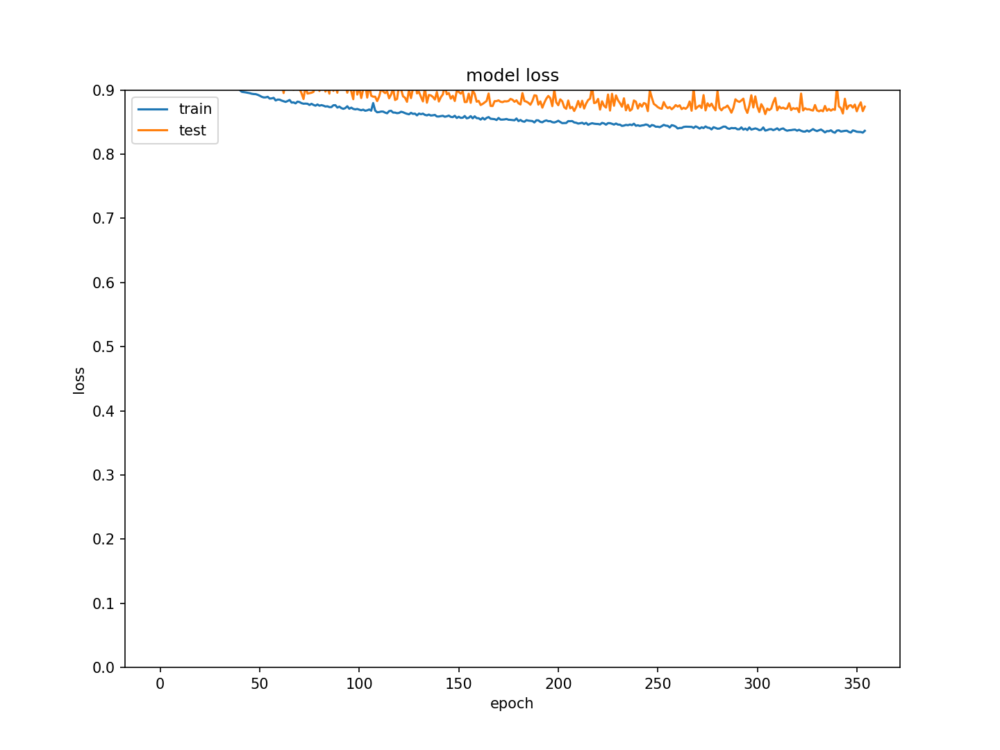

<IPython.core.display.Javascript object>


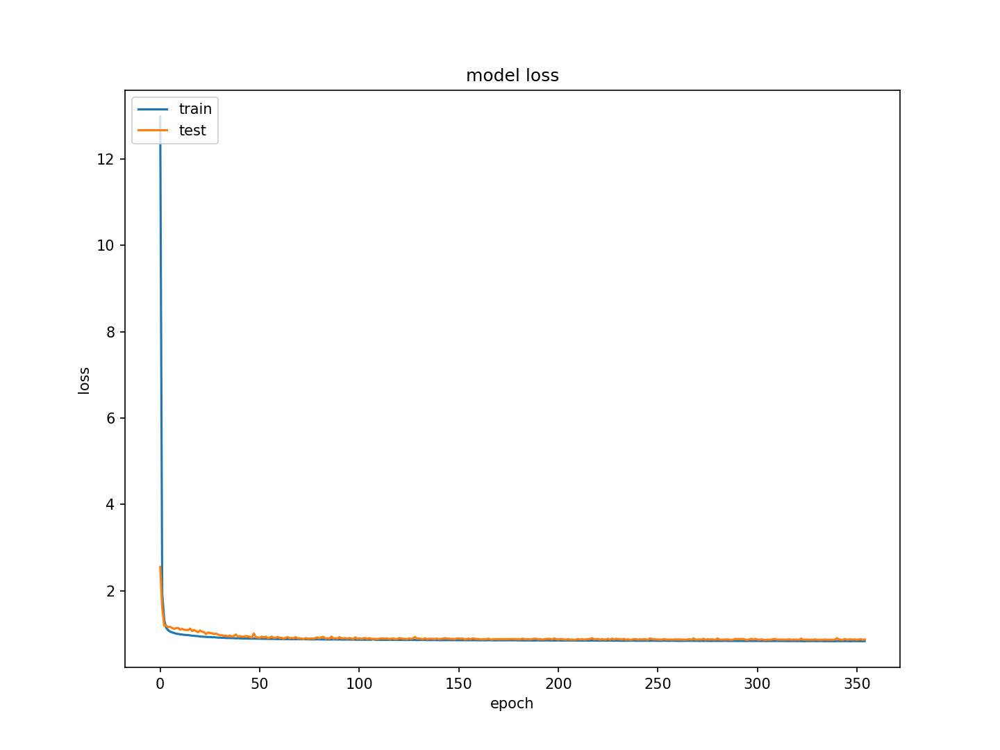

In [7]:


num_in = 33

input1 = Input(shape=(num_in))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer=tf.keras.optimizers.Adam(
    learning_rate=0.001),metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ),
                    batch_size=8192*4,epochs=4000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: tail_loss_new_pipeline_33/assets
5357/5357 [==============================] - 6s 1ms/step - loss: 0.8625 - mean_squared_error: 0.7075
[0.8625203967094421, 0.7074905037879944]


<IPython.core.display.Javascript object>


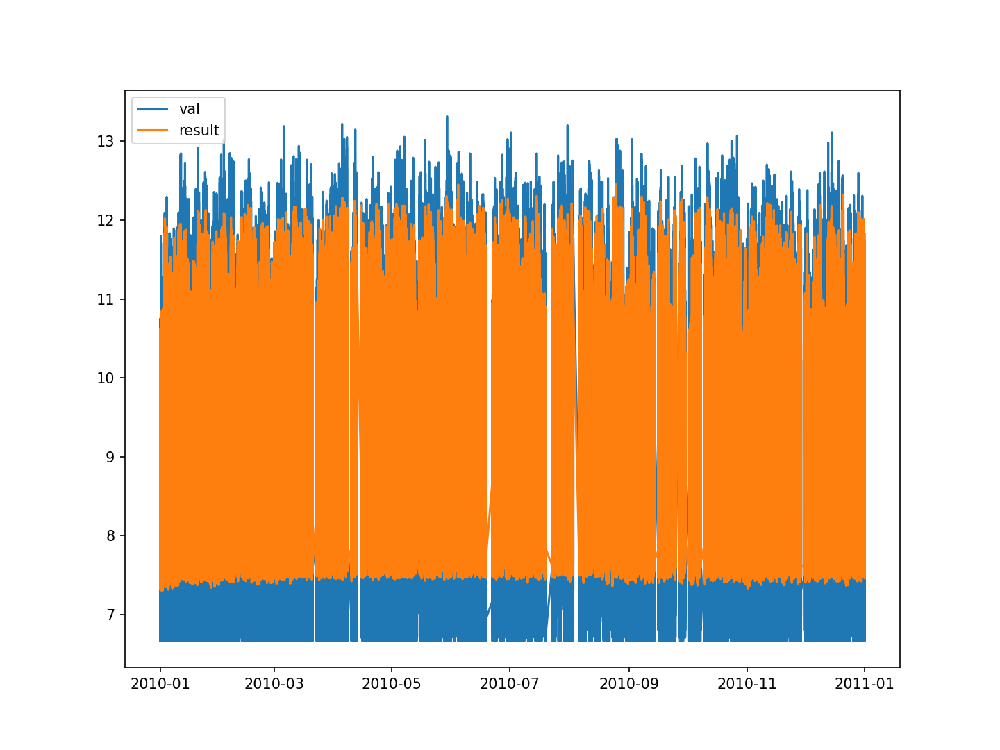

<IPython.core.display.Javascript object>


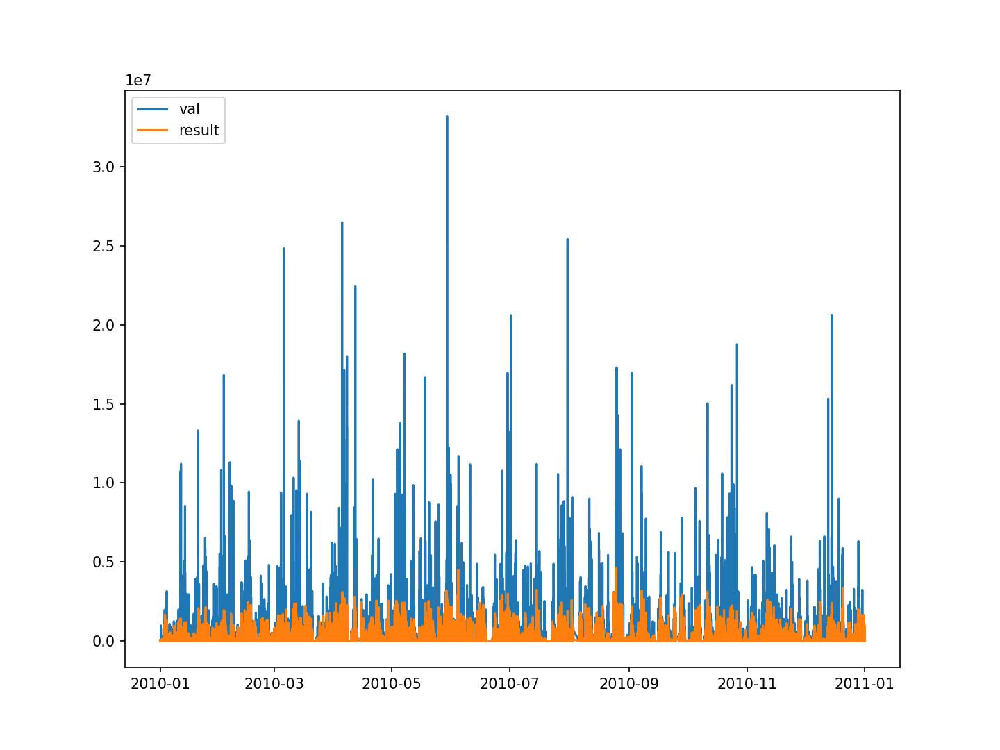

<IPython.core.display.Javascript object>


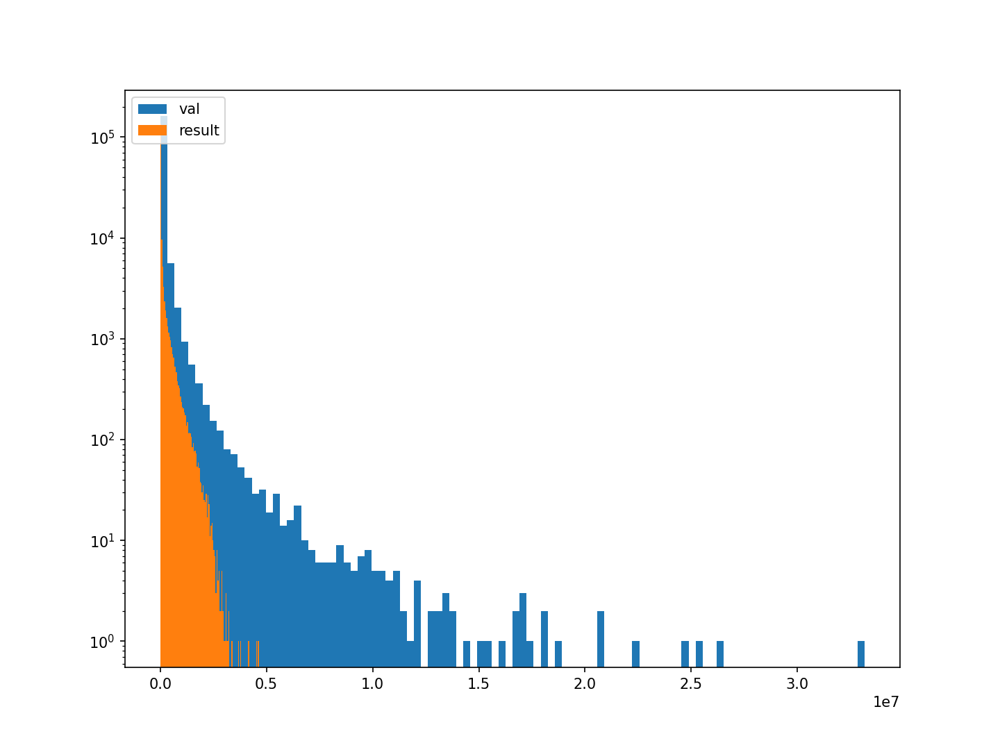

<IPython.core.display.Javascript object>


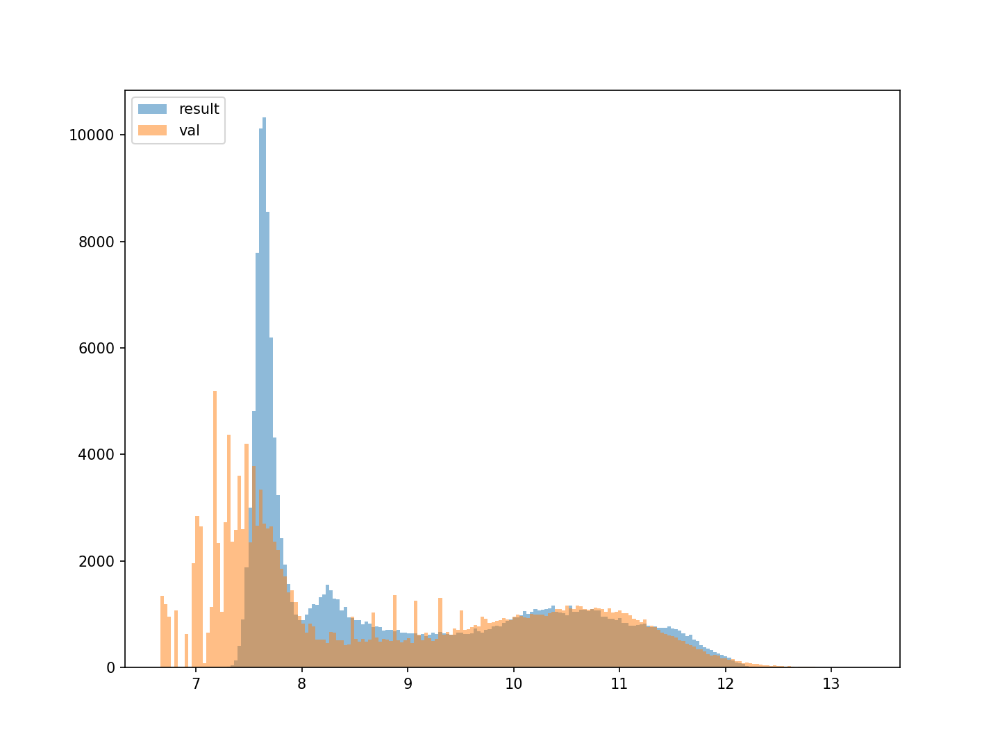

<IPython.core.display.Javascript object>


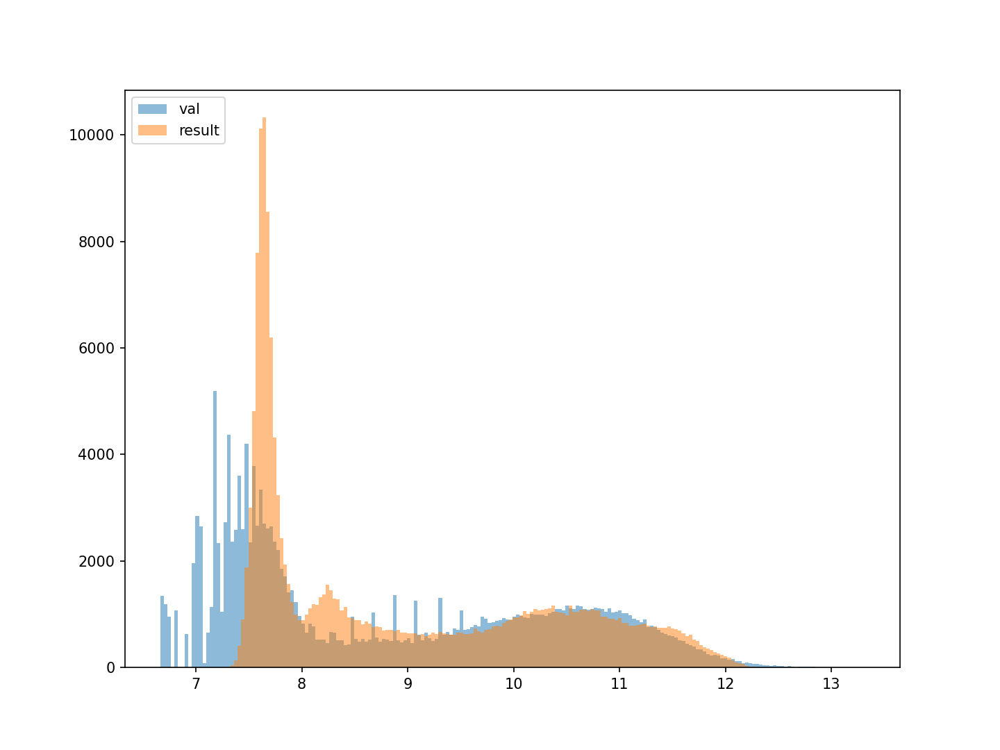

<IPython.core.display.Javascript object>


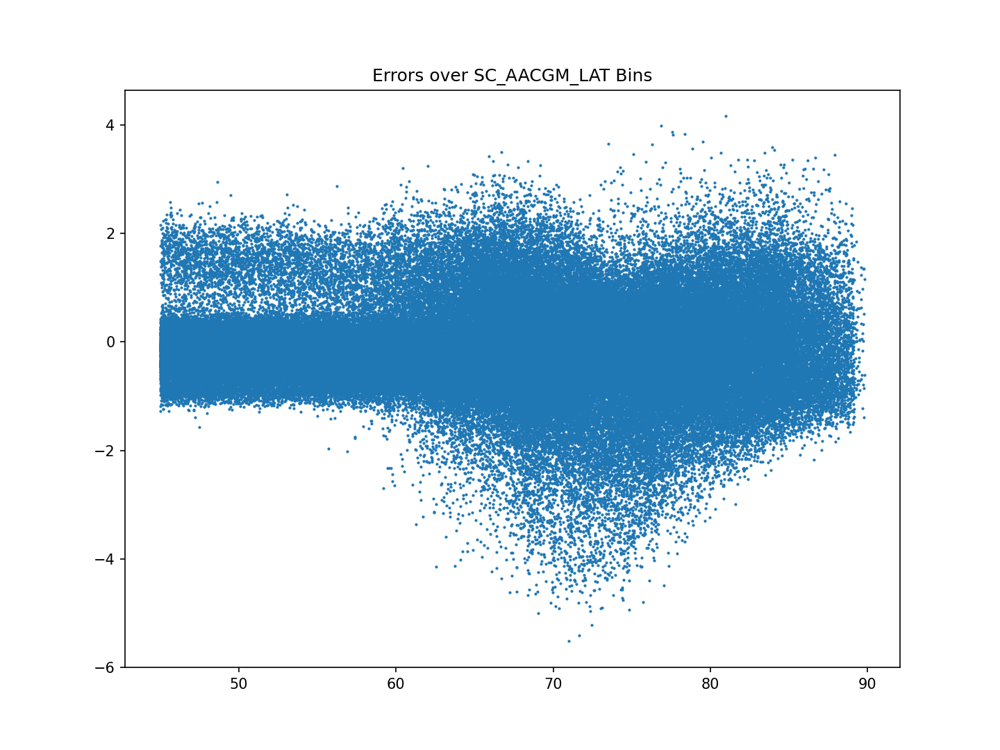

<IPython.core.display.Javascript object>


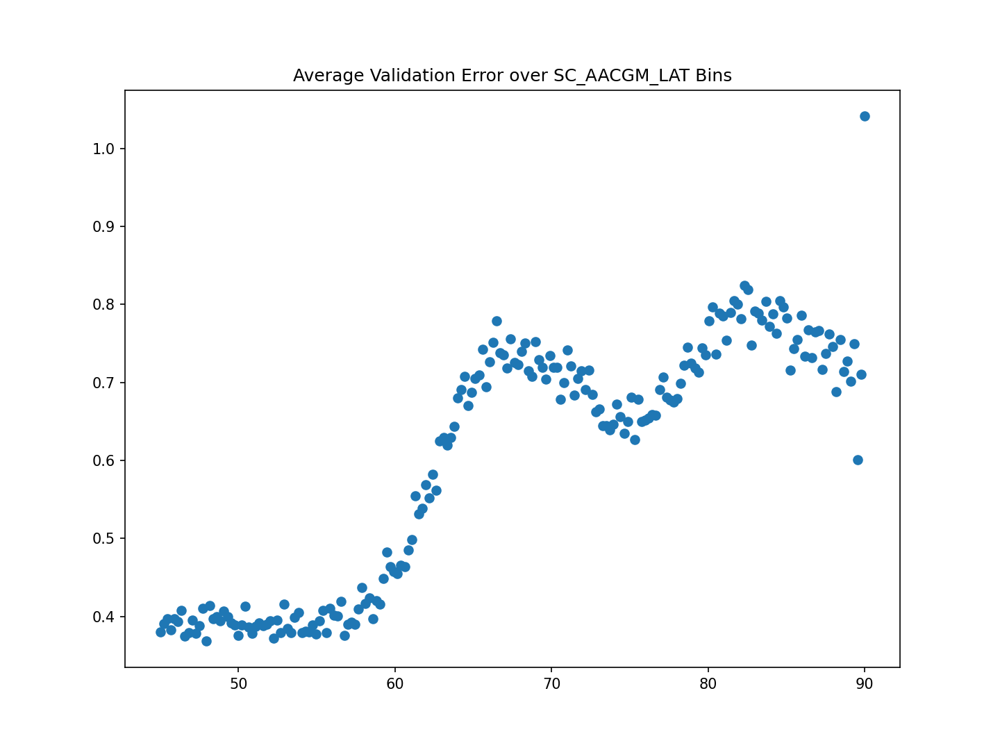

<IPython.core.display.Javascript object>


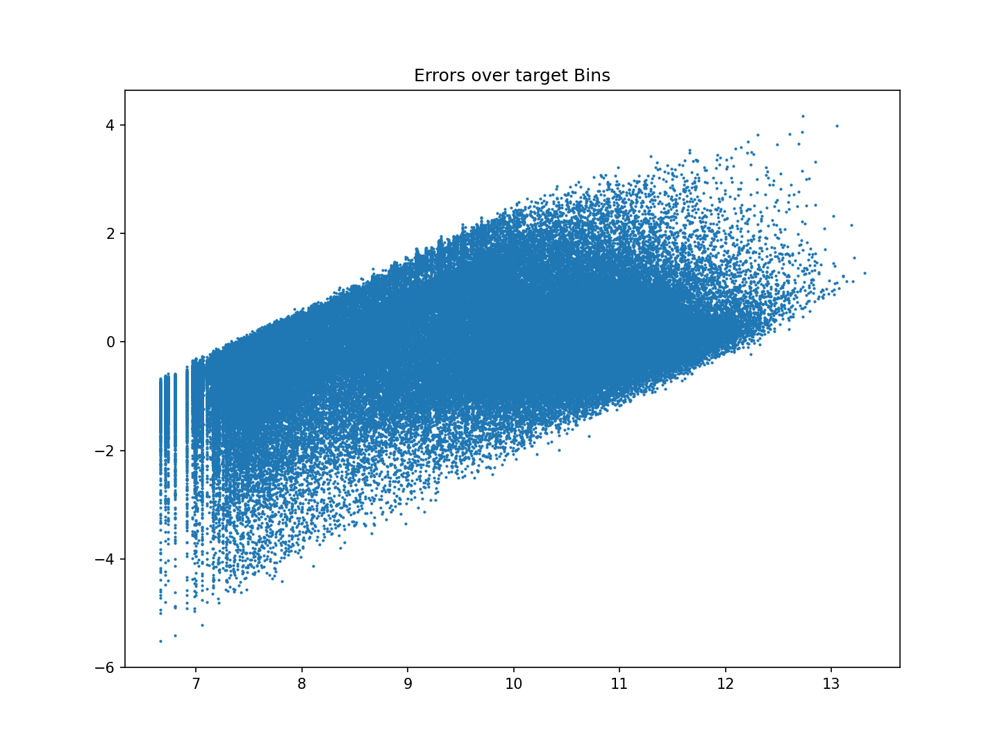

<IPython.core.display.Javascript object>


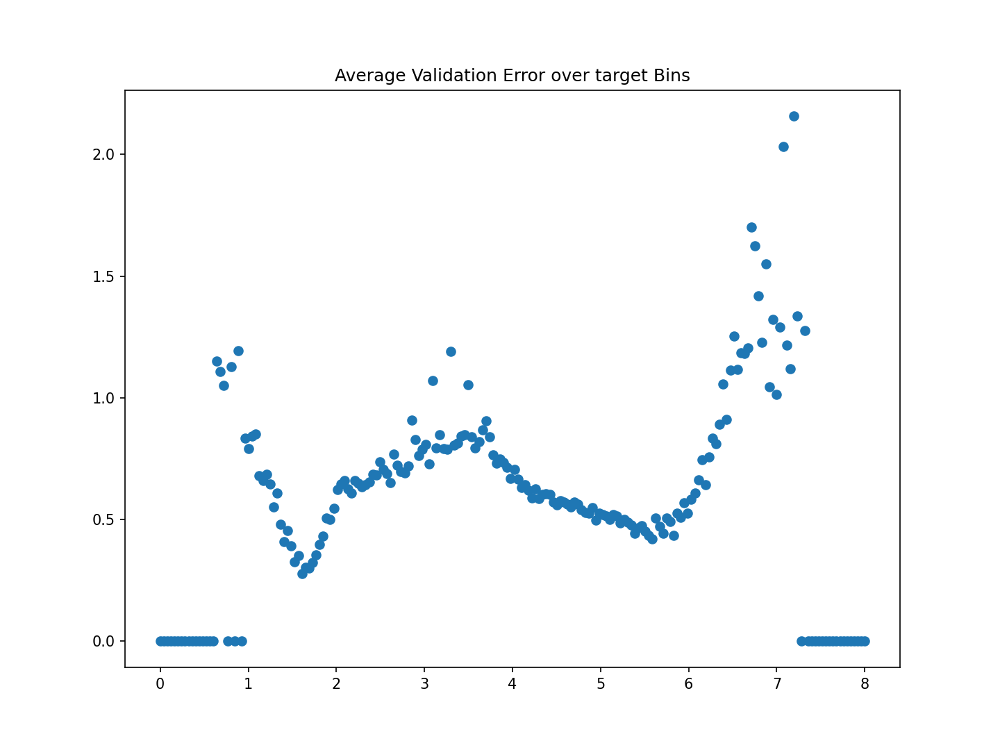

<IPython.core.display.Javascript object>


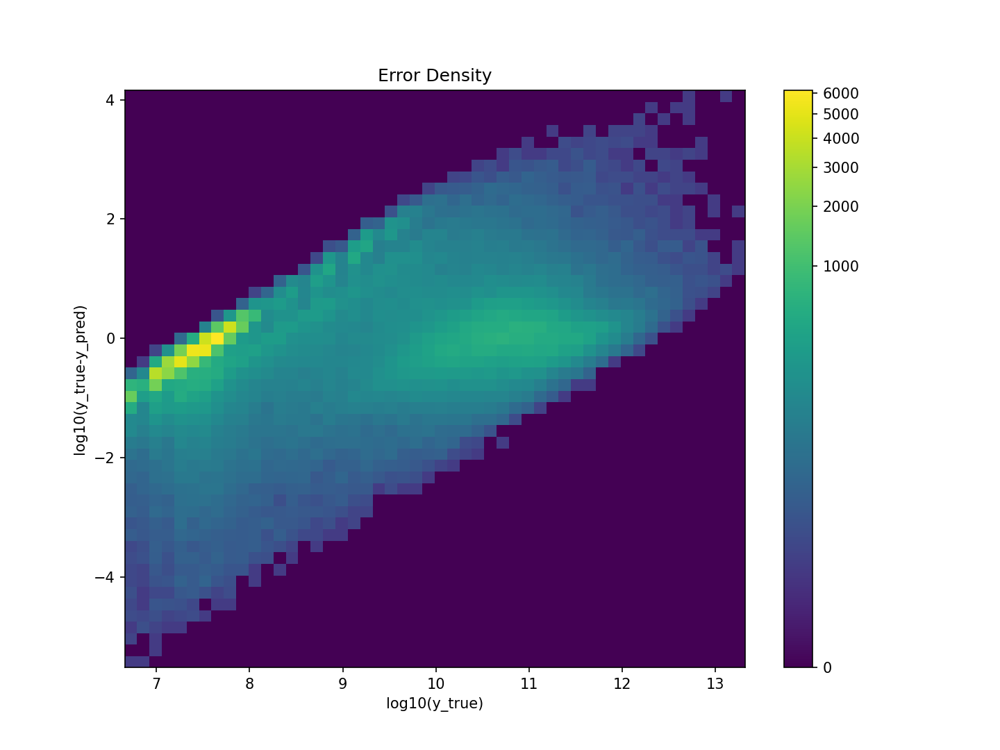

In [8]:
filename='tail_loss_new_pipeline_33'
model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss})

with open ('scalar_X_33_new_DB.pkl', 'wb') as f:
  pickle.dump(scaler_X, f)

with open ('scalar_X_33_new_DB.pkl', 'rb') as f:
    scalar_X =pickle.load(f)
print(model.evaluate(scaler_X.transform(X_val.values),y_val_log.values))

results = model.predict( X_test)

df_results = pd.DataFrame(data=results, index = y_val_log.index)

tail_loss_new_pipeline2_reduced = df_results

plot_model(df_results)



In [ ]:
#### NOW REPEATING FOR ELE_TOTAL_COUNTS INSTEAD OF TOTAL FLUX

In [9]:

# LOAD THE COMBINED SOURTHERN HEMISPHERE AND NORTHERN HEMISPHERE AS CREATED ABOVE
df_cumulative = pd.DataFrame()
for ii in [17,18,6,7,8,9,12,13,14,15,16,]:
    filescname = "./sc_df_cleaned_" + str(ii) + ".pkl"
    pickle_file = open(filescname, "rb") 
    df_cumulative =pd.concat([df_cumulative,pickle.load(pickle_file)] )

df_cumulative=df_cumulative[['SC_AACGM_LAT', 'ELE_TOTAL_COUNTS', 'SC_ID', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME',
 'F107', 'AE', 'AL', 'AU', 'SymH', 
                             'F107_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'F107_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 
                             'F107_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 
                             'F107_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', ]]


# #### GET RID OF THE REALLY SMALL VALUES
df_cumulative = df_cumulative.drop( df_cumulative.index[(df_cumulative['ELE_TOTAL_COUNTS']) < 3])

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['SC_ID'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])

del df_cumulative



# Construct X and y
feature_cols = [c for c in df_train.columns if not 'ELE' in c]
print( (feature_cols))
#print(df_cumulative.columns)
X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_COUNTS'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_COUNTS'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

# y_train[y_train == 0] = 0.0001
# y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

del df_train

import tensorflow.keras.backend as K
from tensorflow.keras.layers import Input

def custom_loss(y_true, y_pred):
    

    loss = K.mean( 
        2.5*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,6.25),'float32')*K.cast(K.less_equal(y_pred,6.25),'float32') +
        5*(y_true-y_pred)*(y_true-y_pred) 
        *K.cast(K.greater(y_true,6.75),'float32')*K.cast(K.less_equal(y_pred,6.75),'float32') +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,7),'float32')*K.cast(K.less_equal(y_pred,7),'float32')  
        +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,7.25),'float32')*K.cast(K.less_equal(y_pred,7.25),'float32')  
        +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,7.5),'float32')*K.cast(K.less_equal(y_pred,7.5),'float32')  
    )             
                 
            
    loss =  loss+K.mean((y_true-y_pred)*(y_true-y_pred))

    return loss

['SC_AACGM_LAT', 'SC_ID', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME', 'F107', 'AE', 'AL', 'AU', 'SymH', 'F107_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'F107_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'F107_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'F107_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr']


Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 33)]              0         
_________________________________________________________________
dense_18 (Dense)             (None, 256)               8704      
_________________________________________________________________
dropout_2 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_19 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_20 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_21 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_22 (Dense)             (None, 1024)             

Epoch 70/4000
187/187 - 4s - loss: 0.8458 - mse: 0.5516 - val_loss: 1.0766 - val_mse: 0.7527
Epoch 71/4000
187/187 - 4s - loss: 0.8447 - mse: 0.5507 - val_loss: 1.0641 - val_mse: 0.7476
Epoch 72/4000
187/187 - 4s - loss: 0.8442 - mse: 0.5506 - val_loss: 1.0801 - val_mse: 0.7423
Epoch 73/4000
187/187 - 4s - loss: 0.8453 - mse: 0.5515 - val_loss: 1.0637 - val_mse: 0.7401
Epoch 74/4000
187/187 - 4s - loss: 0.8437 - mse: 0.5504 - val_loss: 1.1106 - val_mse: 0.7952
Epoch 75/4000
187/187 - 4s - loss: 0.8430 - mse: 0.5503 - val_loss: 1.1030 - val_mse: 0.6998
Epoch 76/4000
187/187 - 4s - loss: 0.8415 - mse: 0.5484 - val_loss: 1.1010 - val_mse: 0.7062
Epoch 77/4000
187/187 - 4s - loss: 0.8430 - mse: 0.5496 - val_loss: 1.0586 - val_mse: 0.7520
Epoch 78/4000
187/187 - 4s - loss: 0.8432 - mse: 0.5502 - val_loss: 1.0738 - val_mse: 0.7439
Epoch 79/4000
187/187 - 4s - loss: 0.8429 - mse: 0.5494 - val_loss: 1.0638 - val_mse: 0.7526
Epoch 80/4000
187/187 - 4s - loss: 0.8399 - mse: 0.5482 - val_loss: 1.

Epoch 158/4000
187/187 - 4s - loss: 0.8189 - mse: 0.5375 - val_loss: 1.0469 - val_mse: 0.7244
Epoch 159/4000
187/187 - 4s - loss: 0.8201 - mse: 0.5373 - val_loss: 1.0603 - val_mse: 0.7336
Epoch 160/4000
187/187 - 4s - loss: 0.8185 - mse: 0.5368 - val_loss: 1.0306 - val_mse: 0.7640
Epoch 161/4000
187/187 - 4s - loss: 0.8195 - mse: 0.5372 - val_loss: 1.0326 - val_mse: 0.7375
Epoch 162/4000
187/187 - 4s - loss: 0.8185 - mse: 0.5369 - val_loss: 1.0298 - val_mse: 0.7520
Epoch 163/4000
187/187 - 4s - loss: 0.8176 - mse: 0.5365 - val_loss: 1.0632 - val_mse: 0.7202
Epoch 164/4000
187/187 - 4s - loss: 0.8188 - mse: 0.5365 - val_loss: 1.0300 - val_mse: 0.7976
Epoch 165/4000
187/187 - 4s - loss: 0.8174 - mse: 0.5367 - val_loss: 1.0436 - val_mse: 0.7472
Epoch 166/4000
187/187 - 4s - loss: 0.8185 - mse: 0.5370 - val_loss: 1.0383 - val_mse: 0.7642
Epoch 167/4000
187/187 - 4s - loss: 0.8178 - mse: 0.5374 - val_loss: 1.0249 - val_mse: 0.7609
Epoch 168/4000
187/187 - 4s - loss: 0.8178 - mse: 0.5359 - v

<IPython.core.display.Javascript object>


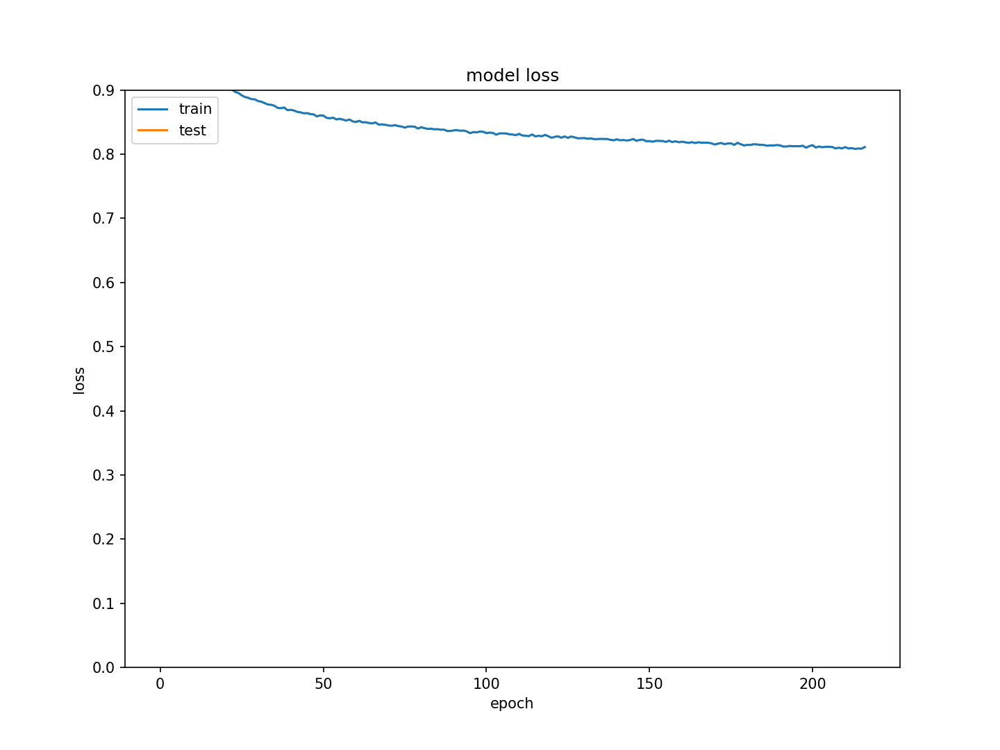

<IPython.core.display.Javascript object>


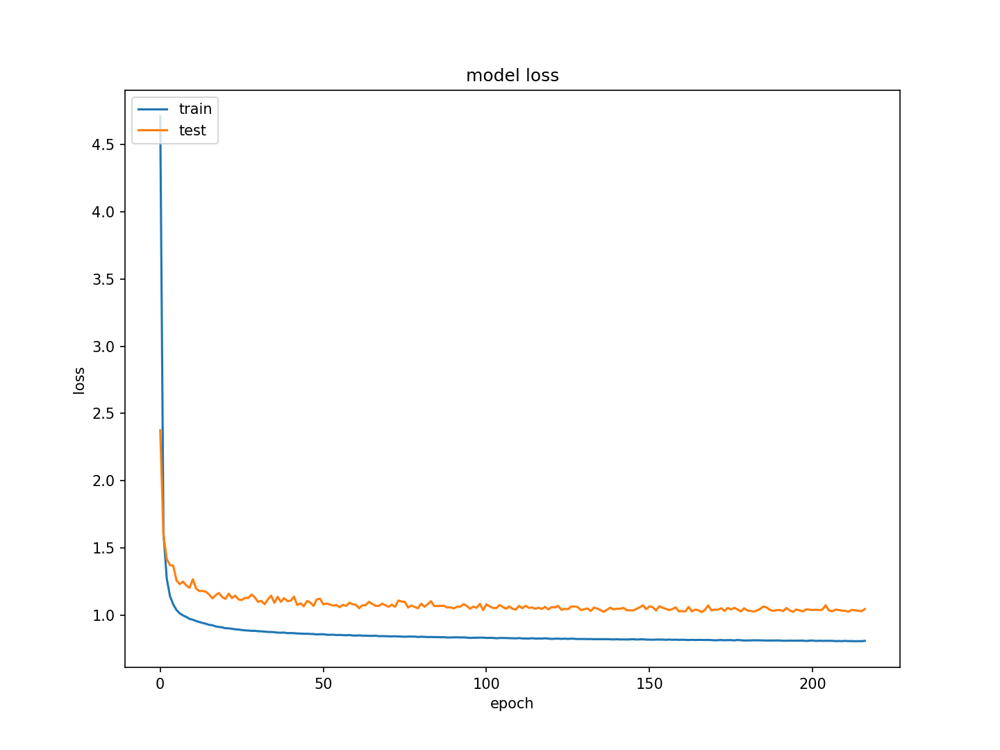

In [10]:



num_in = 33

input1 = Input(shape=(num_in))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer=tf.keras.optimizers.Adam(
    learning_rate=0.001),metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ),
                    batch_size=8192*4,epochs=4000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


INFO:tensorflow:Assets written to: counts_tail_loss_new_pipeline_33/assets
5284/5284 [==============================] - 6s 1ms/step - loss: 1.0249 - mean_squared_error: 0.7609
[1.0248509645462036, 0.7608754634857178]


<IPython.core.display.Javascript object>


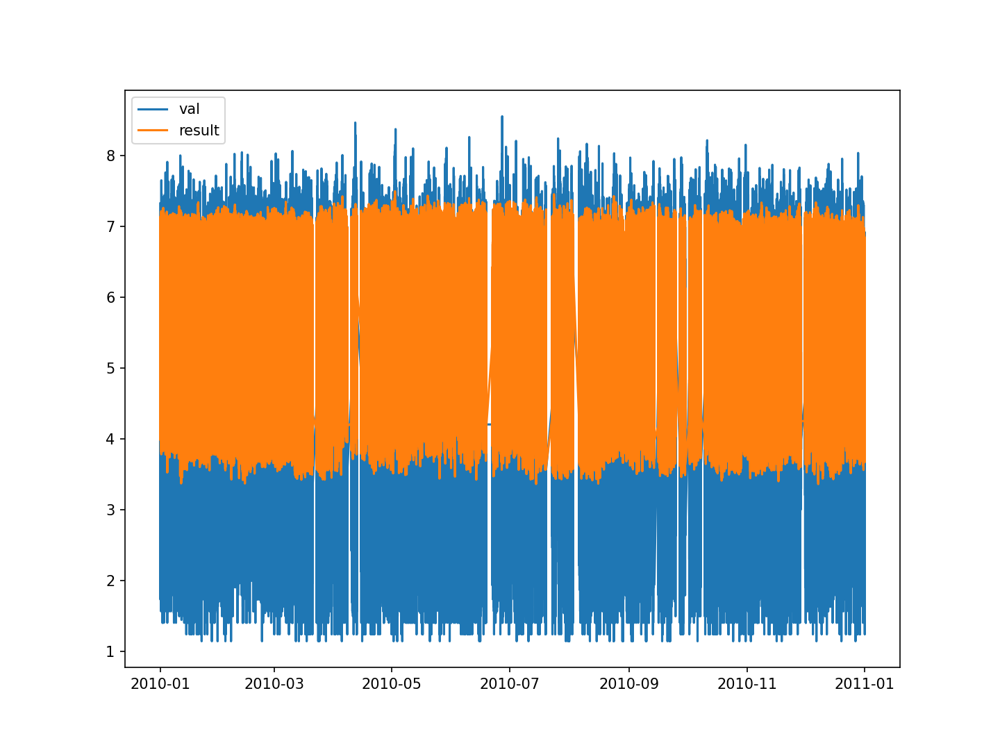

<IPython.core.display.Javascript object>


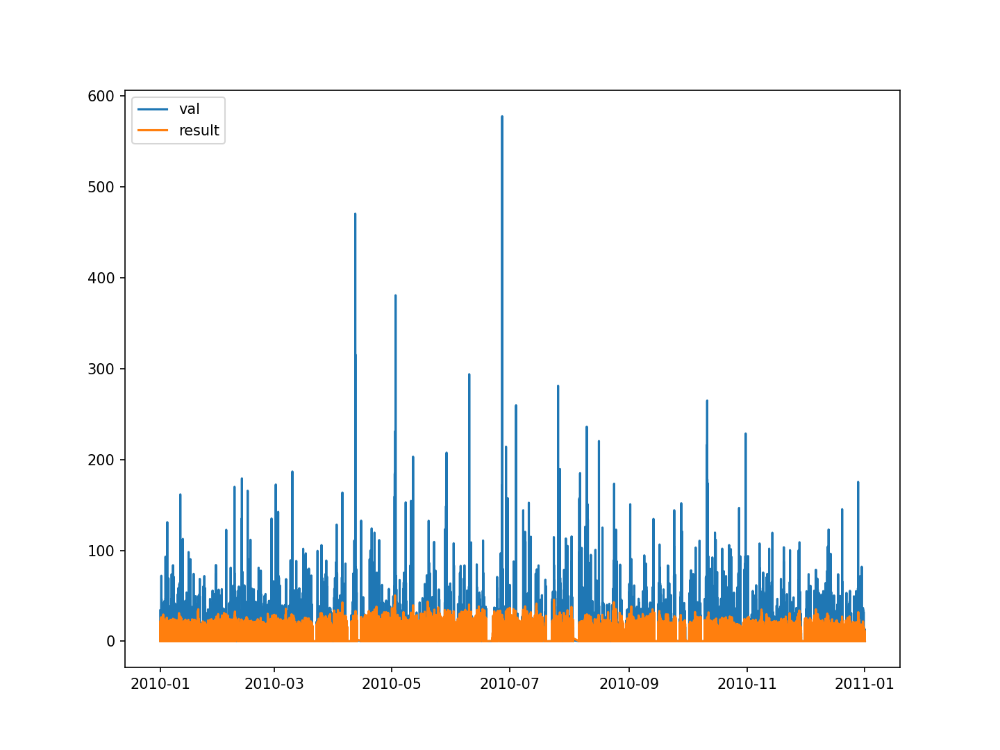

<IPython.core.display.Javascript object>


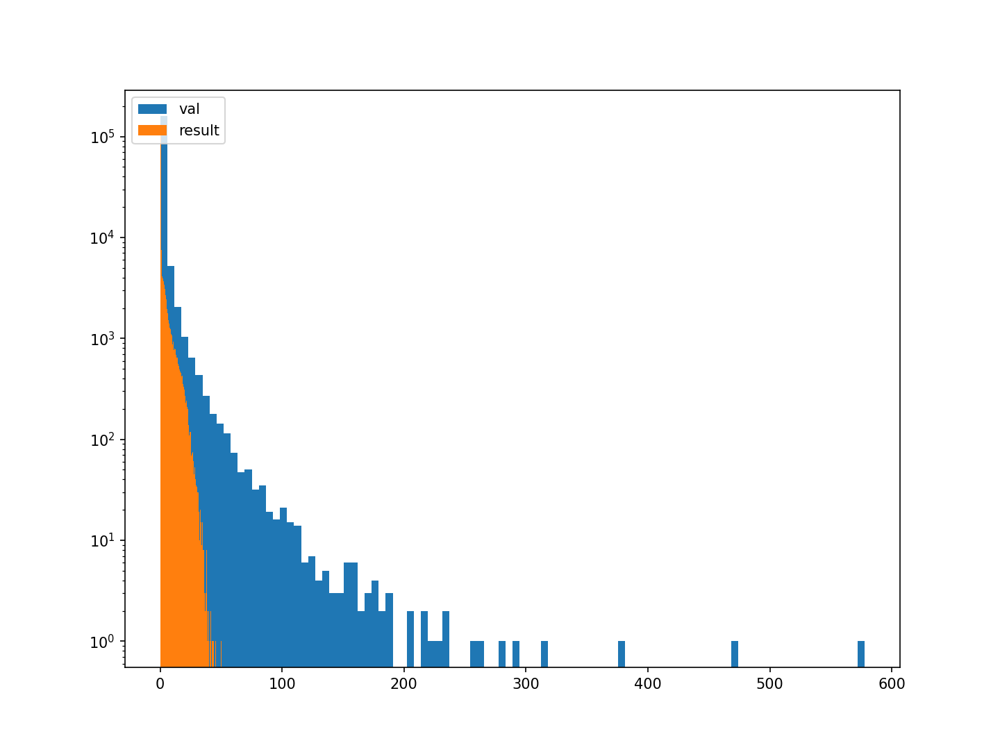

<IPython.core.display.Javascript object>


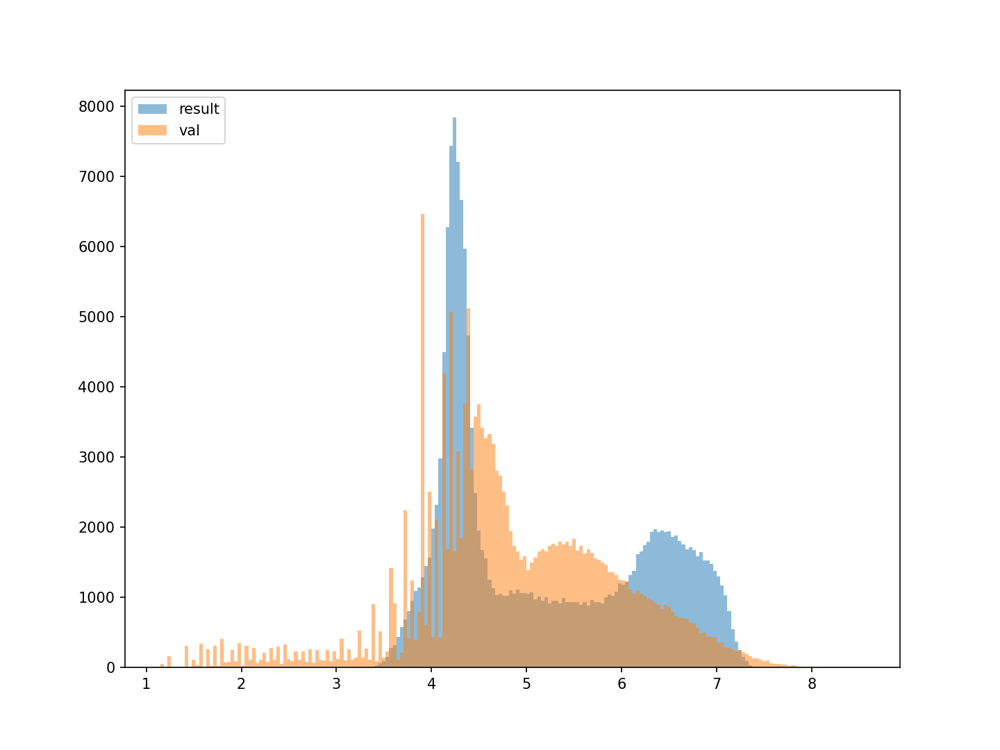

<IPython.core.display.Javascript object>


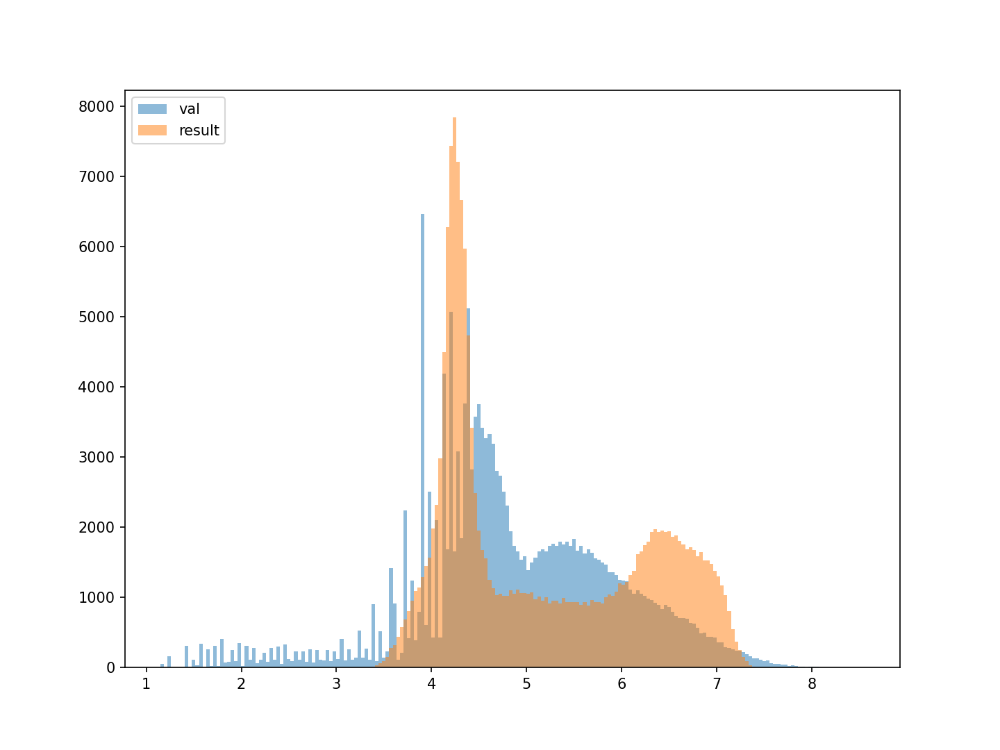

<IPython.core.display.Javascript object>


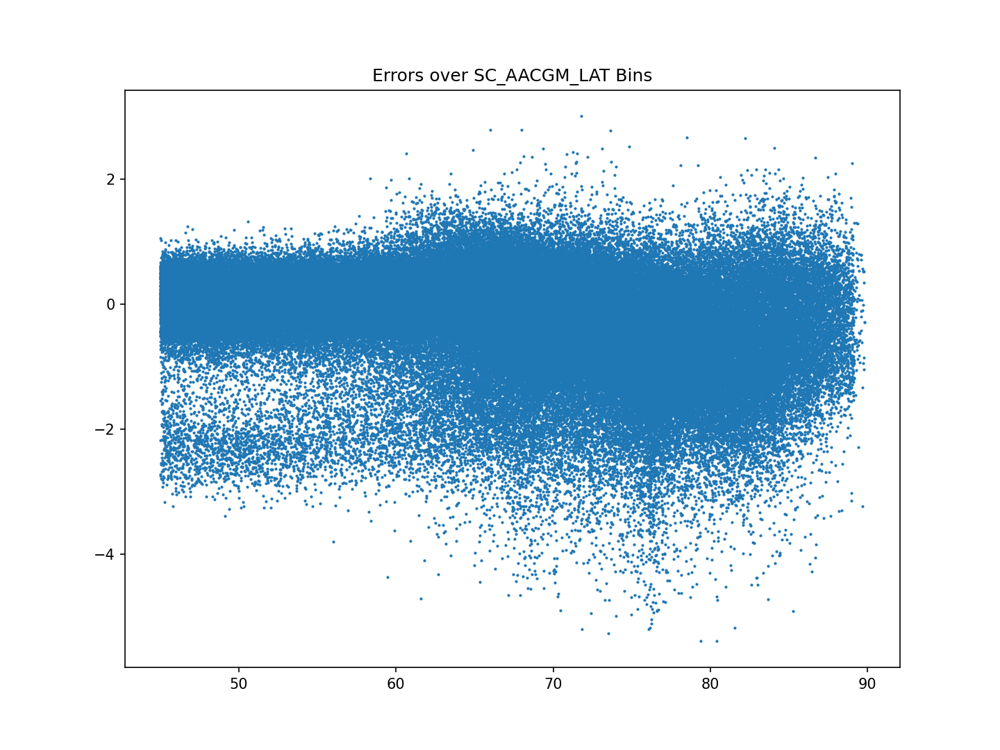

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:52: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


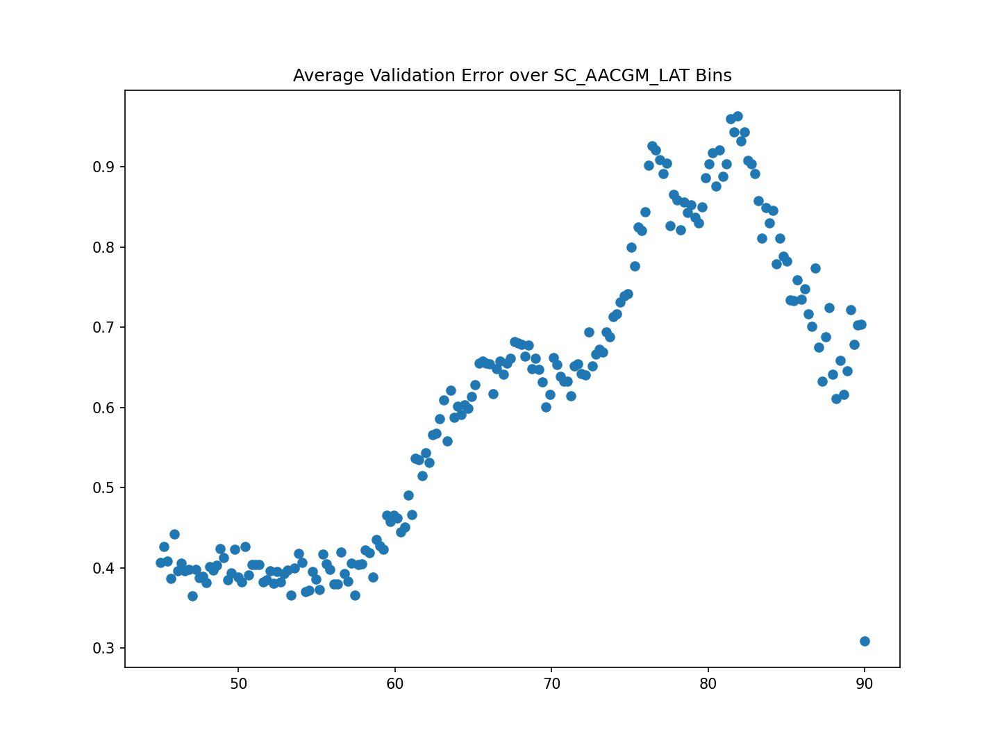

<IPython.core.display.Javascript object>


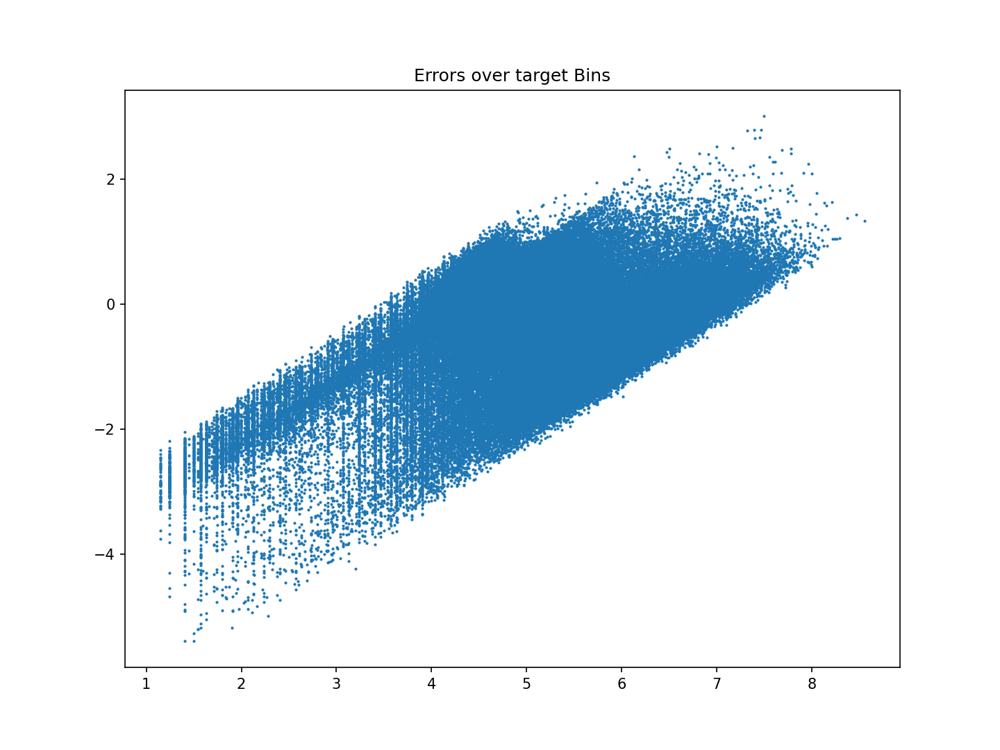

<IPython.core.display.Javascript object>


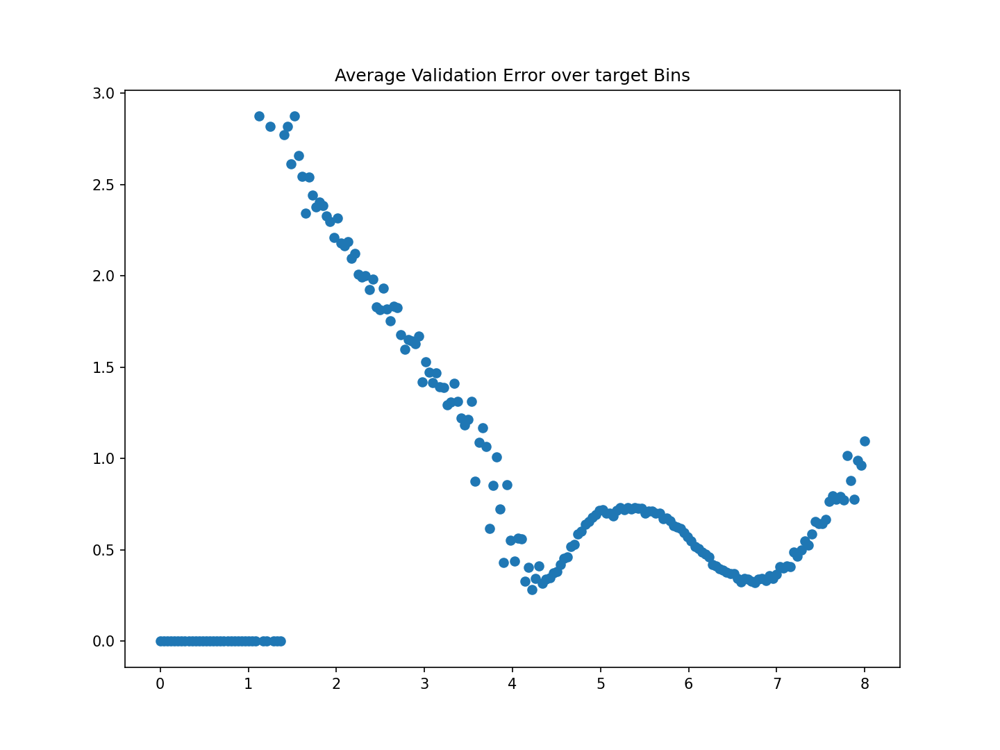

<IPython.core.display.Javascript object>


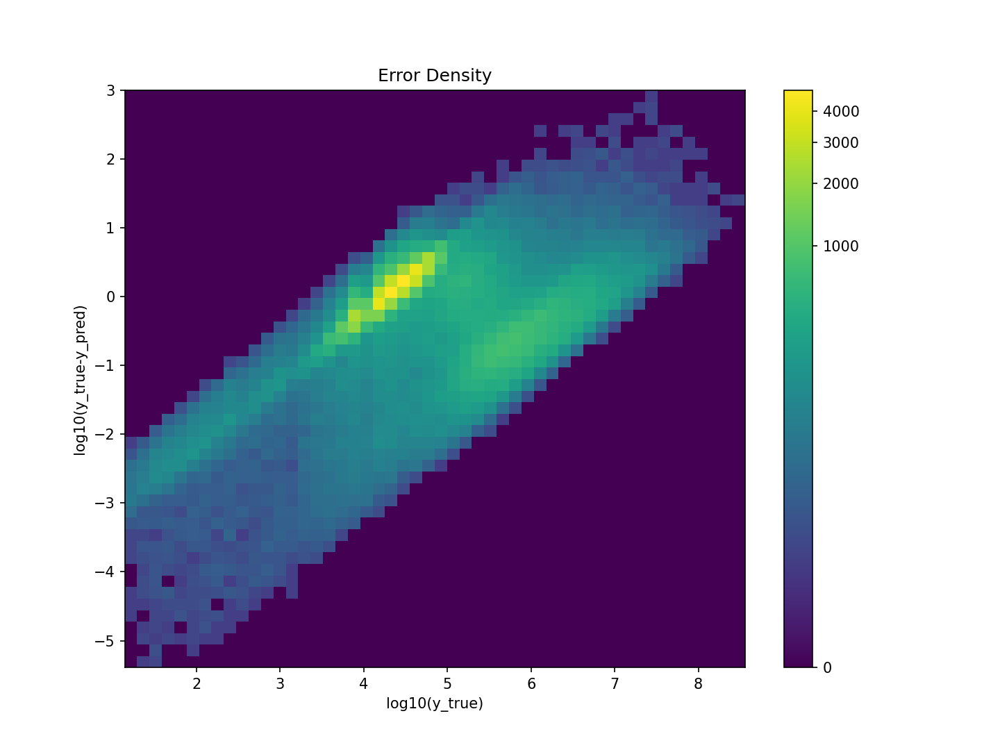

In [11]:
filename='counts_tail_loss_new_pipeline_33'
model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss})

with open ('scalar_X_33_counts_new_DB.pkl', 'wb') as f:
  pickle.dump(scaler_X, f)

with open ('scalar_X_33_counts_new_DB.pkl', 'rb') as f:
    scalar_X =pickle.load(f)
print(model.evaluate(scaler_X.transform(X_val.values),y_val_log.values))

results = model.predict( X_test)

df_results = pd.DataFrame(data=results, index = y_val_log.index)

plot_model_counts(df_results)


In [12]:
import tensorflow.keras.backend as K
from tensorflow.keras.layers import Input

def custom_loss(y_true, y_pred):
    

    loss = K.mean( 
#         10*(y_true-y_pred)*(y_true-y_pred)
#         *K.cast(K.greater(y_true,1.25),'float32')*K.cast(K.less_equal(y_pred,1.25),'float32') +
#         10*(y_true-y_pred)*(y_true-y_pred) 
#         *K.cast(K.greater(y_true,2.),'float32')*K.cast(K.less_equal(y_pred,2.0),'float32') +
#         10*(y_true-y_pred)*(y_true-y_pred)
#         *K.cast(K.greater(y_true,2.33),'float32')*K.cast(K.less_equal(y_pred,2.5),'float32')  
        +
        2.5*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,2.66),'float32')*K.cast(K.less_equal(y_pred,2.66),'float32')  
        +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,3.),'float32')*K.cast(K.less_equal(y_pred,3.),'float32')  
                +
        10*(y_true-y_pred)*(y_true-y_pred)
        *K.cast(K.greater(y_true,3.5),'float32')*K.cast(K.less_equal(y_pred,3.33),'float32')  
    )             
                 
            
    loss =  loss+K.mean((y_true-y_pred)*(y_true-y_pred))

    return loss

## Now repeat training for each channel separately

# LOAD THE COMBINED SOURTHERN HEMISPHERE AND NORTHERN HEMISPHERE AS CREATED ABOVE
df_cumulative = pd.DataFrame()
for ii in [17,18,6,7,8,9,12,13,14,15,16,]:
    filescname = "./sc_df_cleaned_" + str(ii) + ".pkl"
    pickle_file = open(filescname, "rb") 
    df_cumulative =pd.concat([df_cumulative,pickle.load(pickle_file)] )

cols_to_drop_validation = [c for c in df_cumulative.columns if ('SC_AACGM_LON' in c) | ('STD' in c) | ('Kp' in c )| ('Clock' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]
df_cumulative = df_cumulative.drop(columns=cols_to_drop_validation)
df_cumulative=df_cumulative.dropna()
# #### GET RID OF THE REALLY SMALL VALUES
# df_cumulative = df_cumulative.drop( df_cumulative.index[(df_cumulative['ELE_TOTAL_COUNTS']) < 4])

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['SC_ID'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])


del df_cumulative


# Construct X and y
feature_cols = ['SC_AACGM_LAT',  'SC_ID', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME',
 'F107', 'AE', 'AL', 'AU', 'SymH', 
                             'F107_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'F107_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 
                             'F107_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 
                             'F107_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', ]


X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val[['ELE_COUNT_1','ELE_COUNT_2', 'ELE_COUNT_3', 'ELE_COUNT_4', 'ELE_COUNT_5', 'ELE_COUNT_6', 'ELE_COUNT_7', 'ELE_COUNT_8', 'ELE_COUNT_9', 'ELE_COUNT_10', 'ELE_COUNT_11', 'ELE_COUNT_12', 'ELE_COUNT_13', 'ELE_COUNT_14', 'ELE_COUNT_15', 'ELE_COUNT_16', 'ELE_COUNT_17', 'ELE_COUNT_18', 'ELE_COUNT_19']].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train[['ELE_COUNT_1','ELE_COUNT_2', 'ELE_COUNT_3', 'ELE_COUNT_4', 'ELE_COUNT_5', 'ELE_COUNT_6', 'ELE_COUNT_7', 'ELE_COUNT_8', 'ELE_COUNT_9', 'ELE_COUNT_10', 'ELE_COUNT_11', 'ELE_COUNT_12', 'ELE_COUNT_13', 'ELE_COUNT_14', 'ELE_COUNT_15', 'ELE_COUNT_16', 'ELE_COUNT_17', 'ELE_COUNT_18', 'ELE_COUNT_19']].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 1 #0.0001
y_val[y_val == 0] = 1 #0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

del df_train



Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 33)]              0         
_________________________________________________________________
dense_27 (Dense)             (None, 256)               8704      
_________________________________________________________________
dropout_3 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_28 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_29 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_30 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_31 (Dense)             (None, 1024)             

188/188 - 4s - loss: 0.3850 - mse: 0.2283 - val_loss: 0.4201 - val_mse: 0.2545
Epoch 72/1000
188/188 - 4s - loss: 0.3846 - mse: 0.2281 - val_loss: 0.4224 - val_mse: 0.2512
Epoch 73/1000
188/188 - 4s - loss: 0.3847 - mse: 0.2282 - val_loss: 0.4244 - val_mse: 0.2479
Epoch 74/1000
188/188 - 4s - loss: 0.3849 - mse: 0.2284 - val_loss: 0.4254 - val_mse: 0.2406
Epoch 75/1000
188/188 - 4s - loss: 0.3846 - mse: 0.2281 - val_loss: 0.4291 - val_mse: 0.2438
Epoch 76/1000
188/188 - 4s - loss: 0.3845 - mse: 0.2281 - val_loss: 0.4285 - val_mse: 0.2409
Epoch 77/1000
188/188 - 4s - loss: 0.3843 - mse: 0.2282 - val_loss: 0.4262 - val_mse: 0.2412
Epoch 78/1000
188/188 - 4s - loss: 0.3841 - mse: 0.2280 - val_loss: 0.4232 - val_mse: 0.2430
Epoch 79/1000
188/188 - 4s - loss: 0.3841 - mse: 0.2279 - val_loss: 0.4222 - val_mse: 0.2500
Epoch 80/1000
188/188 - 4s - loss: 0.3838 - mse: 0.2279 - val_loss: 0.4241 - val_mse: 0.2461
Epoch 81/1000
188/188 - 4s - loss: 0.3835 - mse: 0.2278 - val_loss: 0.4245 - val_mse

<IPython.core.display.Javascript object>


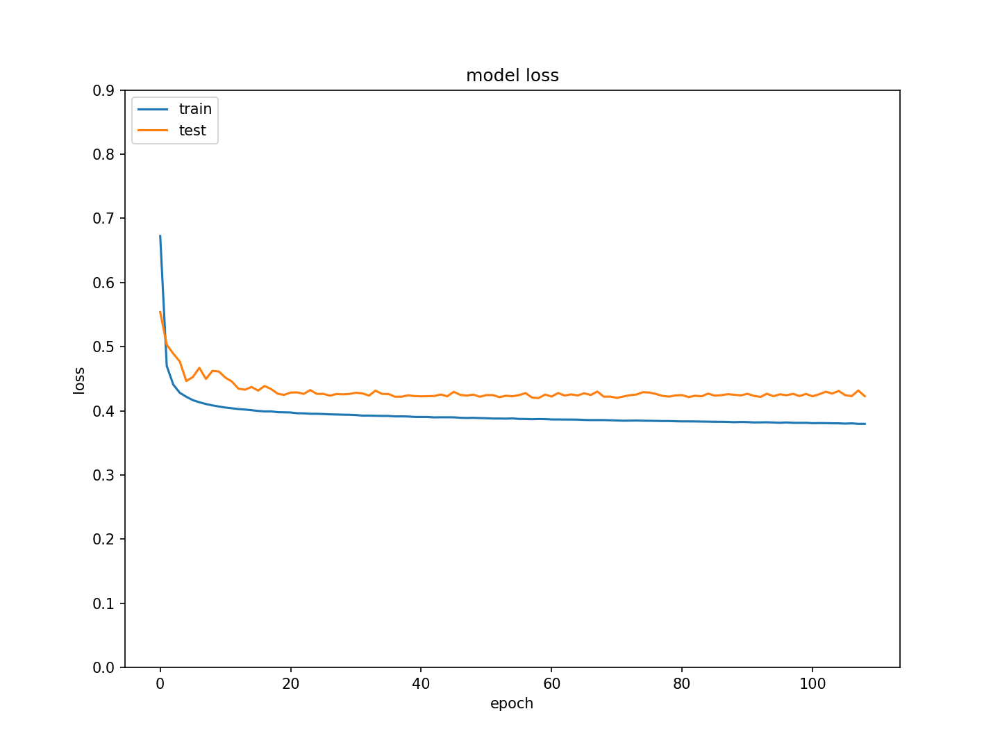

<IPython.core.display.Javascript object>


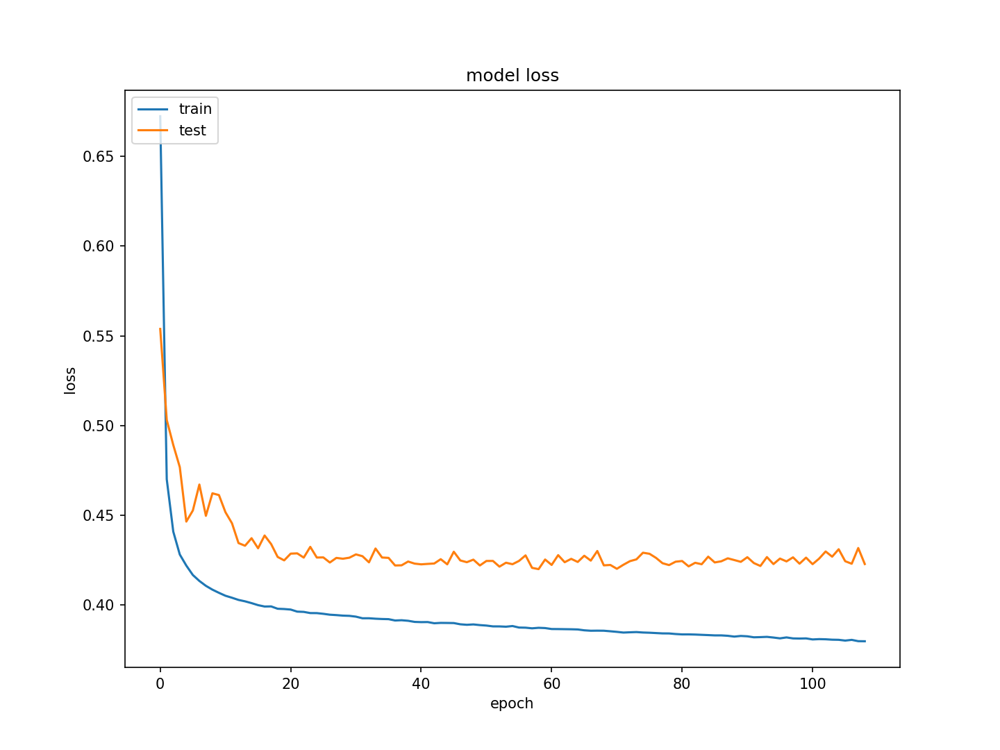

In [13]:
from tensorflow.keras.layers import Input
num_in = 33

input1 = Input(shape=(num_in))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(64, activation='relu')(model1)
#model1 = Dense(4, activation='relu')(model1)
model1 = Dense(19, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer=tf.keras.optimizers.Adam(
    learning_rate=0.001),metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ),
                    batch_size=8192*4,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = y_val_log.index)

model_3 = df_results

In [14]:
ch_energies = np.array([30000.0,20400.0,13900.0,9450.0,6460.0,4400.0,3000.0,2040.0,
                        1392.0,949.0,646.0,440.0,300.0,204.0,139.0,95.0,65.0,44.0,30.0])
ch_energies = np.flip((ch_energies[:]))
#need to fix this latter to add first channel back in
ELE_TOTAL_COUNTS = 10**(df_results.values[:,0])*(ch_energies[1]-ch_energies[0])
+ 10**(df_results.values[:,18])*(ch_energies[18]-ch_energies[17])
for i in range(1,18):
    ELE_TOTAL_COUNTS = ELE_TOTAL_COUNTS +     10**(df_results.values[:,i])*(ch_energies[i+1]-ch_energies[i-1])/2.
ELE_TOTAL_COUNTS= pd.DataFrame(data=np.log10(np.reshape(ELE_TOTAL_COUNTS,(ELE_TOTAL_COUNTS.shape[0])) ), index = df_val.index)
    
ELE_TOTAL_COUNTS_val = 10**(y_val_log.values[:,0])*(ch_energies[1]-ch_energies[0])
+ 10**(y_val_log.values[:,18])*(ch_energies[18]-ch_energies[17])
for i in range(1,18):
    ELE_TOTAL_COUNTS_val = ELE_TOTAL_COUNTS_val +     10**(y_val_log.values[:,i])*(ch_energies[i+1]-ch_energies[i-1])/2.
    
temp = y_val_log
y_val_log = pd.DataFrame(data=np.log10(np.reshape(ELE_TOTAL_COUNTS_val,(ELE_TOTAL_COUNTS_val.shape[0]) )), index = df_val.index)

df_results = ELE_TOTAL_COUNTS

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


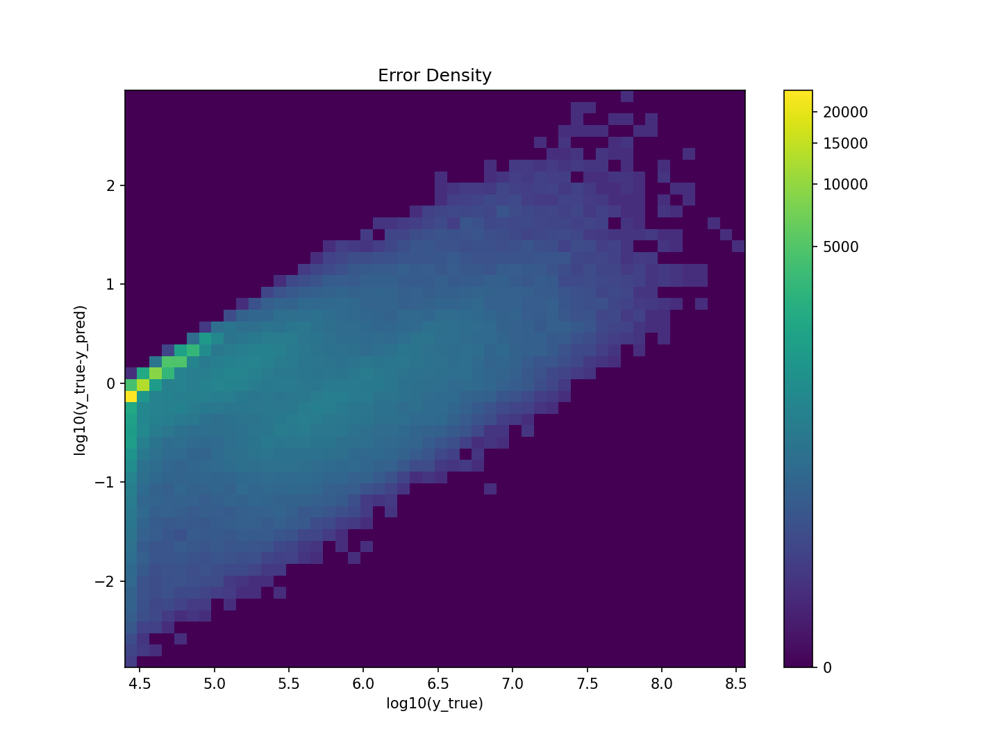

In [15]:
import matplotlib.colors as mcolors
gamma = 0.2#[0.8, 0.5, 0.3]
errors= y_val_log.values-df_results.values
print(y_val_log.values.shape, errors.shape)

plt.figure();
plt.hist2d(y_val_log.values[:,0], errors[:,0],
              bins=50, norm=mcolors.PowerNorm(gamma))
plt.colorbar()
plt.title('Error Density')
plt.xlabel('log10(y_true)')
plt.ylabel('log10(y_true-y_pred)')

plt.show()

<IPython.core.display.Javascript object>


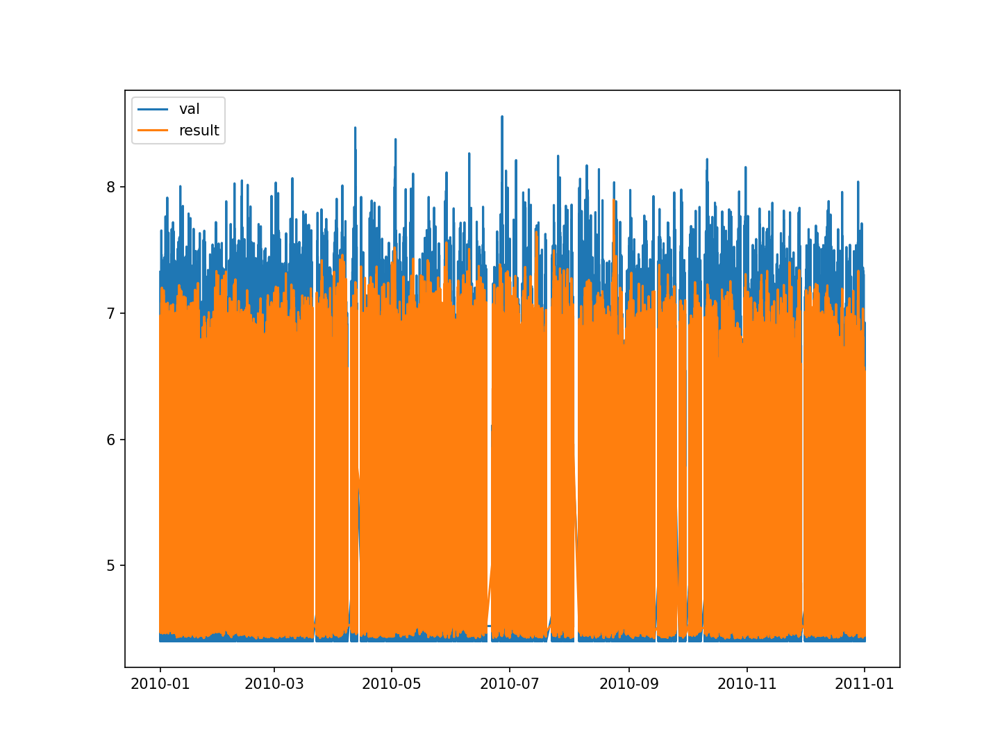

<IPython.core.display.Javascript object>


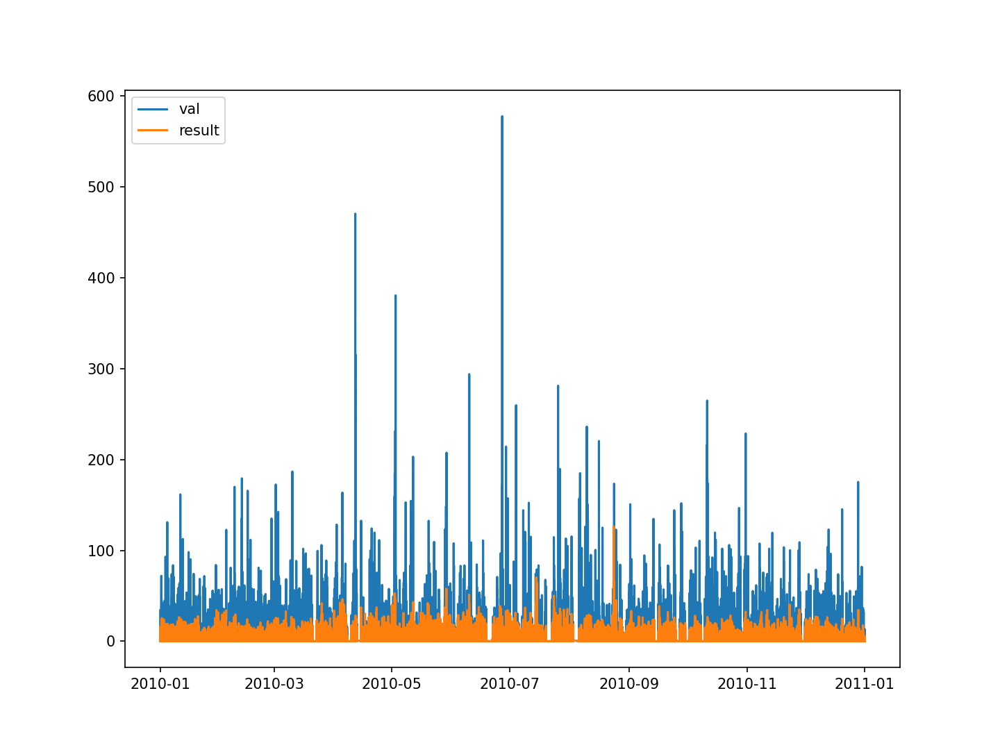

<IPython.core.display.Javascript object>


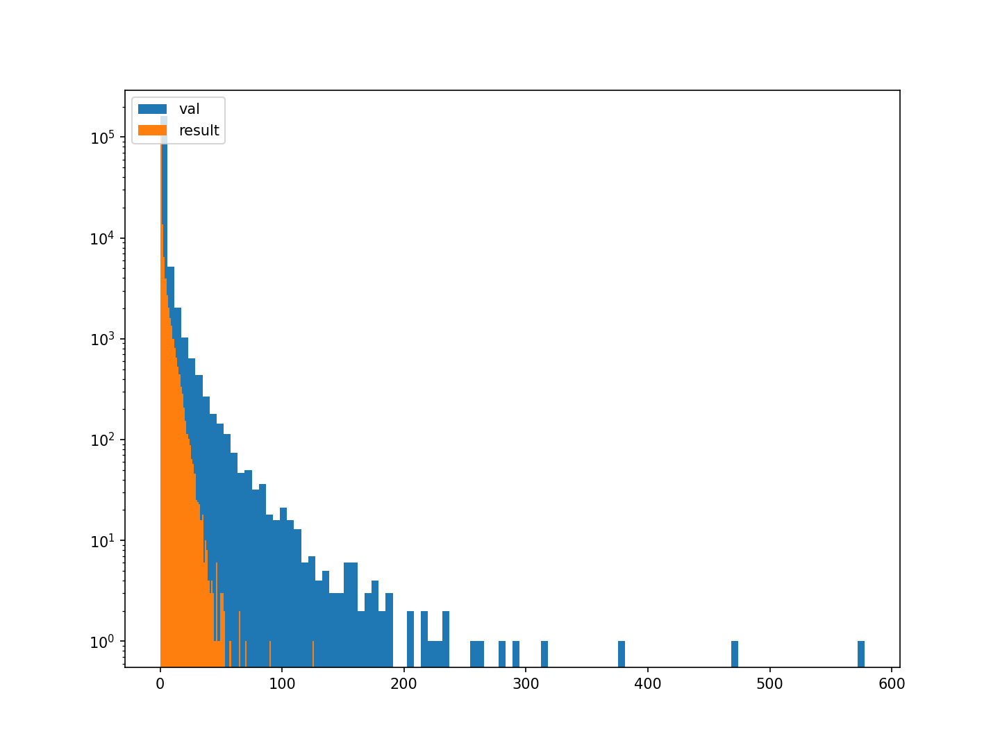

<IPython.core.display.Javascript object>


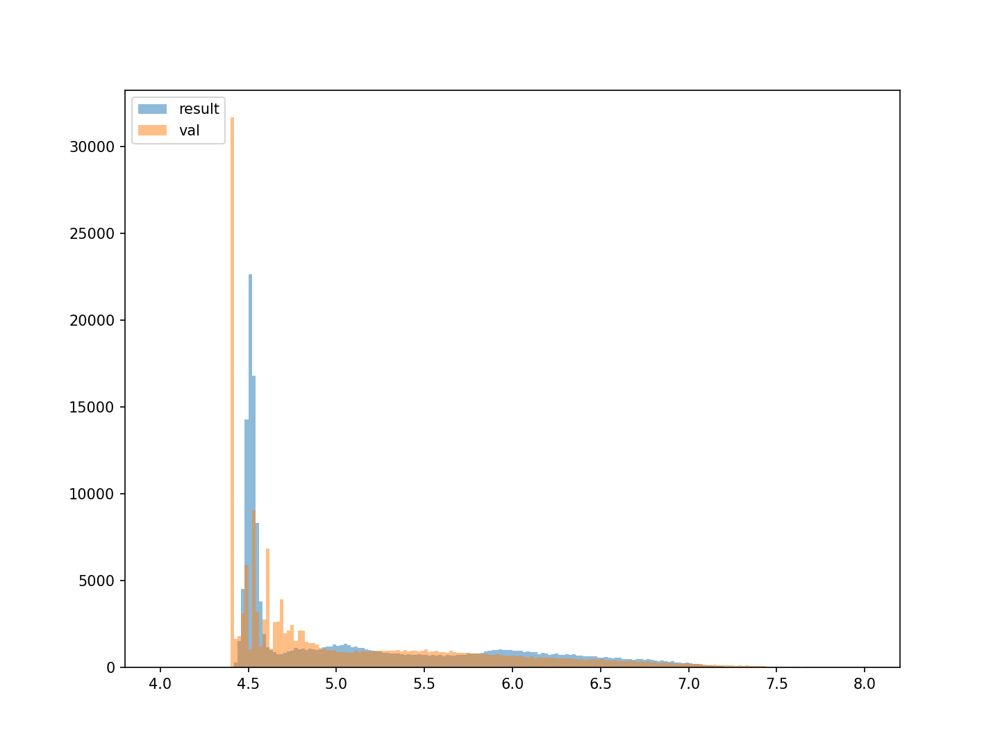

<IPython.core.display.Javascript object>


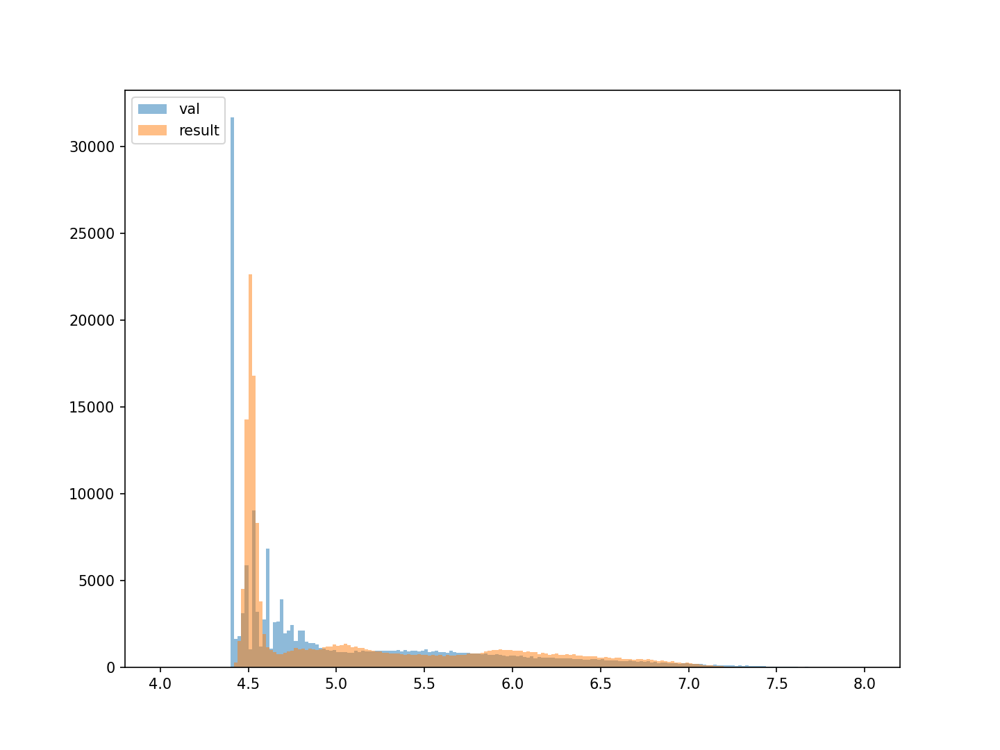

<IPython.core.display.Javascript object>


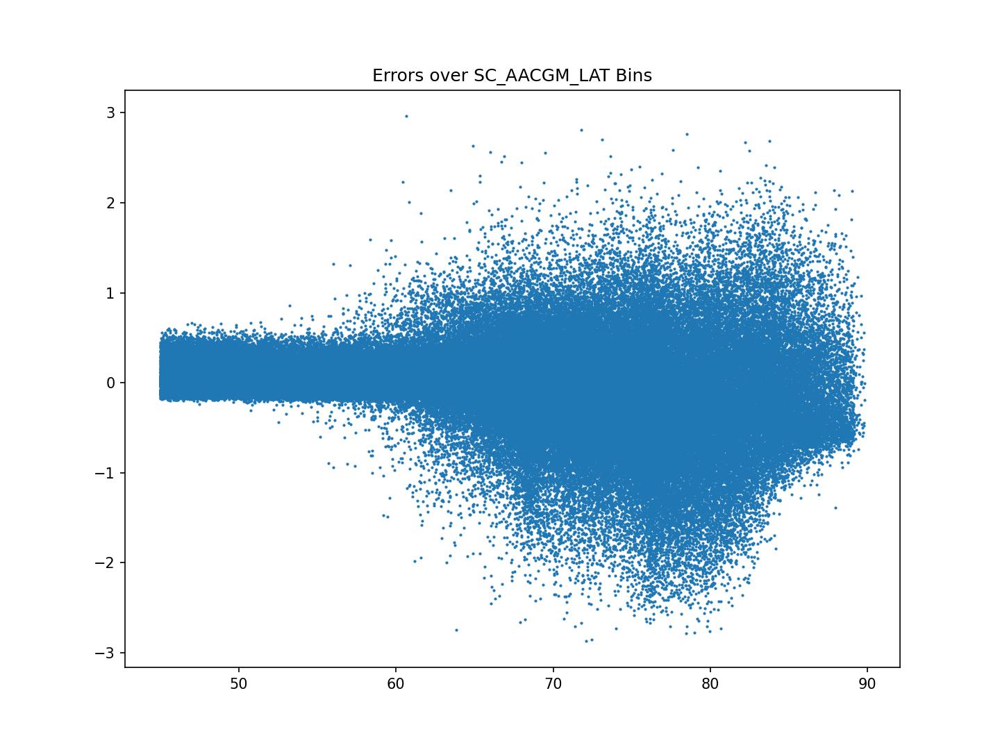

<IPython.core.display.Javascript object>


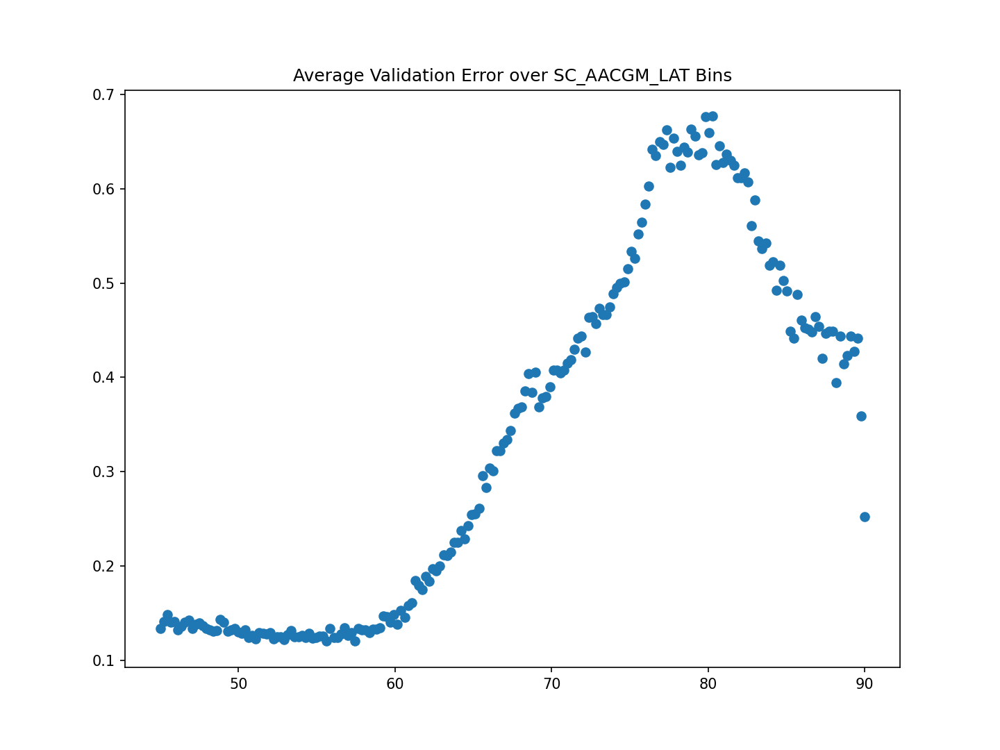

<IPython.core.display.Javascript object>


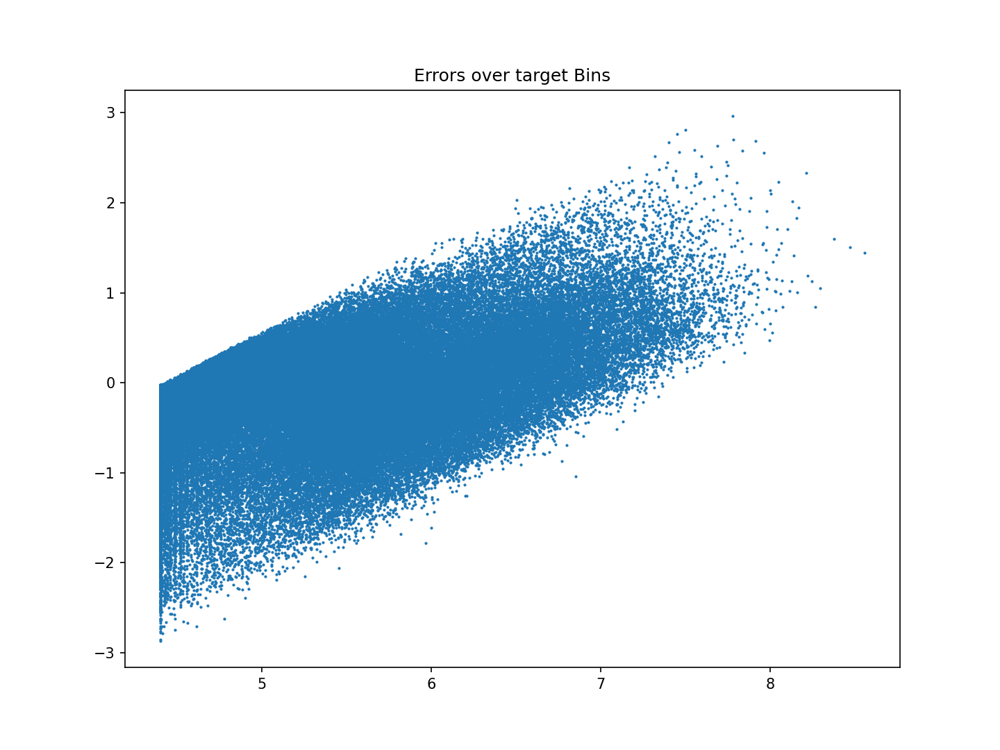

<IPython.core.display.Javascript object>


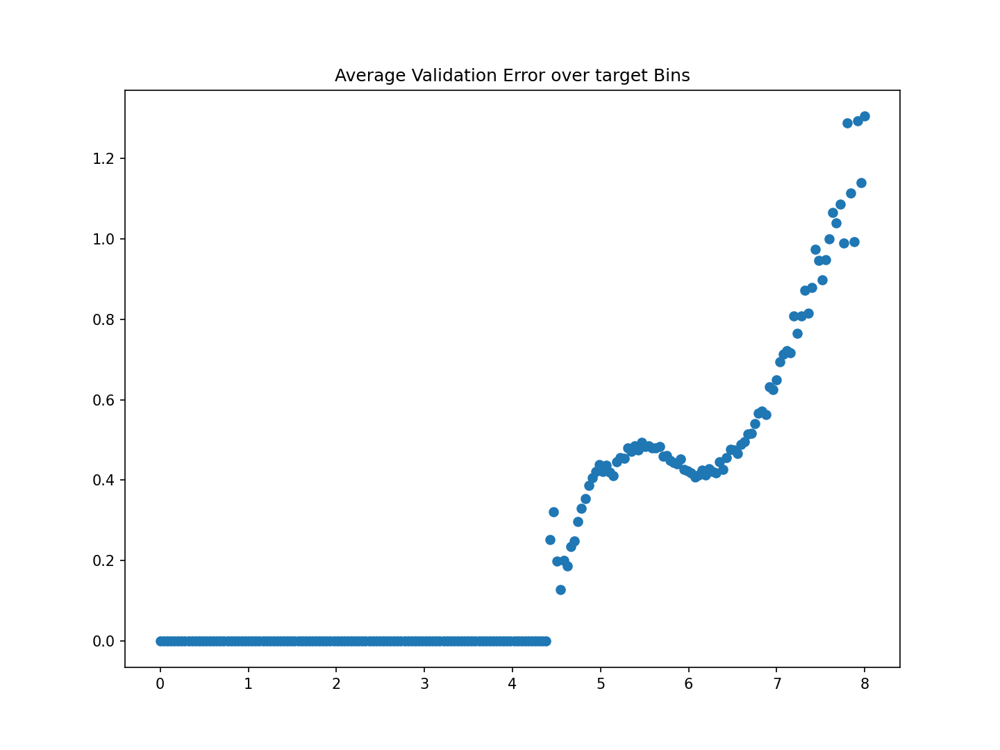

In [16]:
import matplotlib.colors as mcolors
gamma = 0.2#[0.8, 0.5, 0.3]
errors= y_val_log.values-df_results.values
print(y_val_log.values.shape, errors.shape)

plt.figure();
plt.hist2d(y_val_log.values[:,0], errors[:,0],
              bins=50, norm=mcolors.PowerNorm(gamma))
plt.colorbar()
plt.title('Error Density')
plt.xlabel('log10(y_true)')
plt.ylabel('log10(y_true-y_pred)')

plt.show()

plt.figure()
plt.plot(y_val_log[:])
plt.plot(df_results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()


plt.figure()
plt.plot(10**y_val_log[:]*1.6e-6)
plt.plot(10**df_results[:]*1.6e-6)
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure()
plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
plt.legend(['val', 'result'], loc='upper left')
plt.show()


minr = 4 #np.min(y_val_log.values)
maxr = 8 #np.max(y_val_log.values)
plt.figure()
plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
plt.legend(['result','val'], loc='upper left')
plt.show()

plt.figure()
plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
plt.legend(['val', 'result'], loc='upper left')
plt.show()

errors= y_val_log.values-df_results.values
plt.figure();
plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1)
plt.title('Errors over SC_AACGM_LAT Bins')


import math
bin_total = np.zeros((200))
bin_error_total = np.zeros((200))
for j in range(0,y_val_log.values.shape[0]):
    i = ((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/200))
    if not (math.isnan(i)):
        i = int(i)
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

avg_error_over_hist = bin_error_total/bin_total
plt.figure()
plt.scatter(np.linspace(45,90,num=200),avg_error_over_hist)
plt.title('Average Validation Error over SC_AACGM_LAT Bins')
plt.show()

errors= y_val_log.values-df_results.values
plt.figure();
plt.scatter(y_val_log.values,errors,s=1)
plt.title('Errors over target Bins')

bin_total = np.zeros((200))
bin_error_total = np.zeros((200))
for j in range(0,y_val_log.values.shape[0]):
    i = ((y_val_log.values[j]-0)/((8-0)/200))
    if not (math.isnan(i)):
        i = int(i)
        if (i < 200) and(i > 0):
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

avg_error_over_hist = bin_error_total/(bin_total+.00001)
plt.figure()
plt.scatter(np.linspace(0,8,num=200),avg_error_over_hist)
plt.title('Average Validation Error over target Bins')    
plt.show()

y_val_log = temp

0


<IPython.core.display.Javascript object>


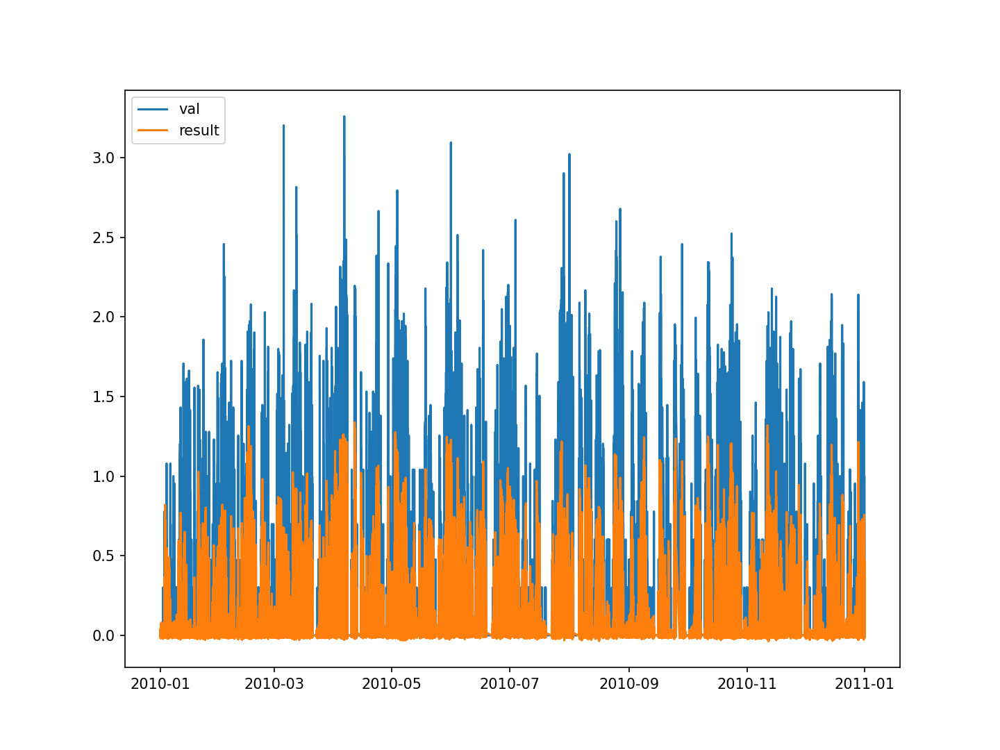

<IPython.core.display.Javascript object>


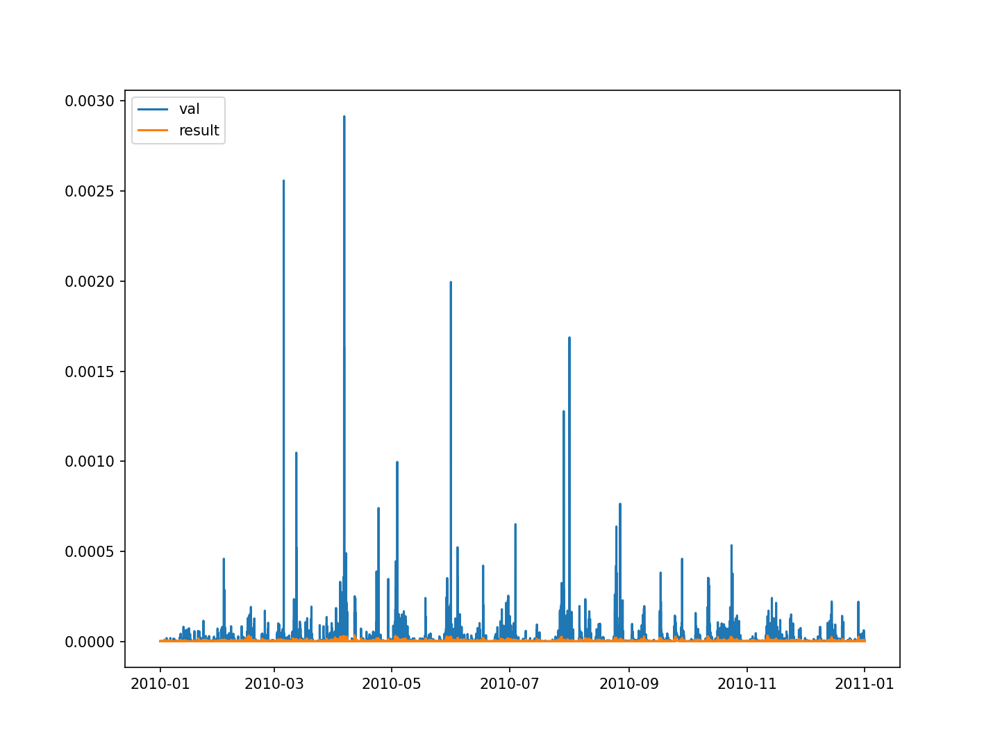

<IPython.core.display.Javascript object>


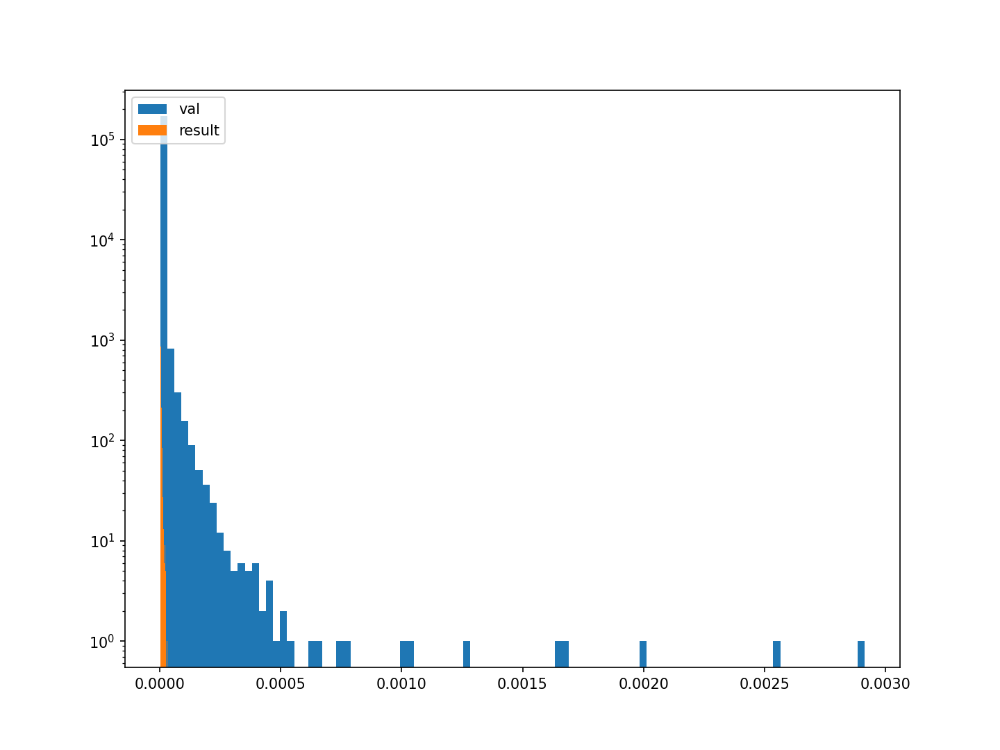

<IPython.core.display.Javascript object>


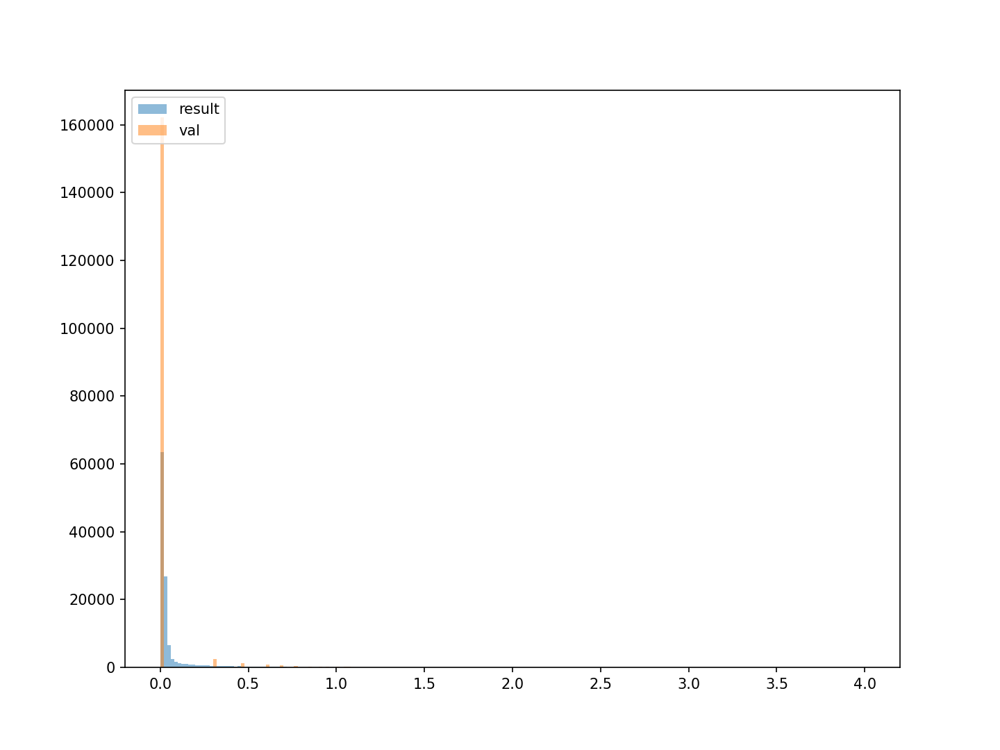

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


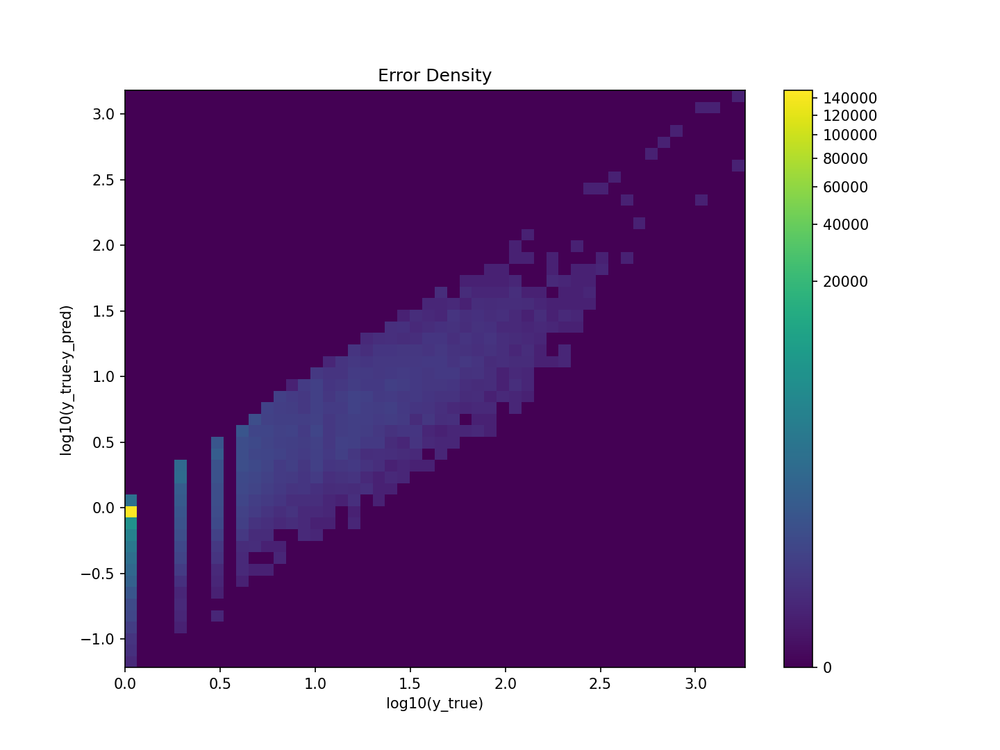

1


<IPython.core.display.Javascript object>


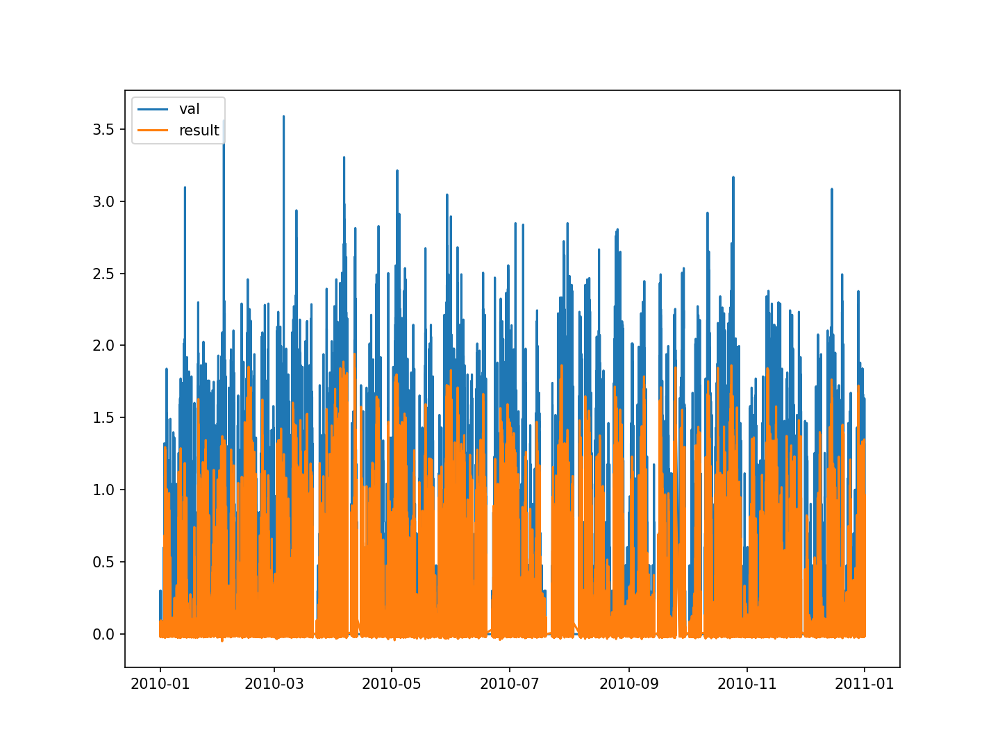

<IPython.core.display.Javascript object>


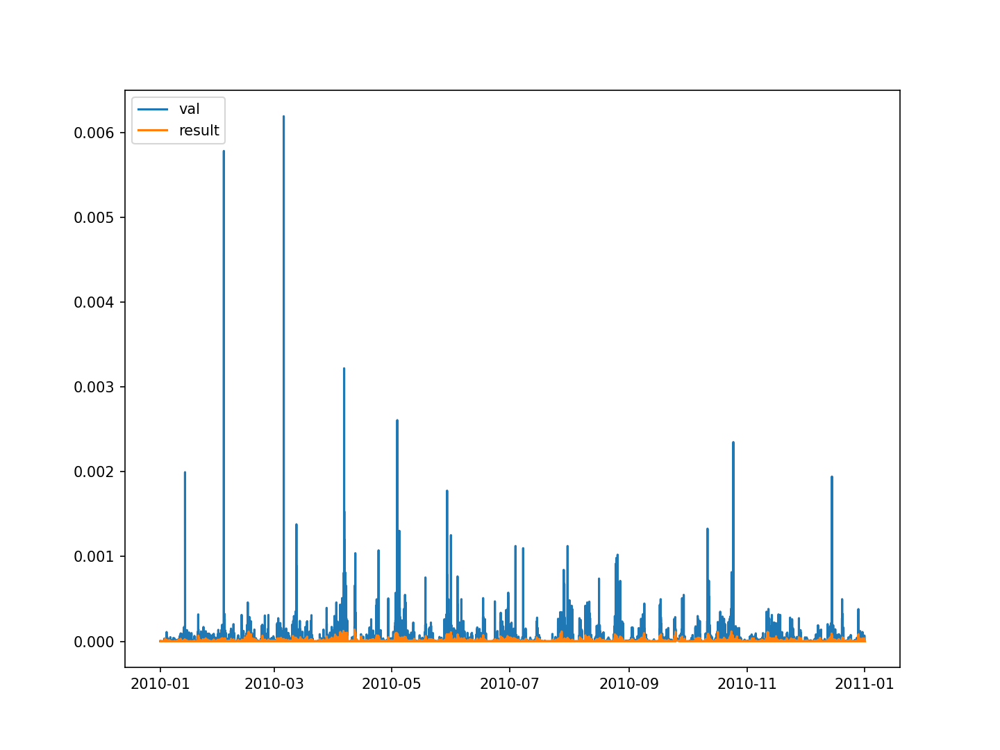

<IPython.core.display.Javascript object>


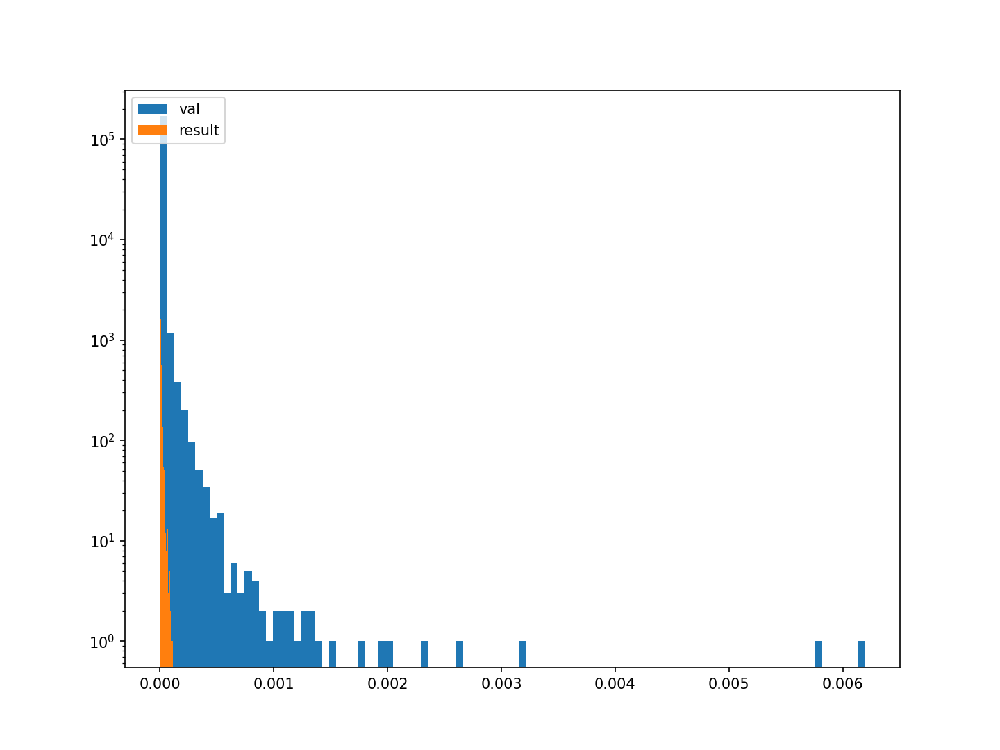

<IPython.core.display.Javascript object>


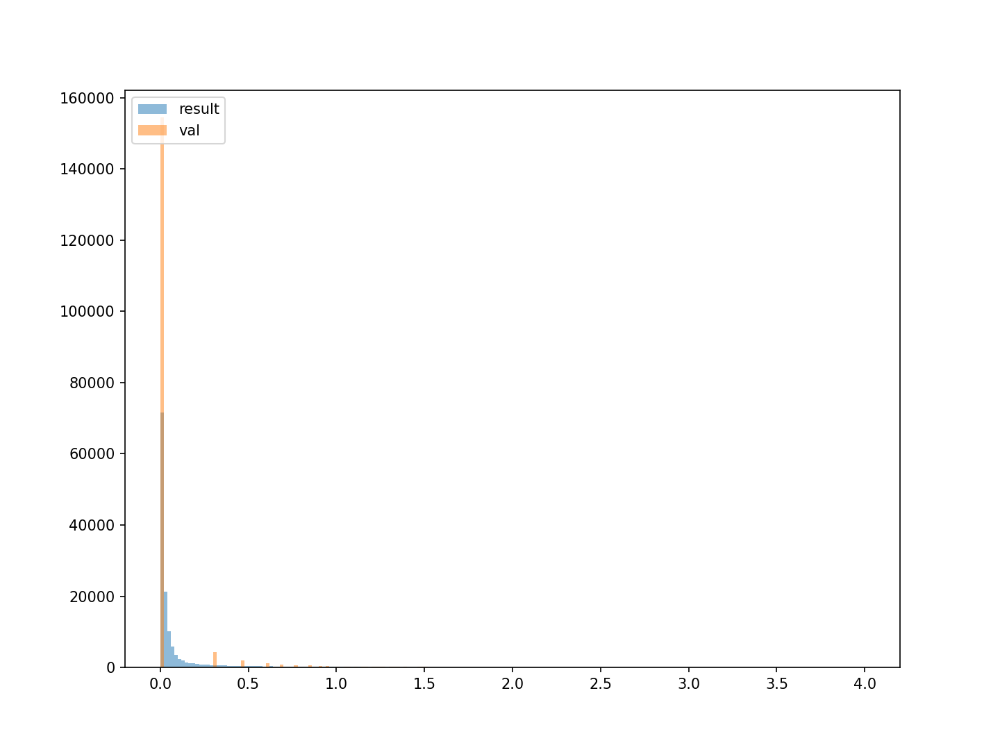

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


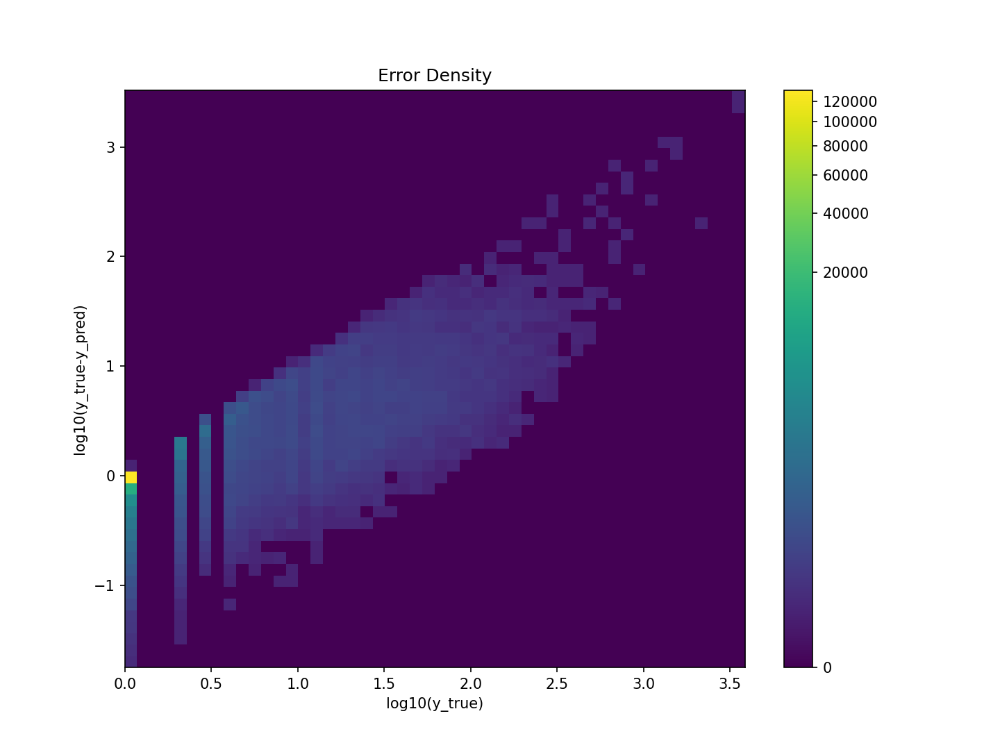

2


<IPython.core.display.Javascript object>


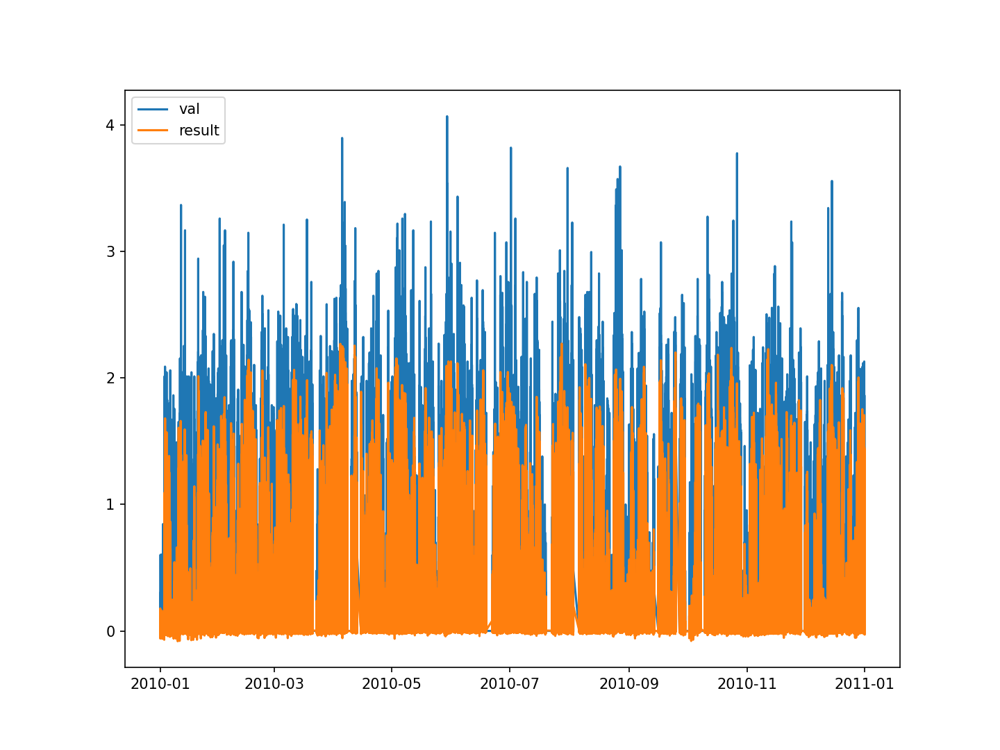

<IPython.core.display.Javascript object>


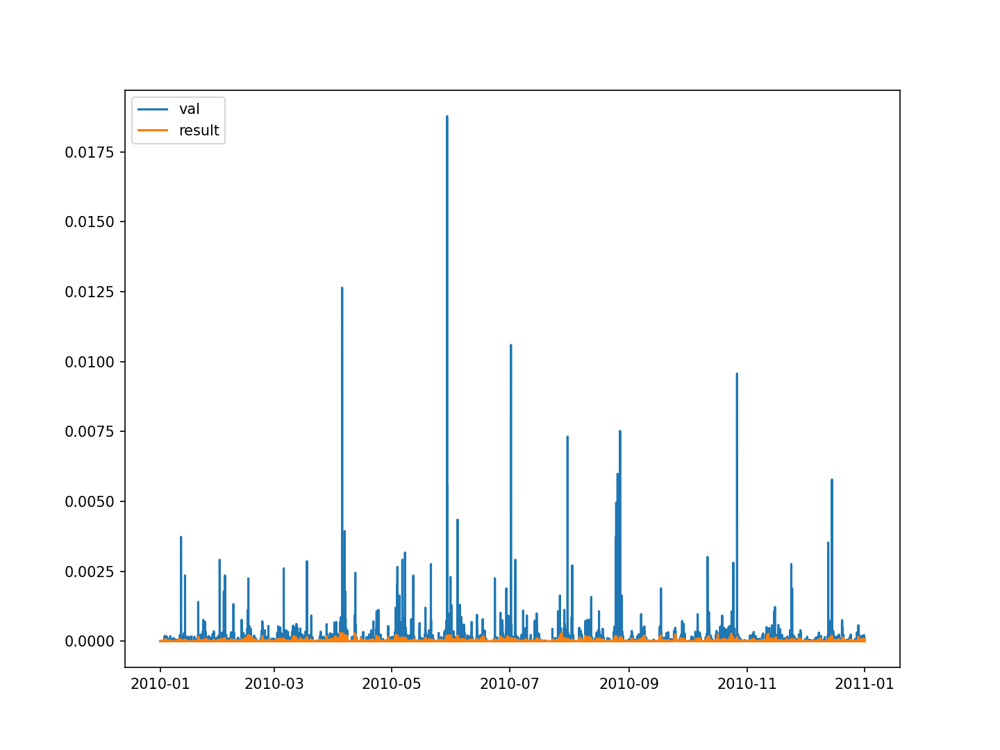

<IPython.core.display.Javascript object>


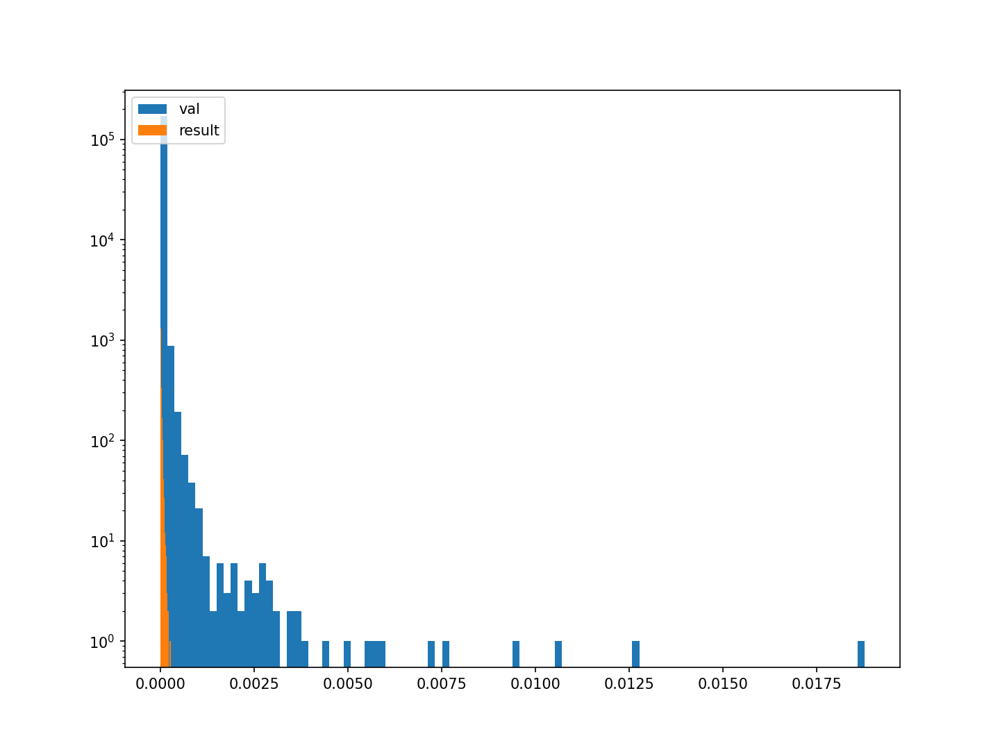

<IPython.core.display.Javascript object>


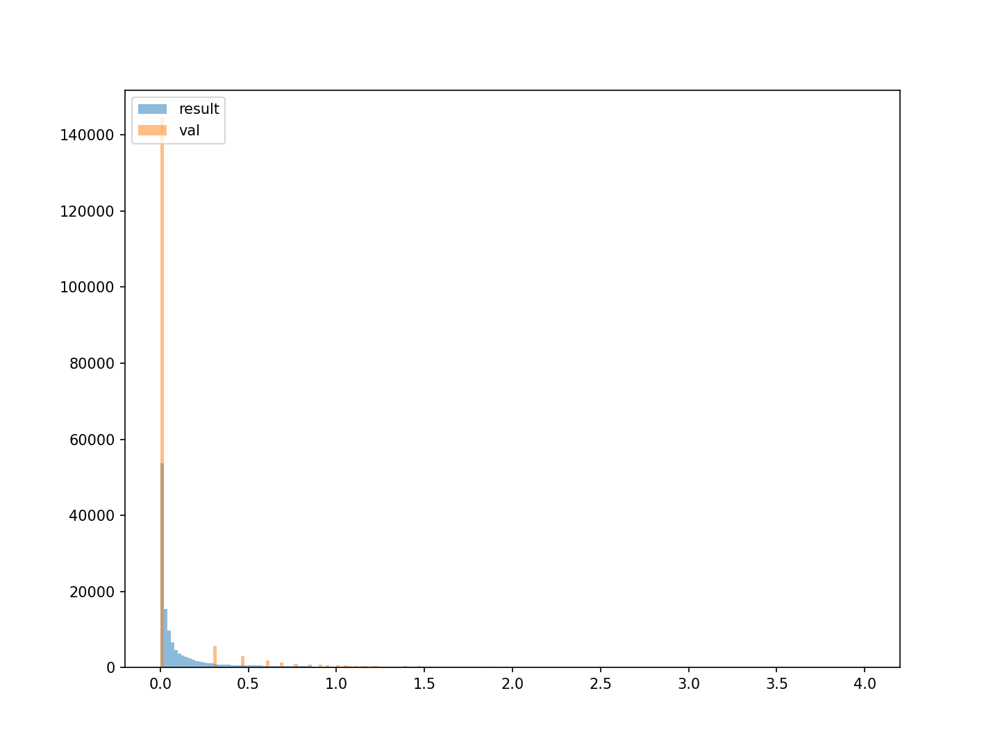

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


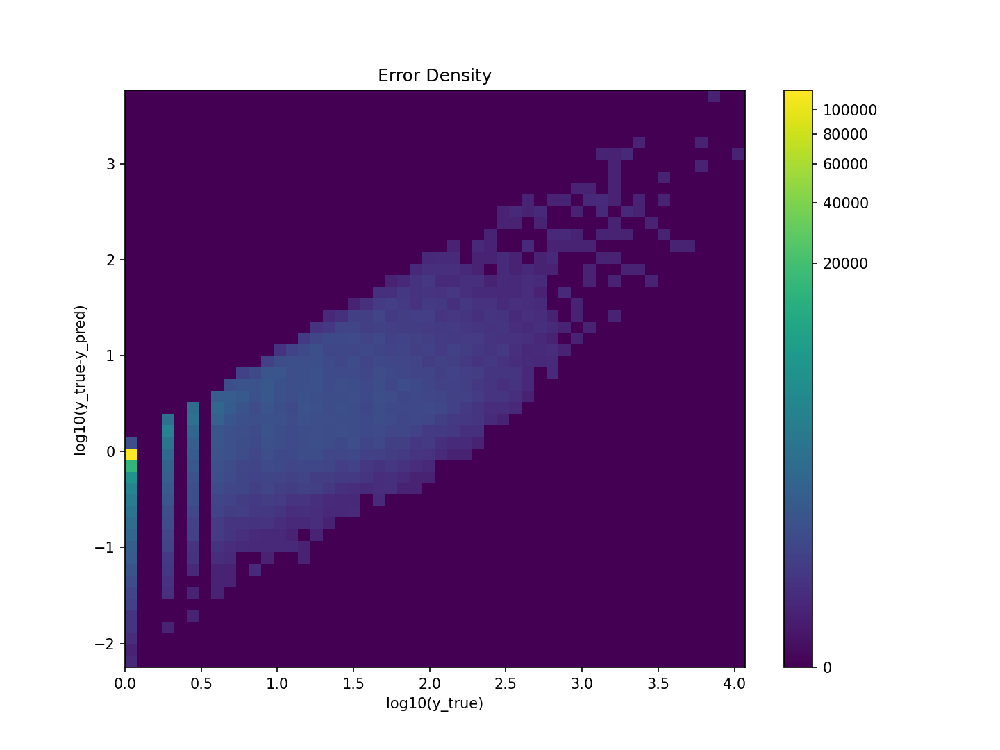

3


<IPython.core.display.Javascript object>


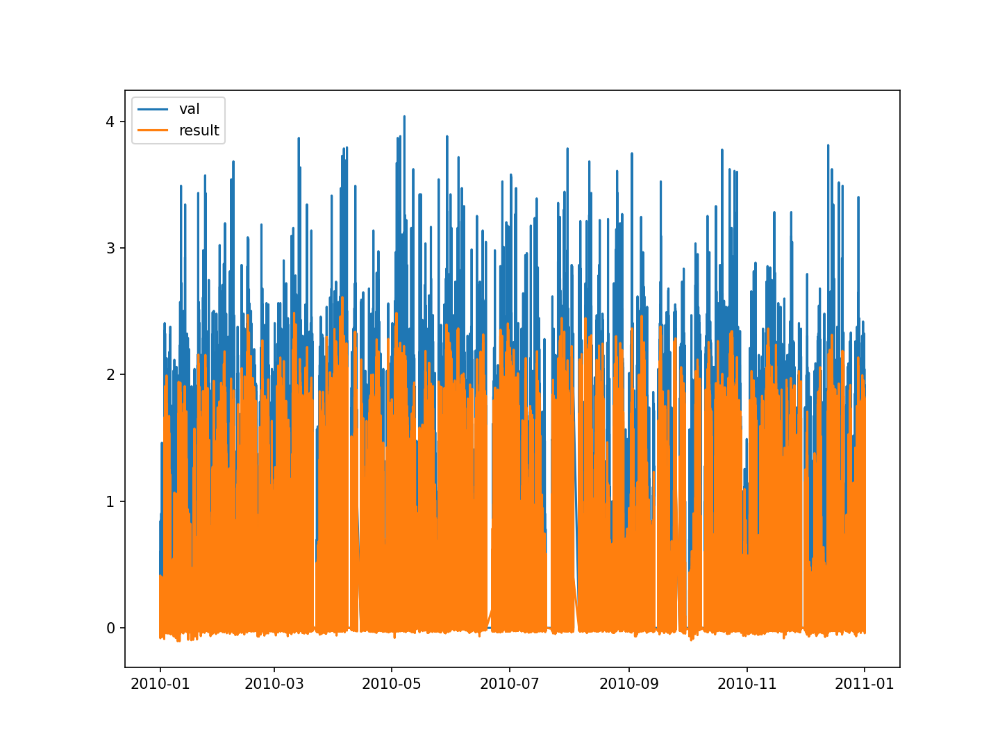

<IPython.core.display.Javascript object>


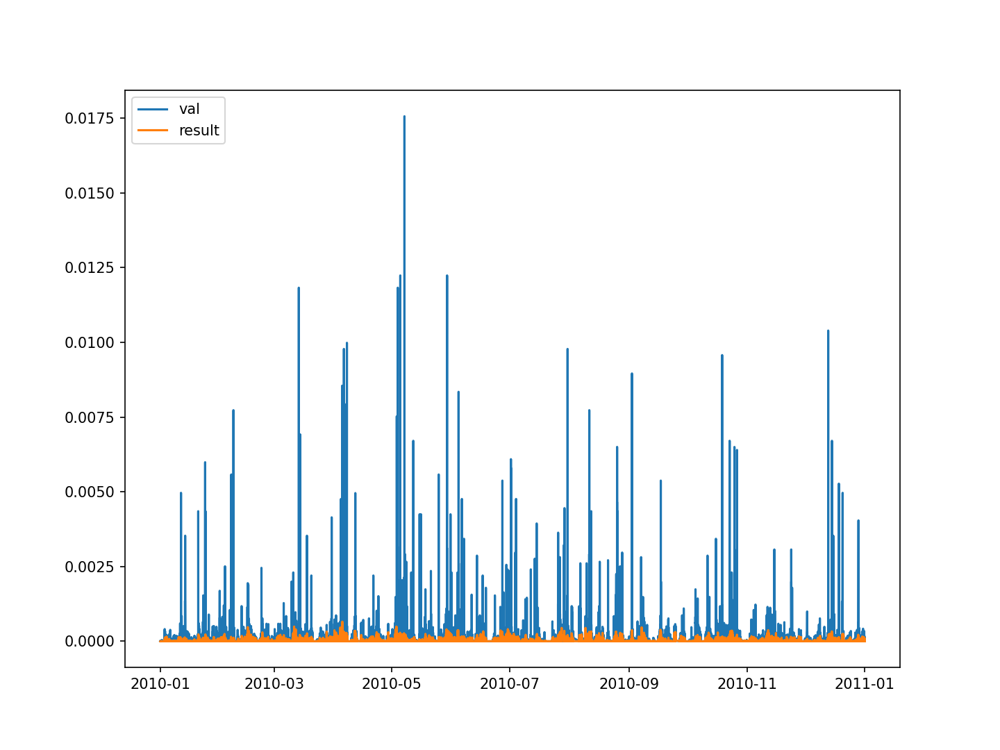

<IPython.core.display.Javascript object>


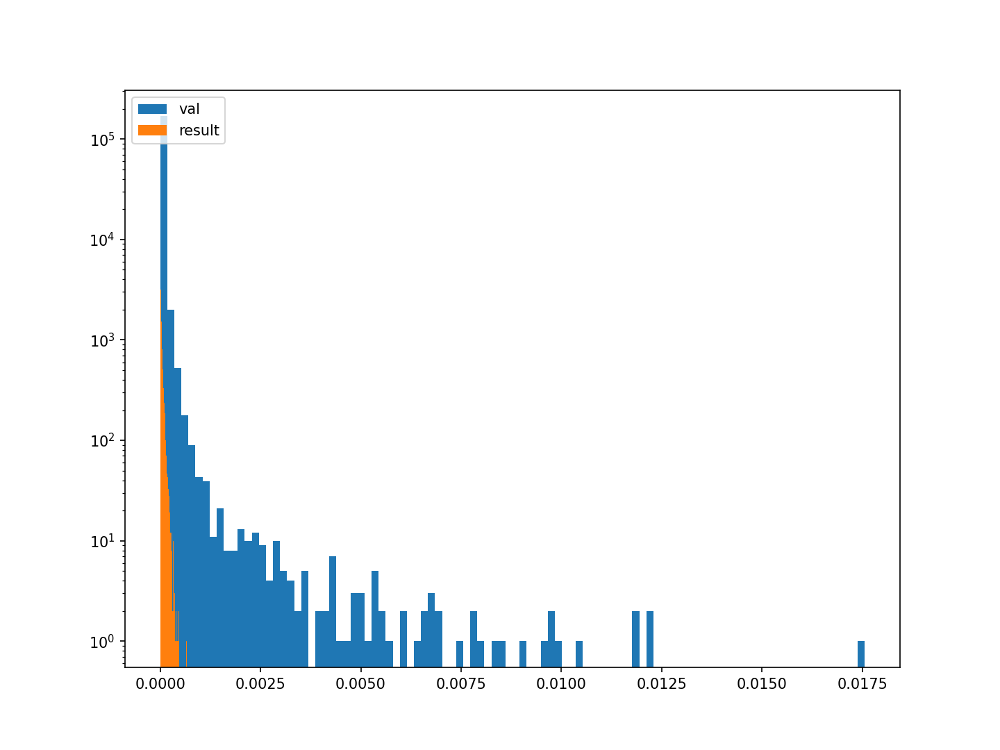

<IPython.core.display.Javascript object>


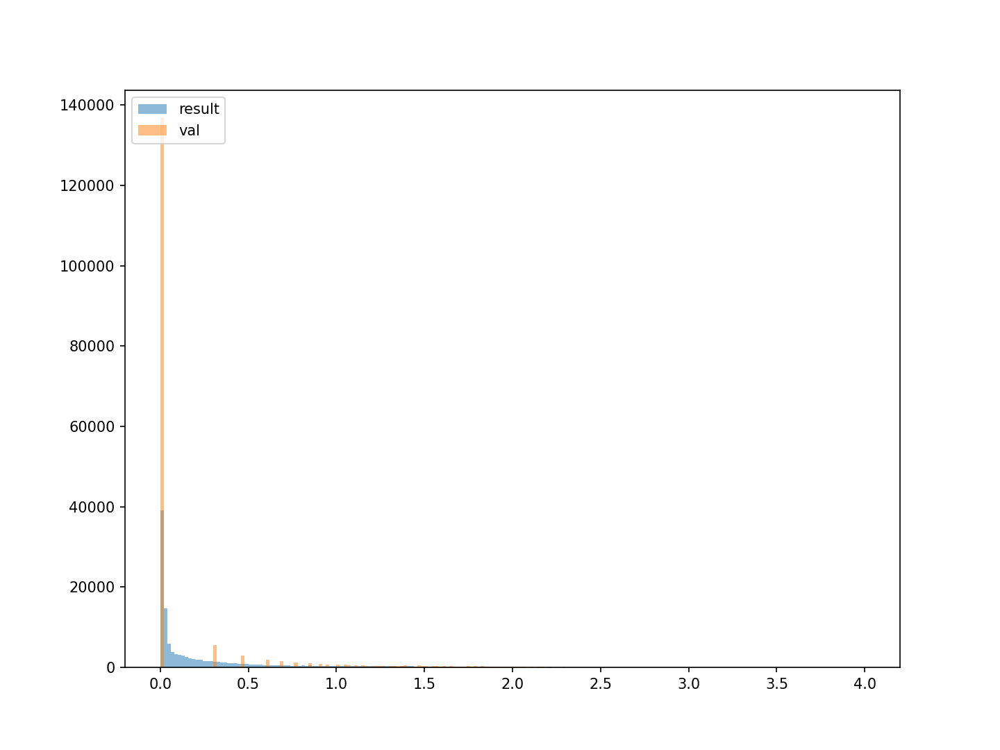

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


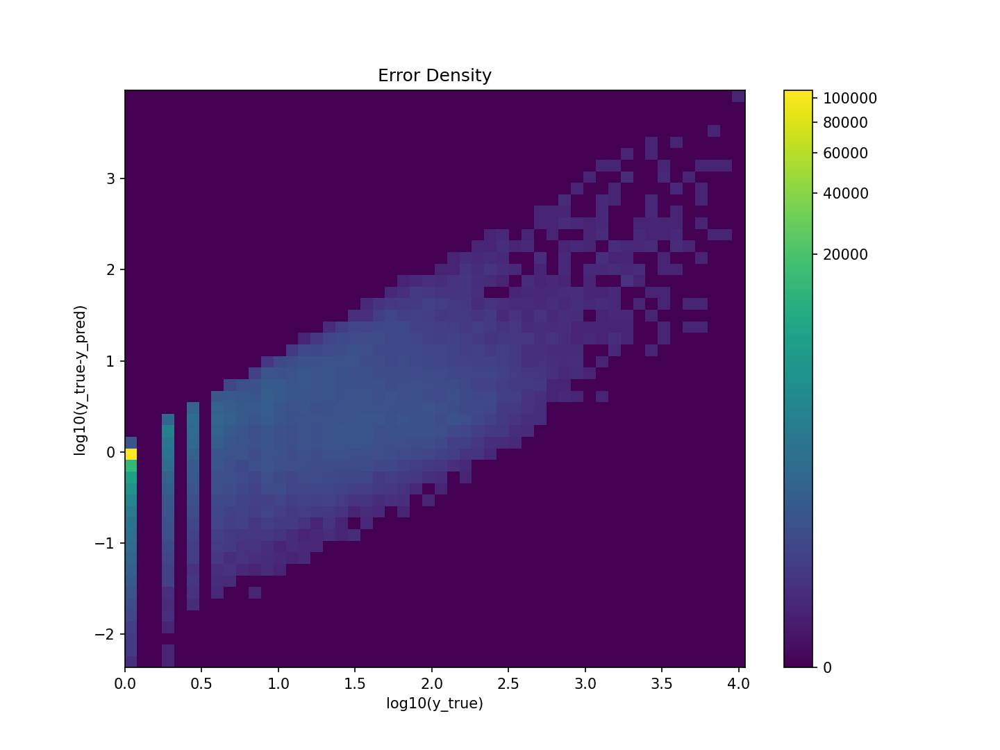

4


<IPython.core.display.Javascript object>


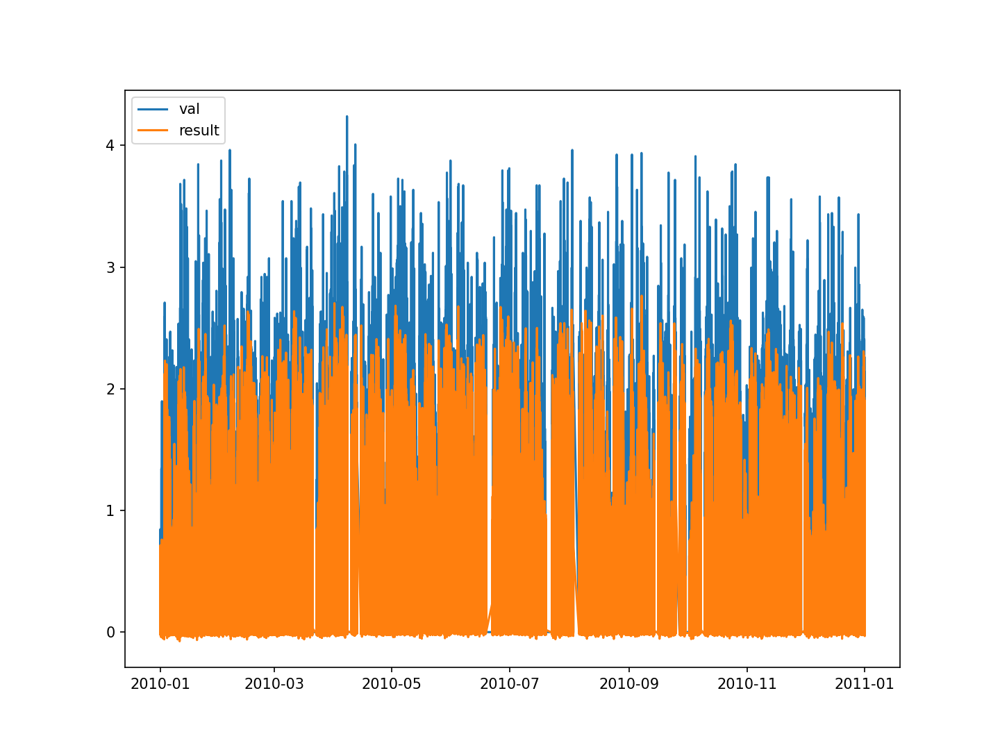

<IPython.core.display.Javascript object>


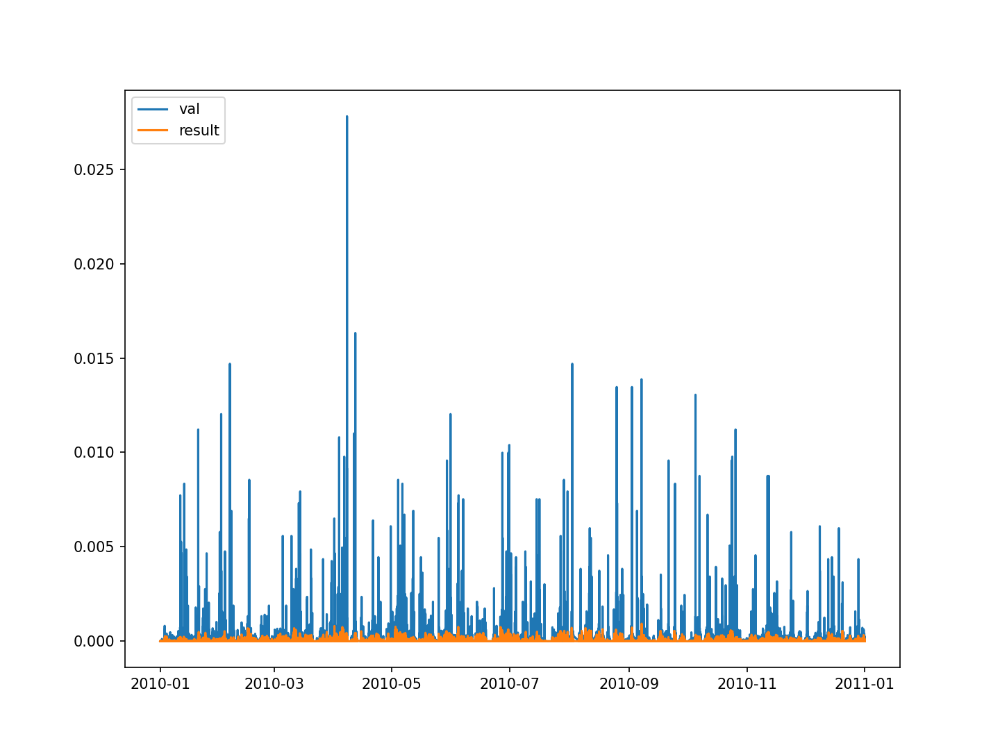

<IPython.core.display.Javascript object>


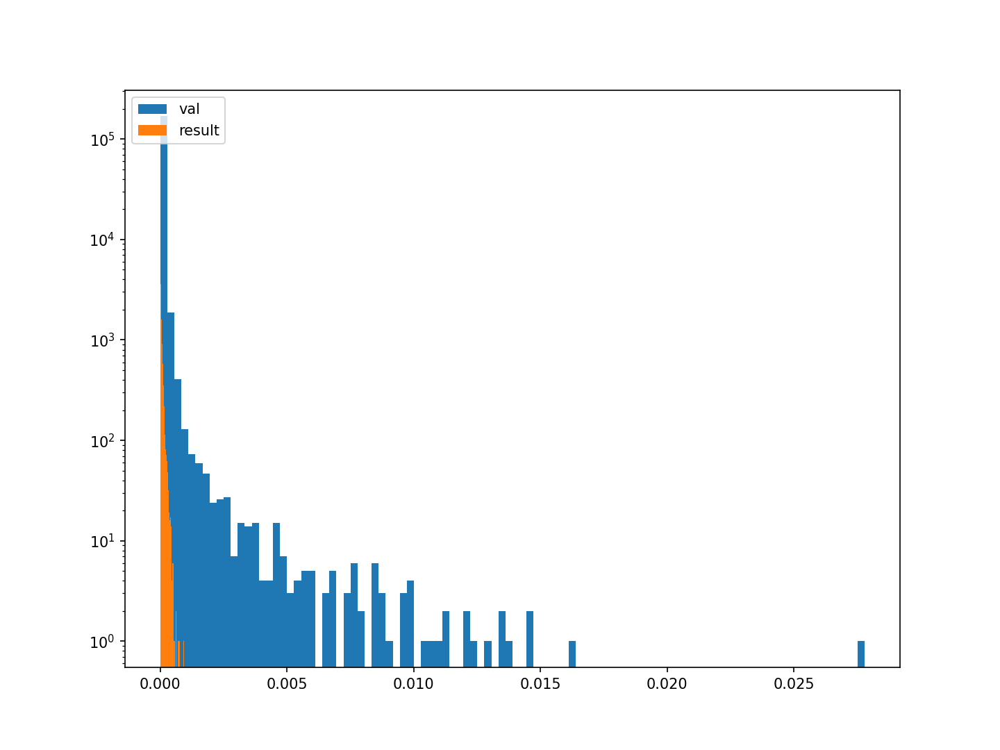

<IPython.core.display.Javascript object>


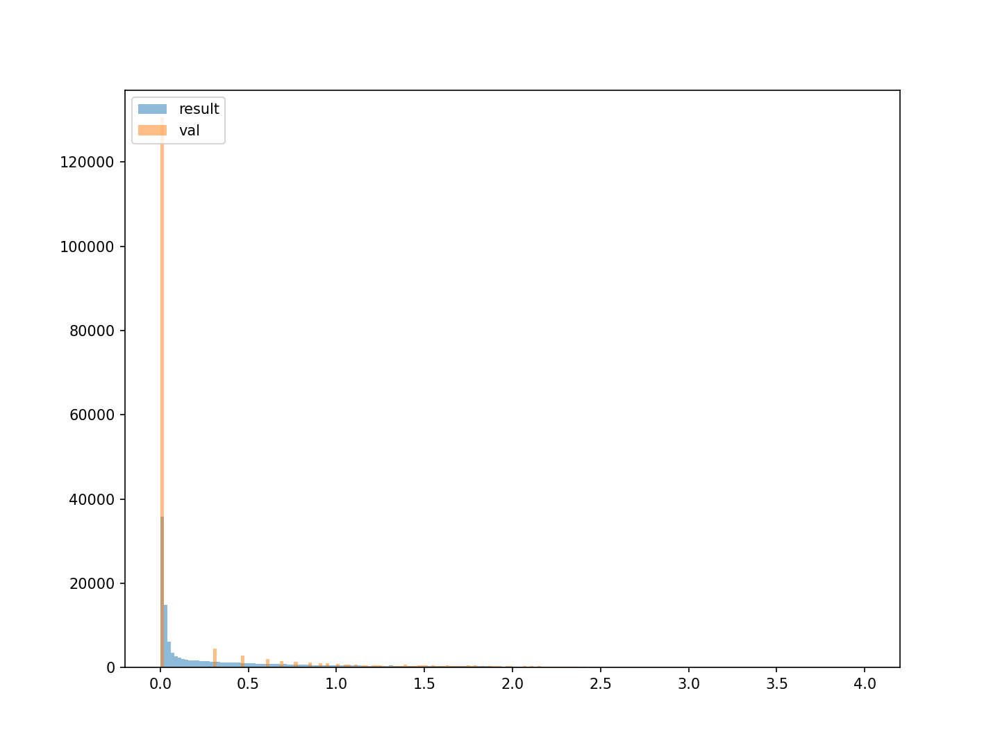

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


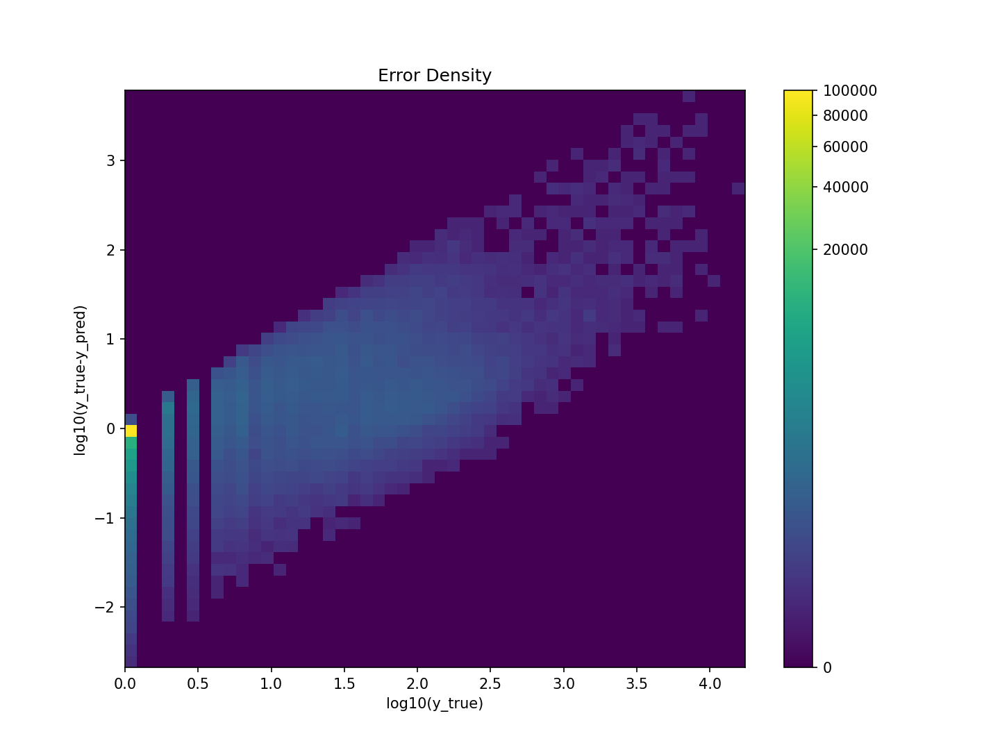

5


<IPython.core.display.Javascript object>


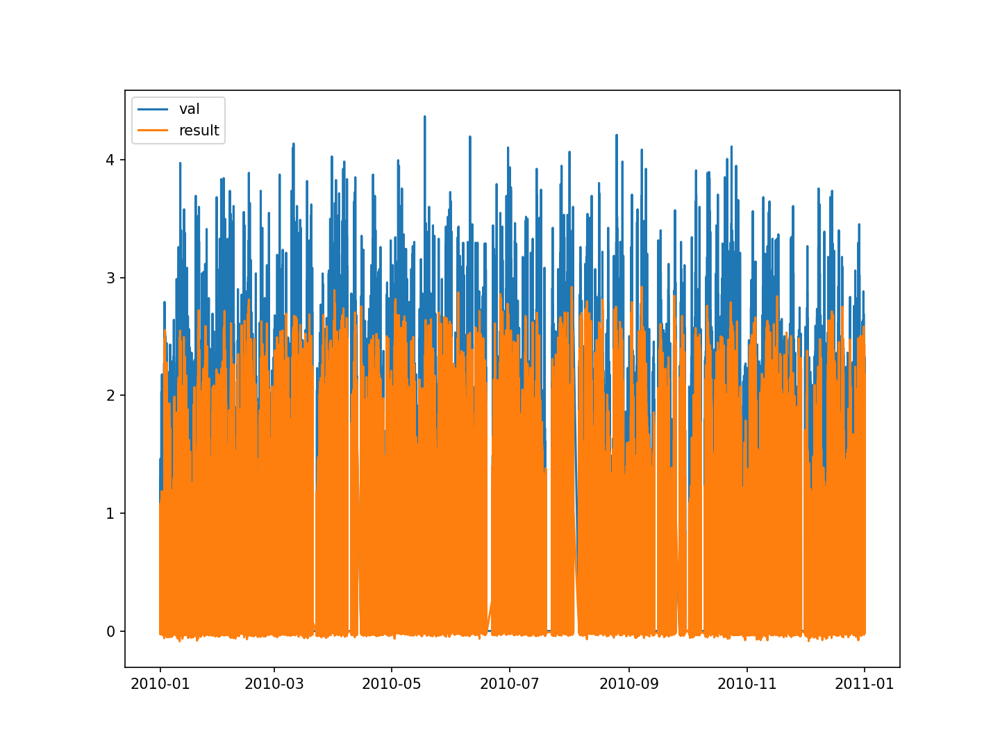

<IPython.core.display.Javascript object>


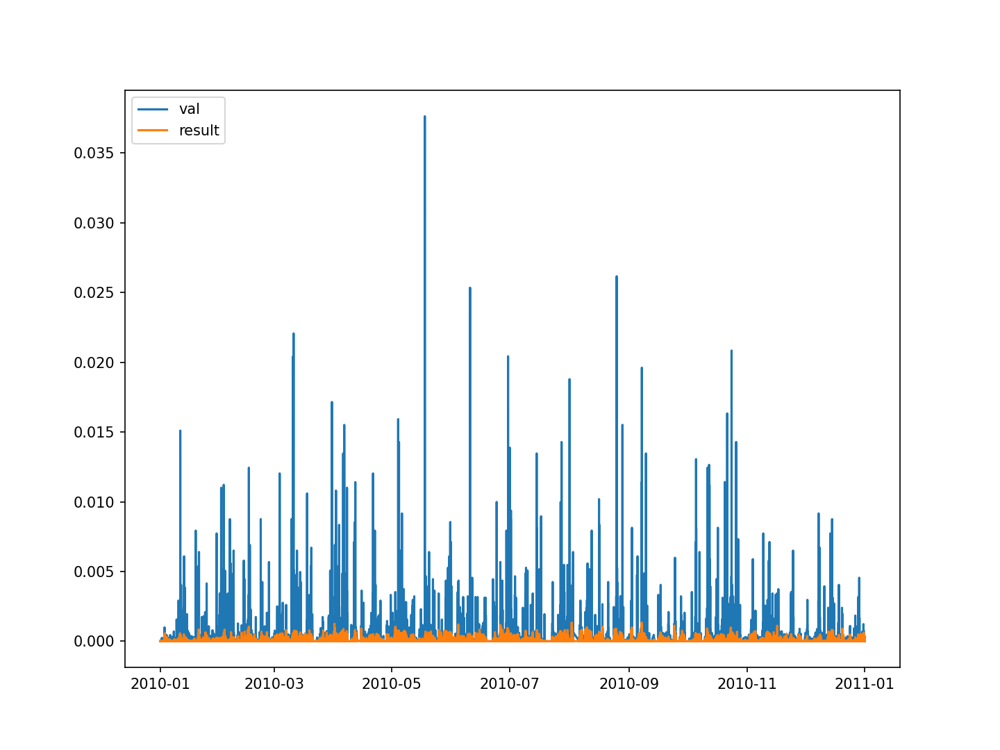

<IPython.core.display.Javascript object>


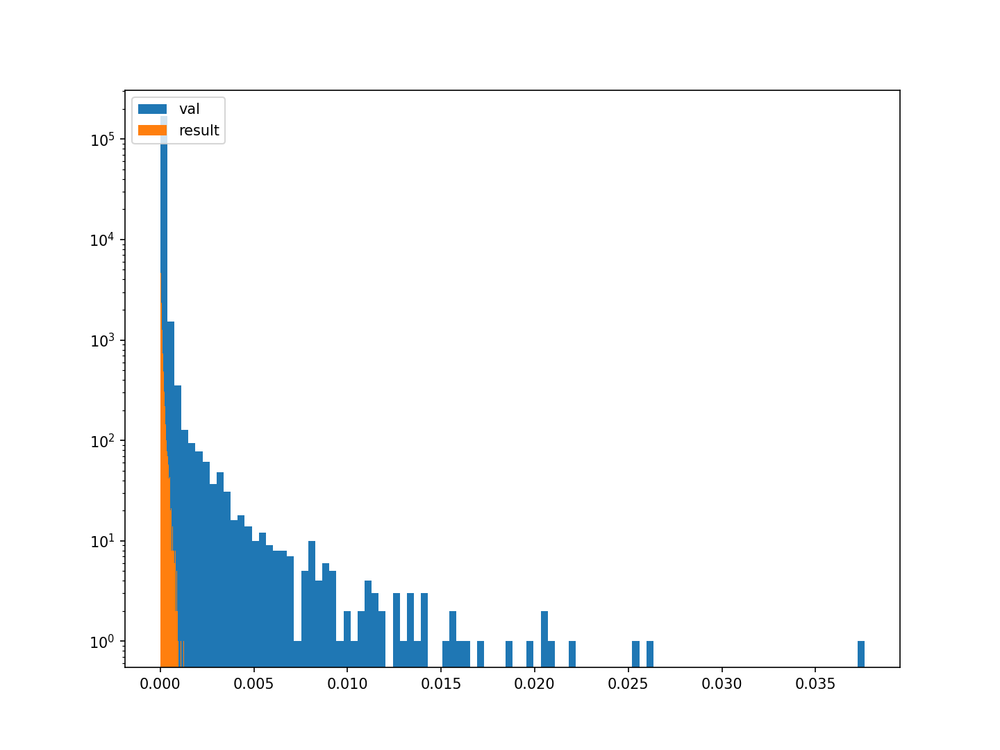

<IPython.core.display.Javascript object>


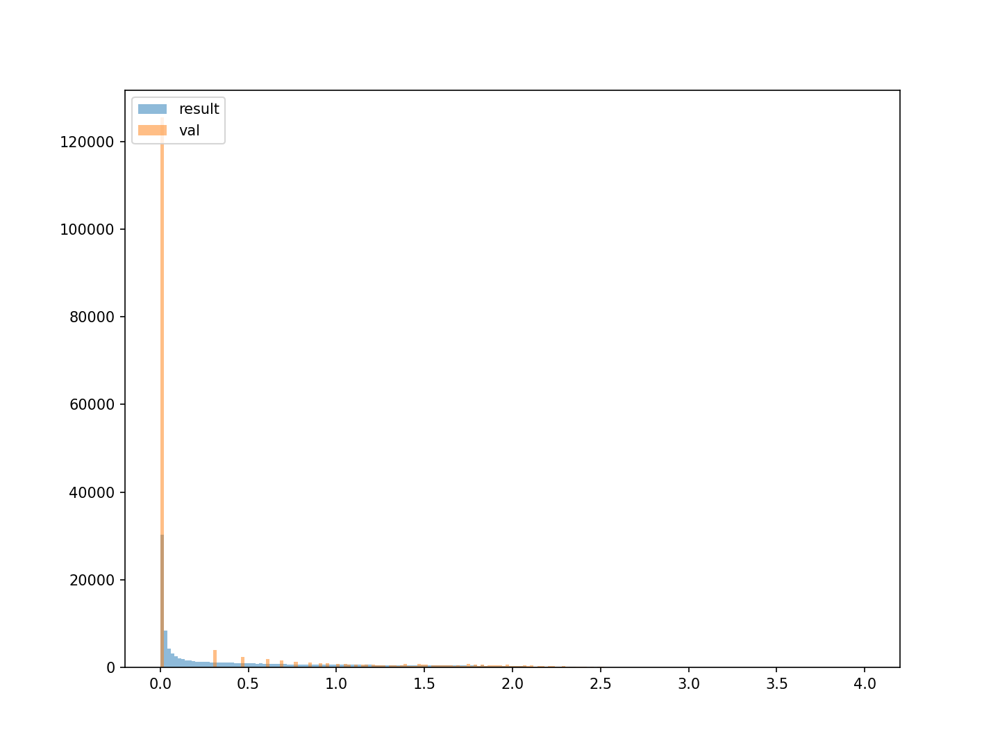

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


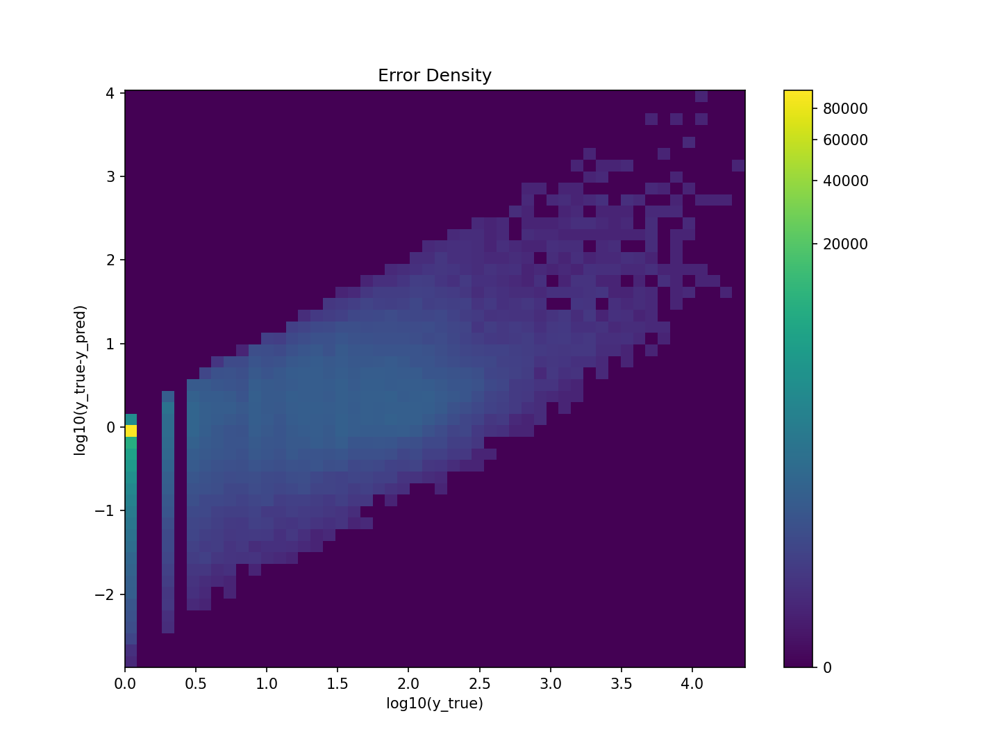

6


<IPython.core.display.Javascript object>


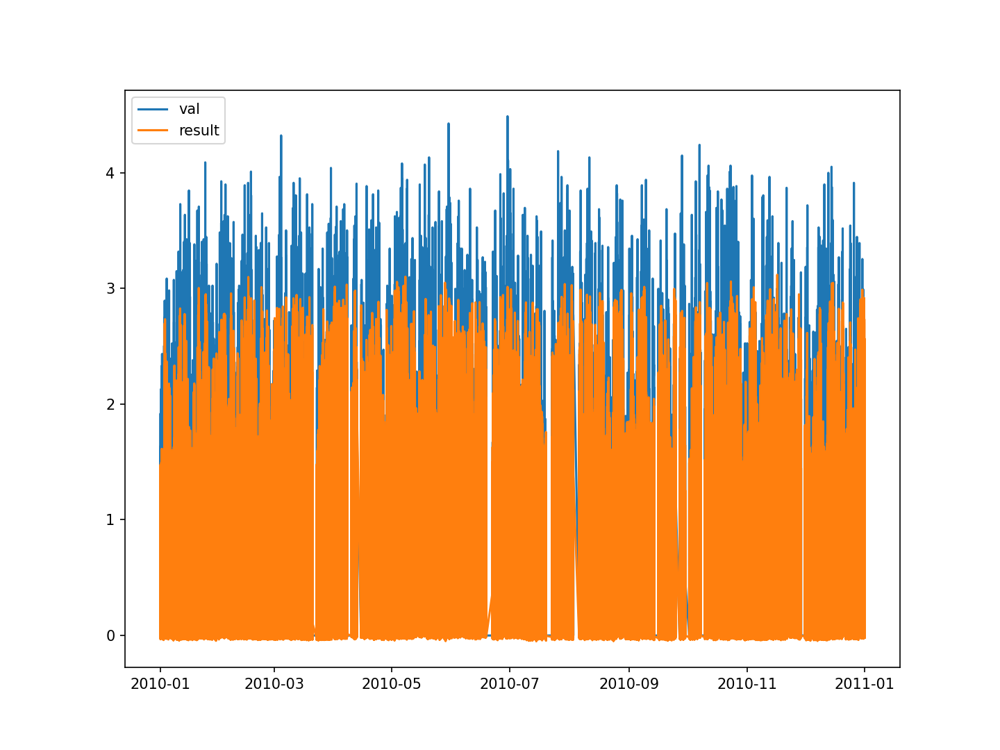

<IPython.core.display.Javascript object>


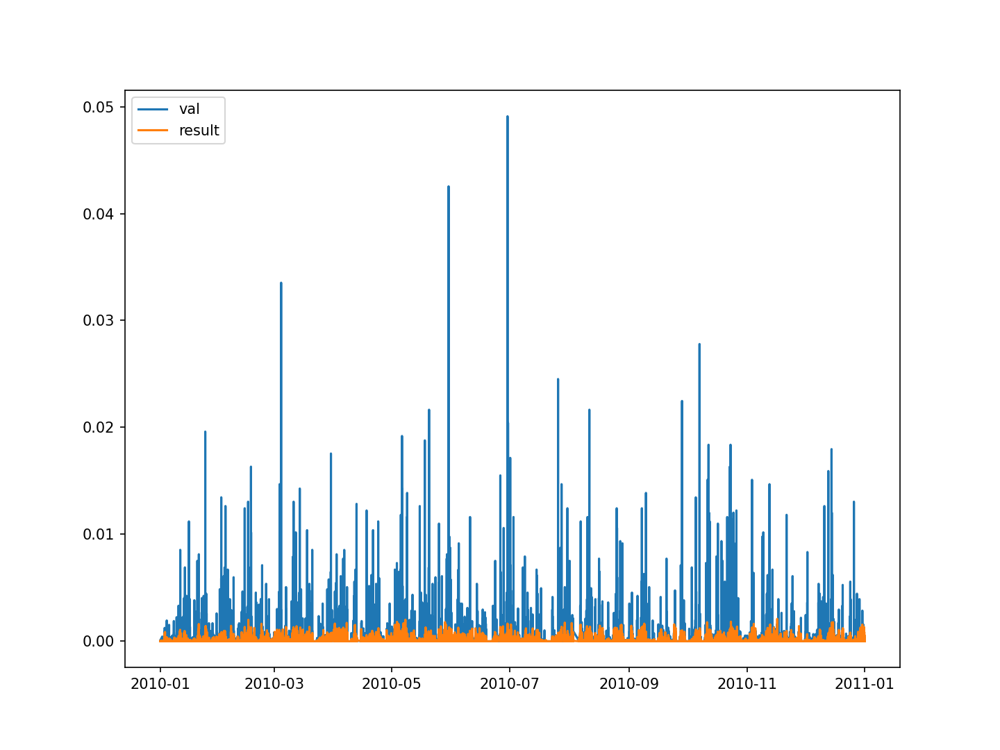

<IPython.core.display.Javascript object>


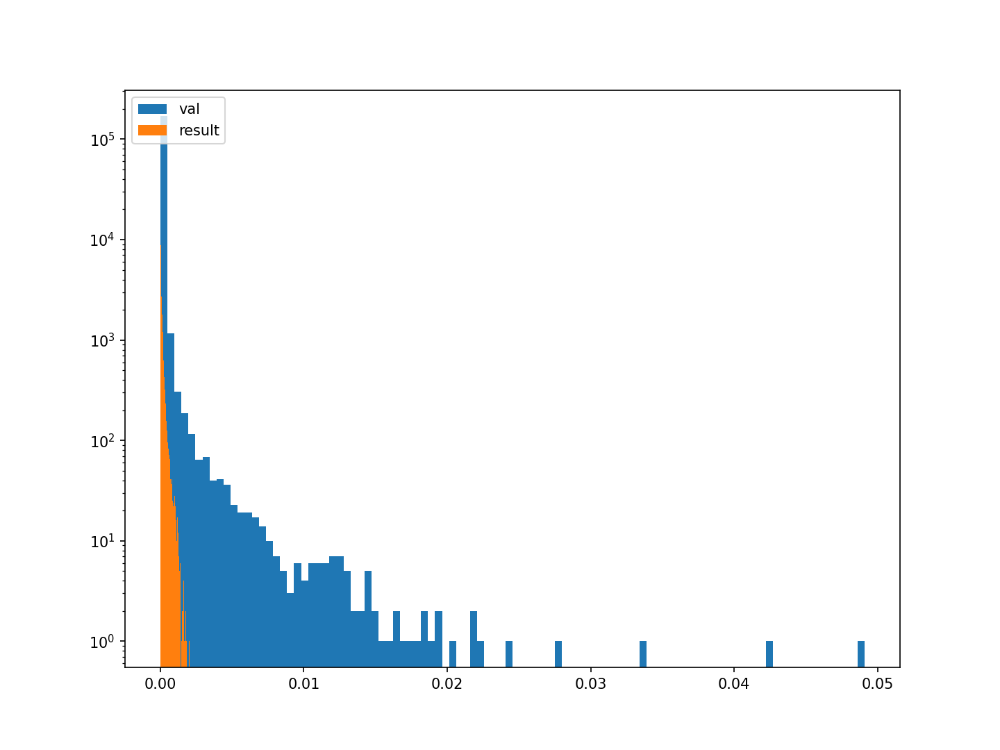

<IPython.core.display.Javascript object>


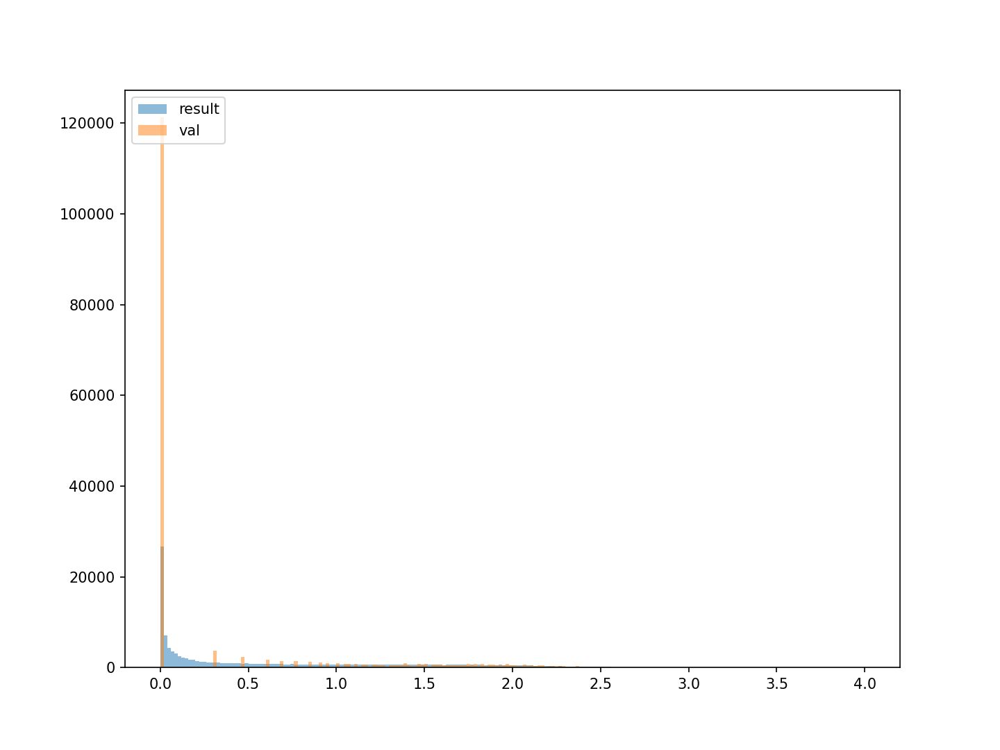

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


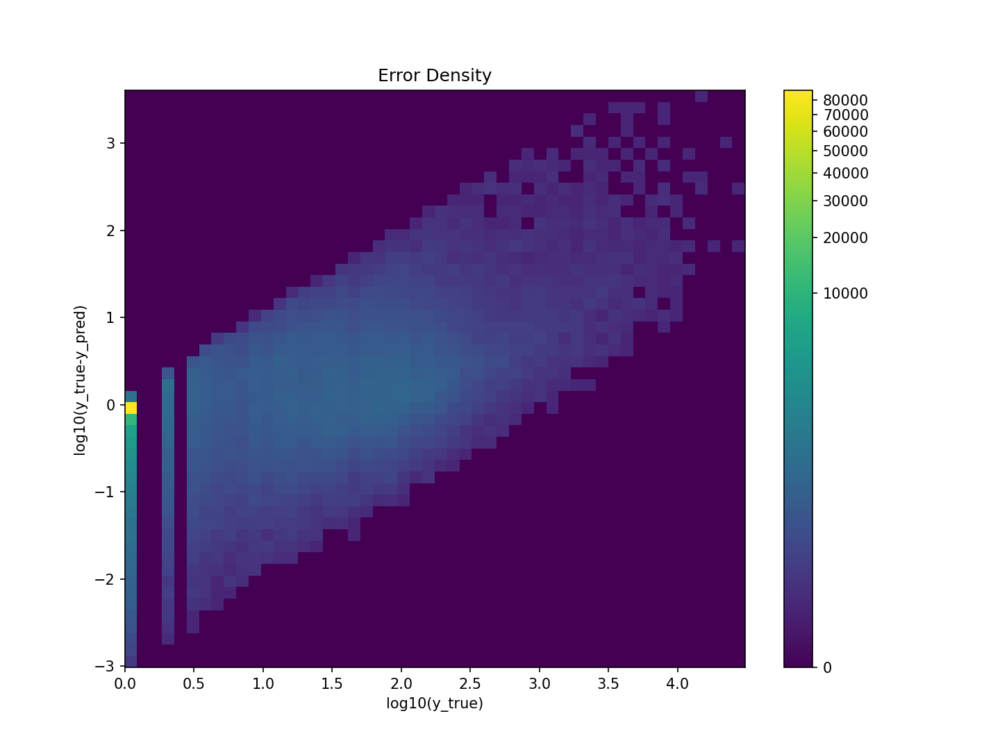

7


<IPython.core.display.Javascript object>


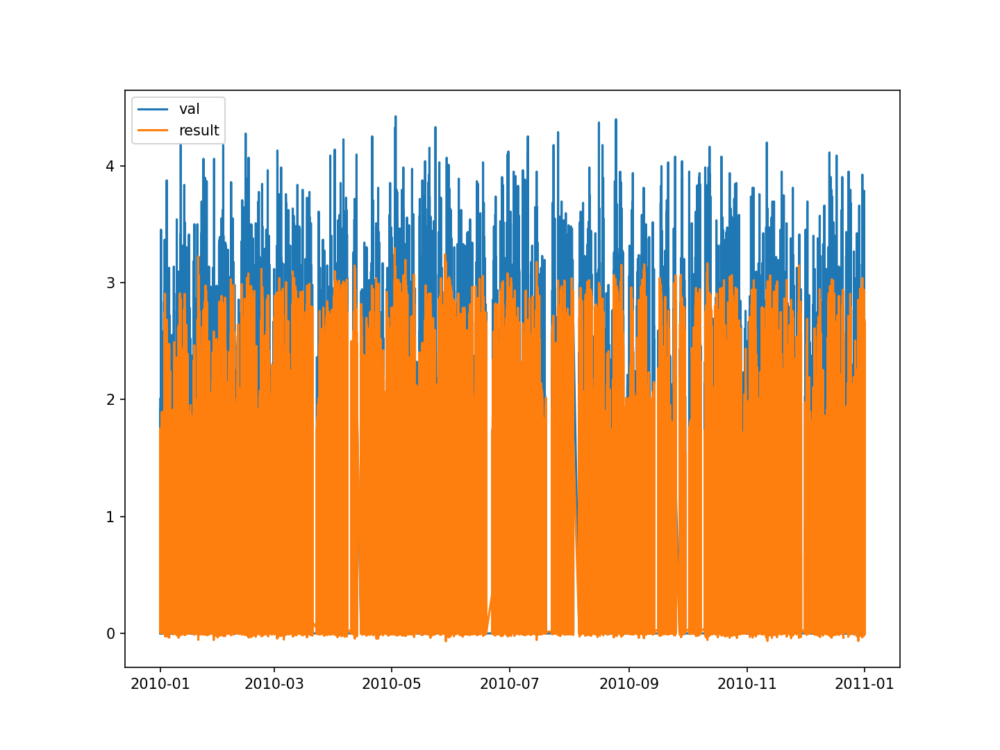

<IPython.core.display.Javascript object>


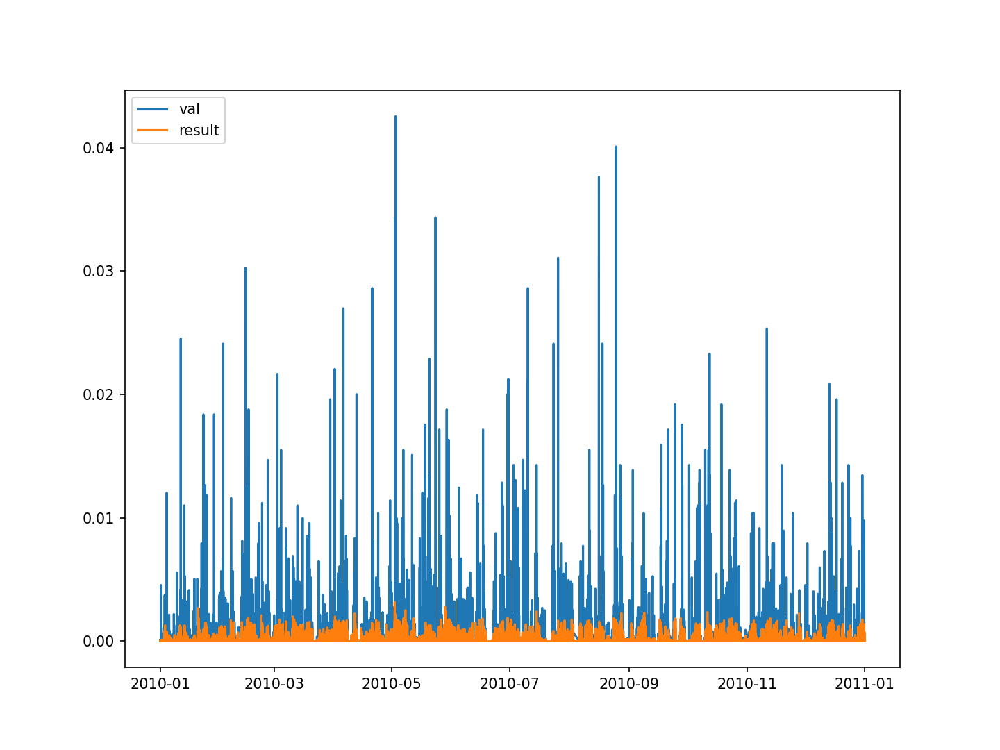

<IPython.core.display.Javascript object>


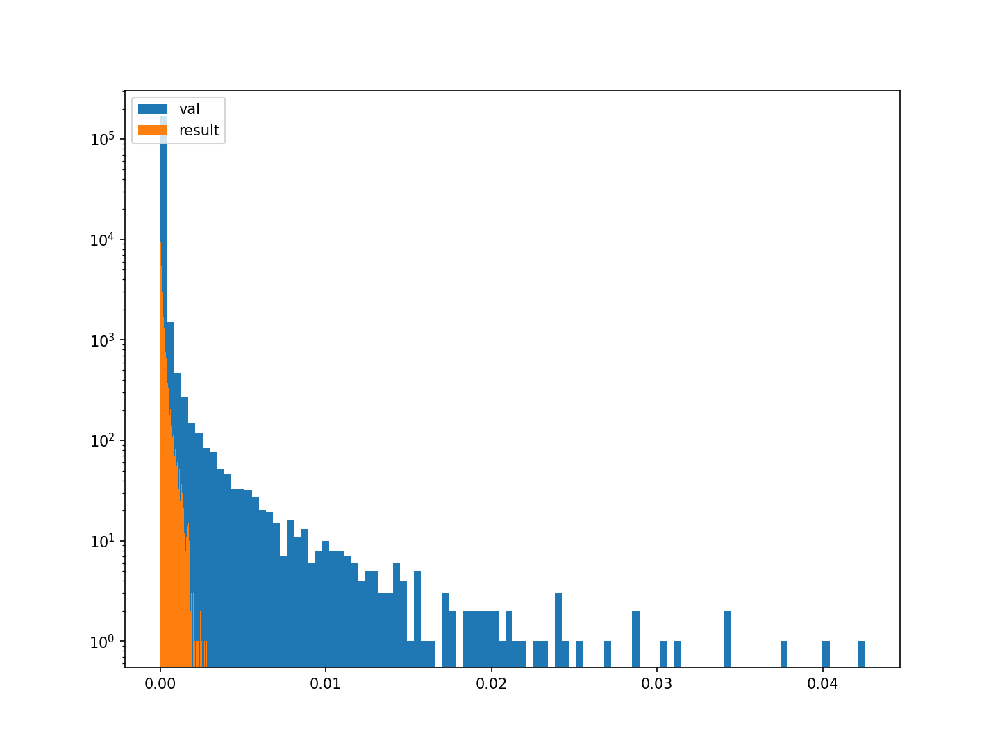

<IPython.core.display.Javascript object>


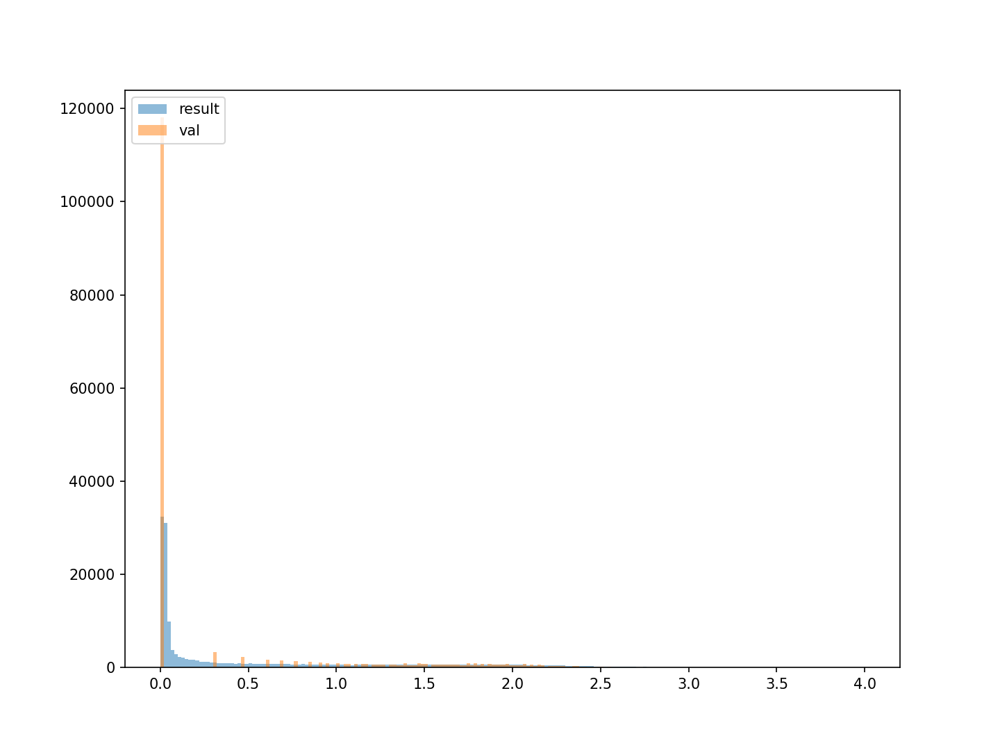

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


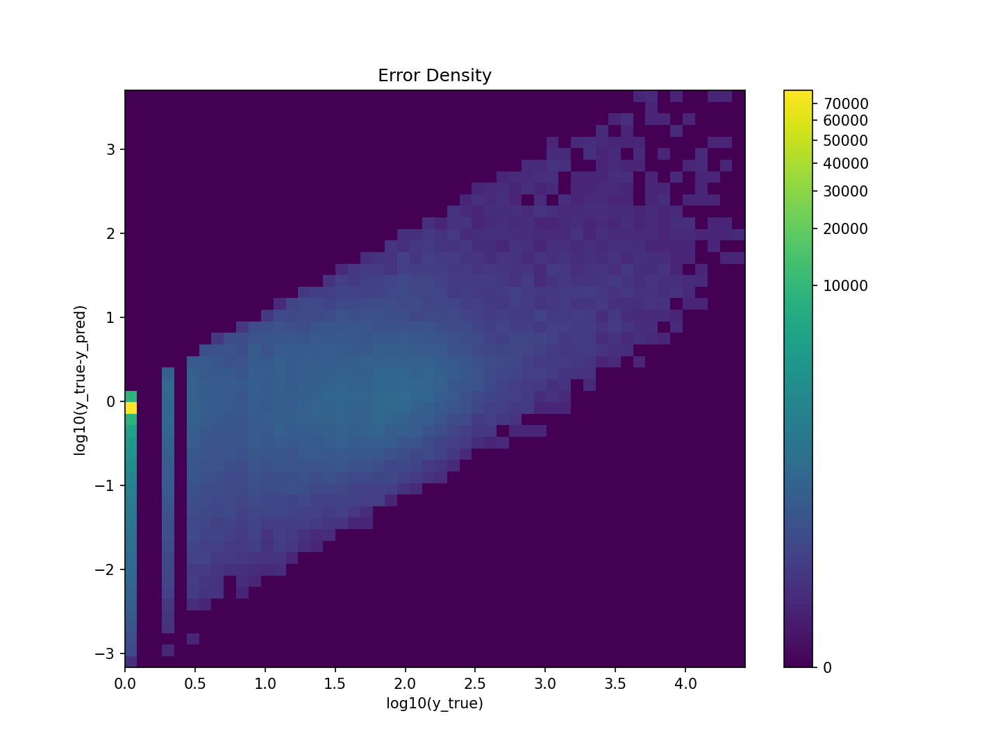

8


<IPython.core.display.Javascript object>


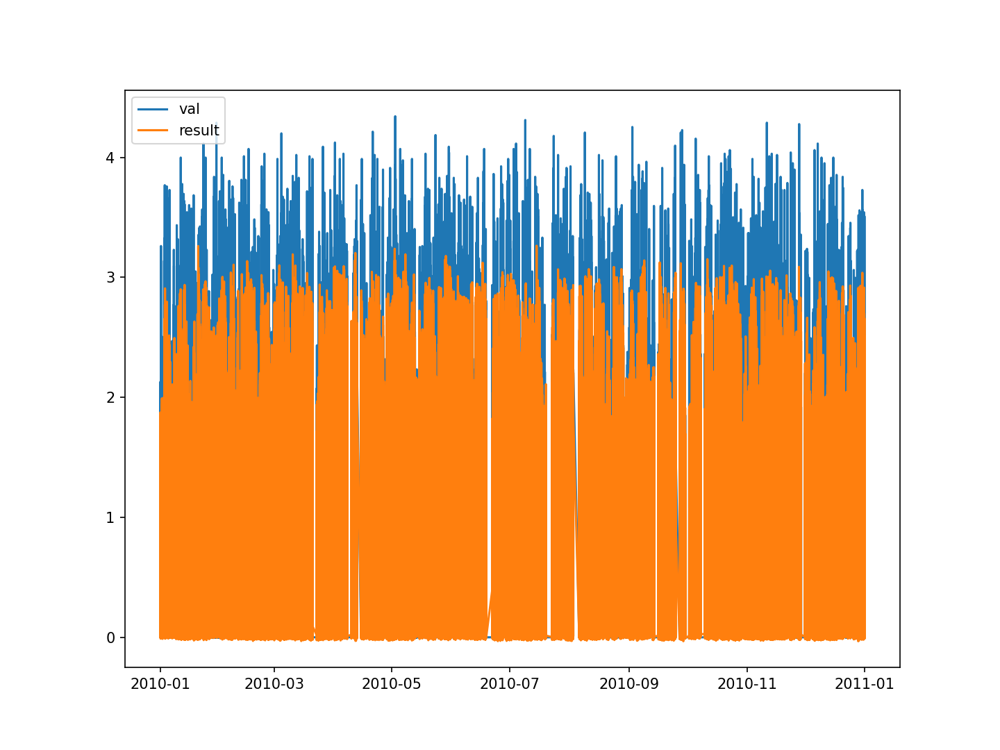

<IPython.core.display.Javascript object>


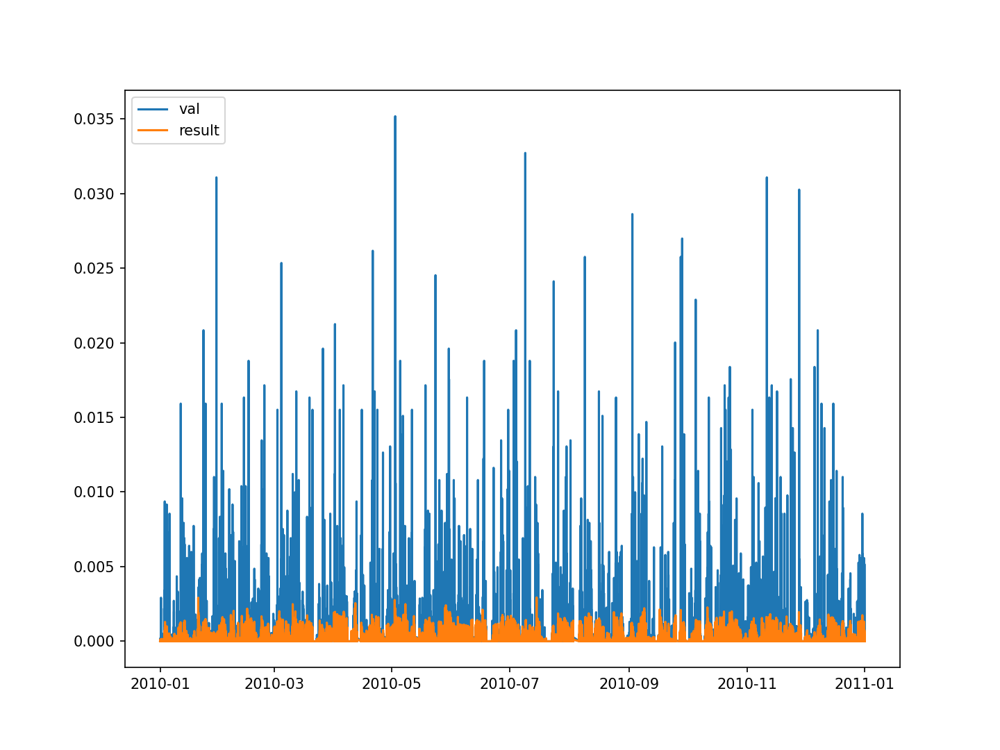

<IPython.core.display.Javascript object>


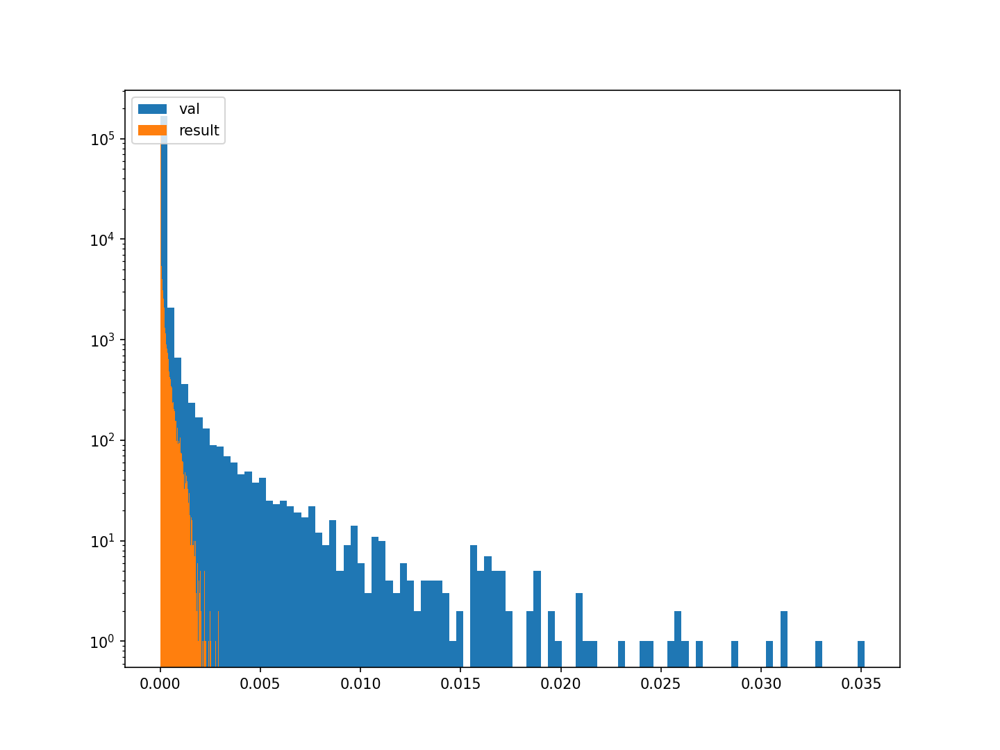

<IPython.core.display.Javascript object>


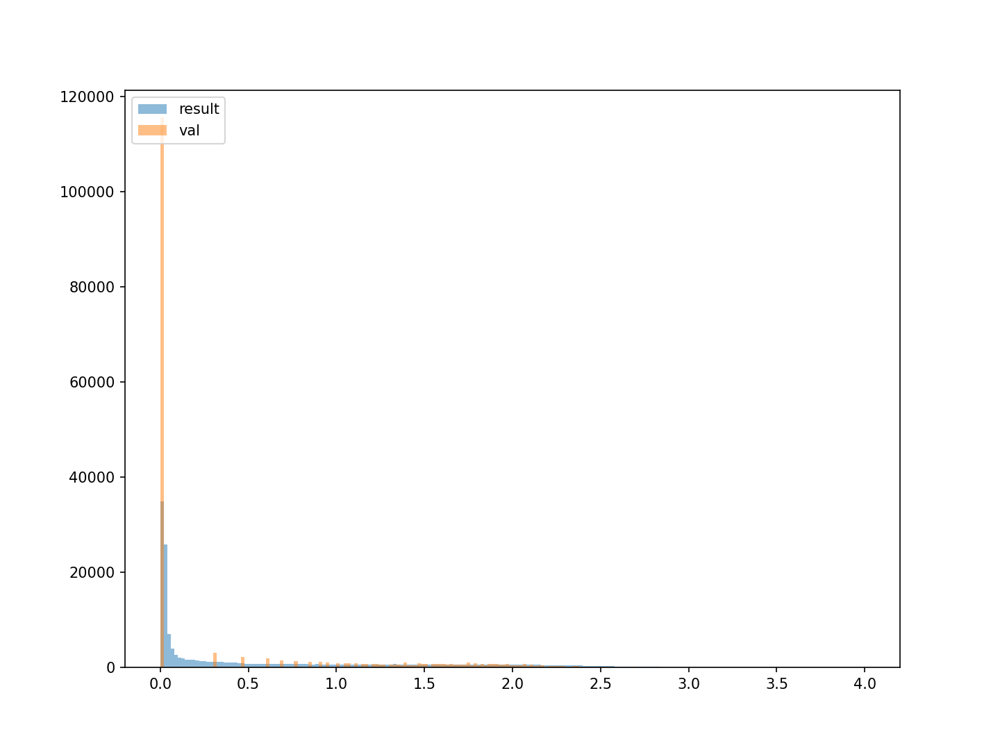

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


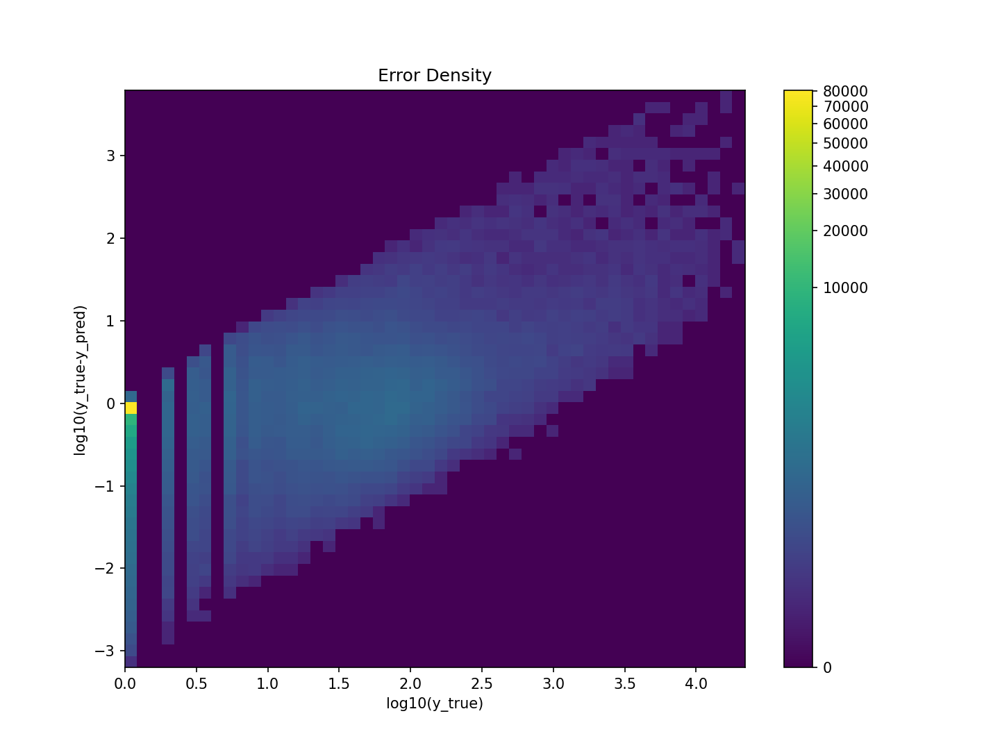

9


<IPython.core.display.Javascript object>


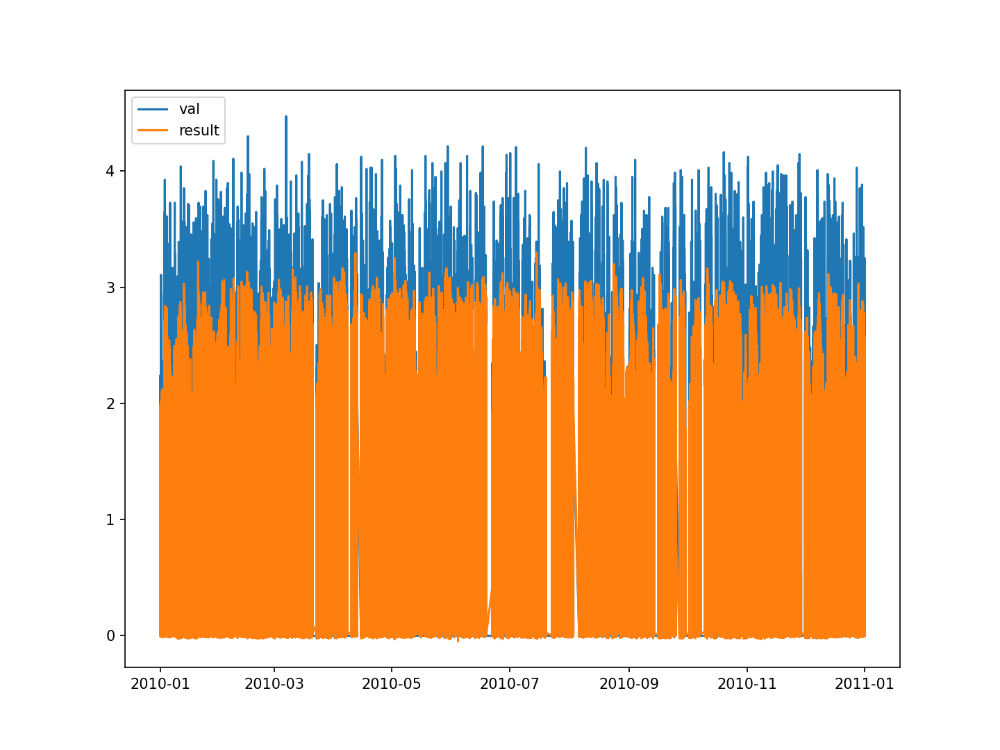

<IPython.core.display.Javascript object>


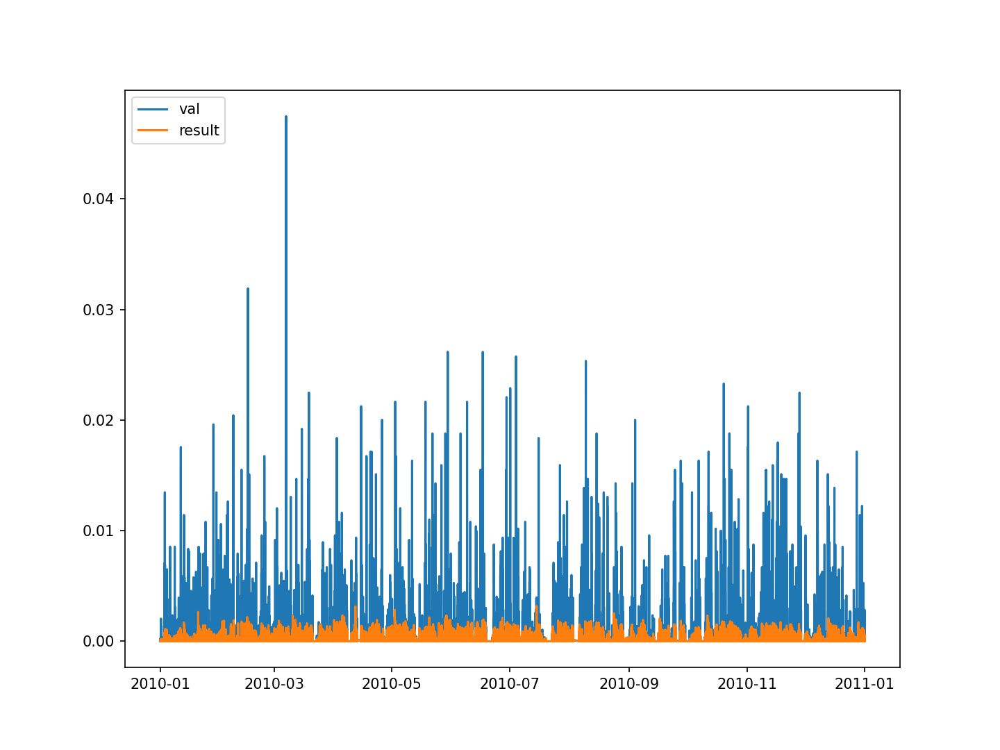

<IPython.core.display.Javascript object>


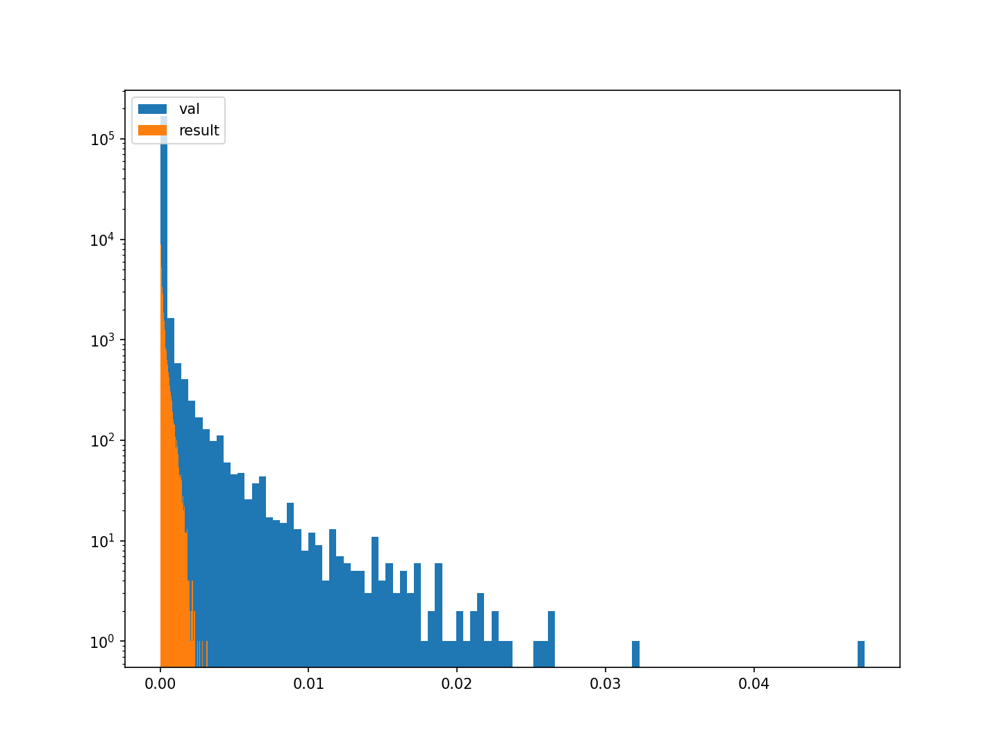

<IPython.core.display.Javascript object>


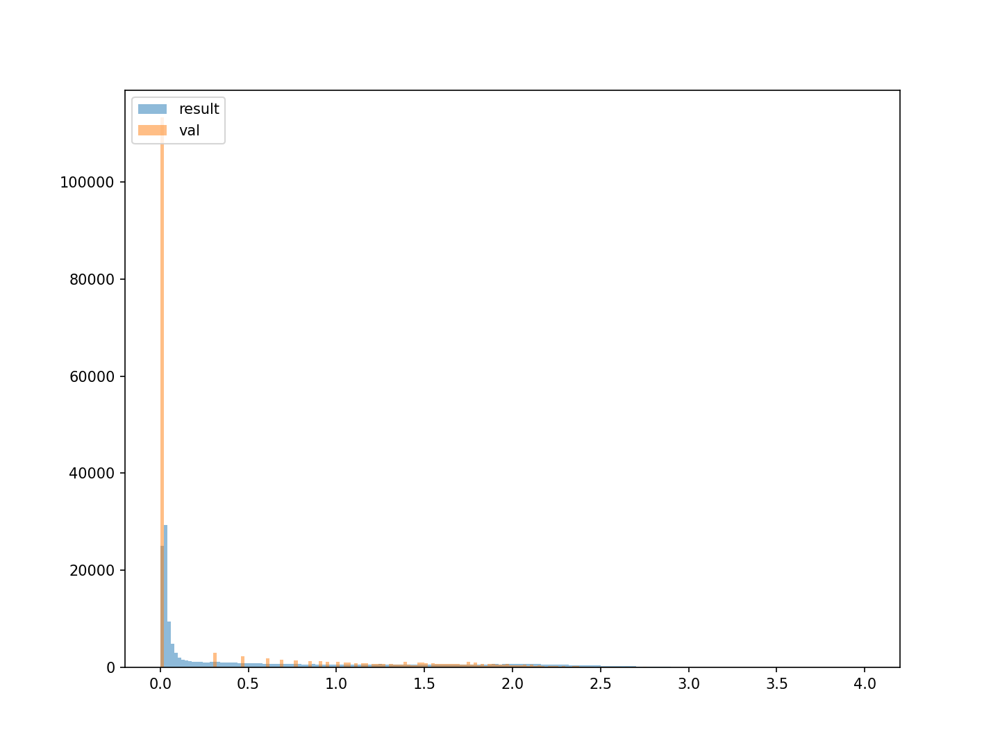

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


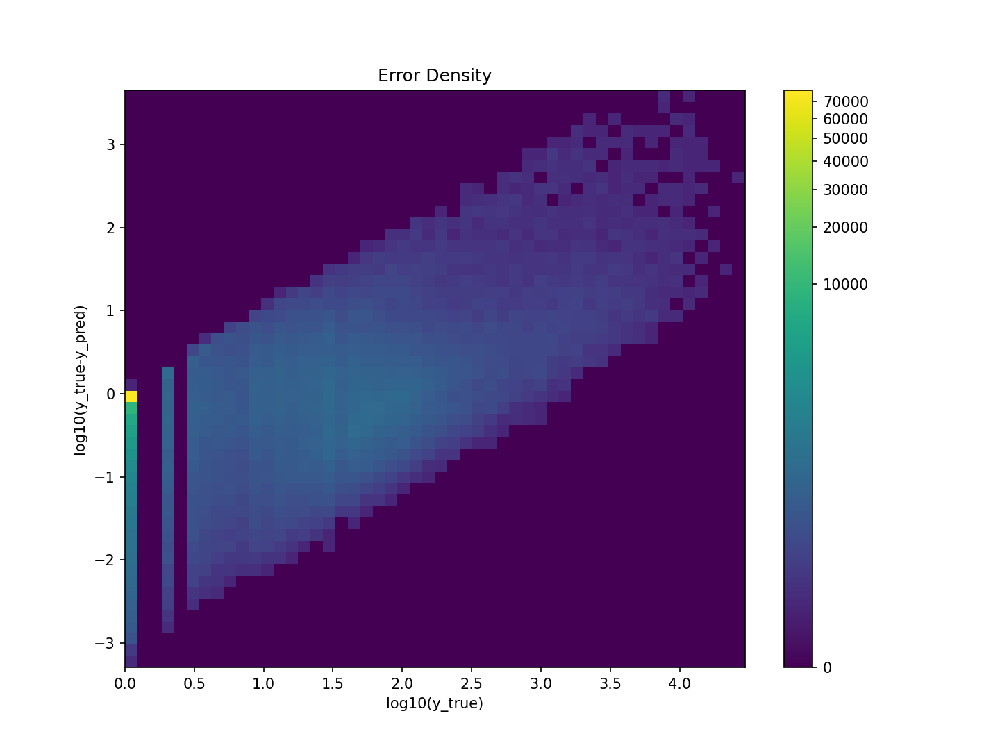

10


<IPython.core.display.Javascript object>


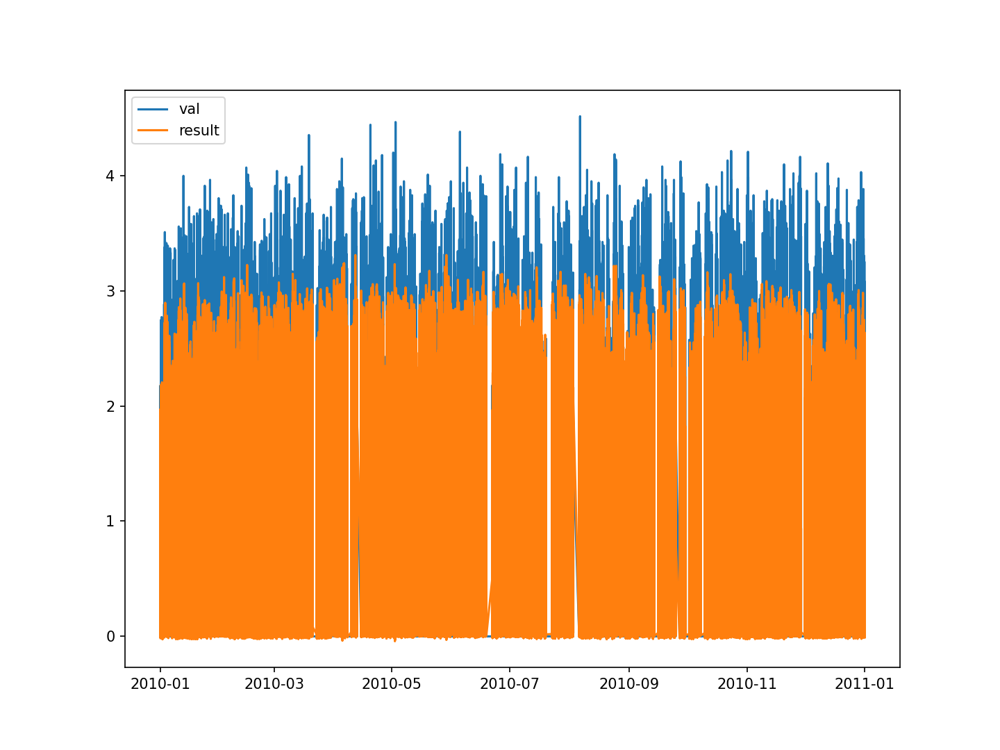

<IPython.core.display.Javascript object>


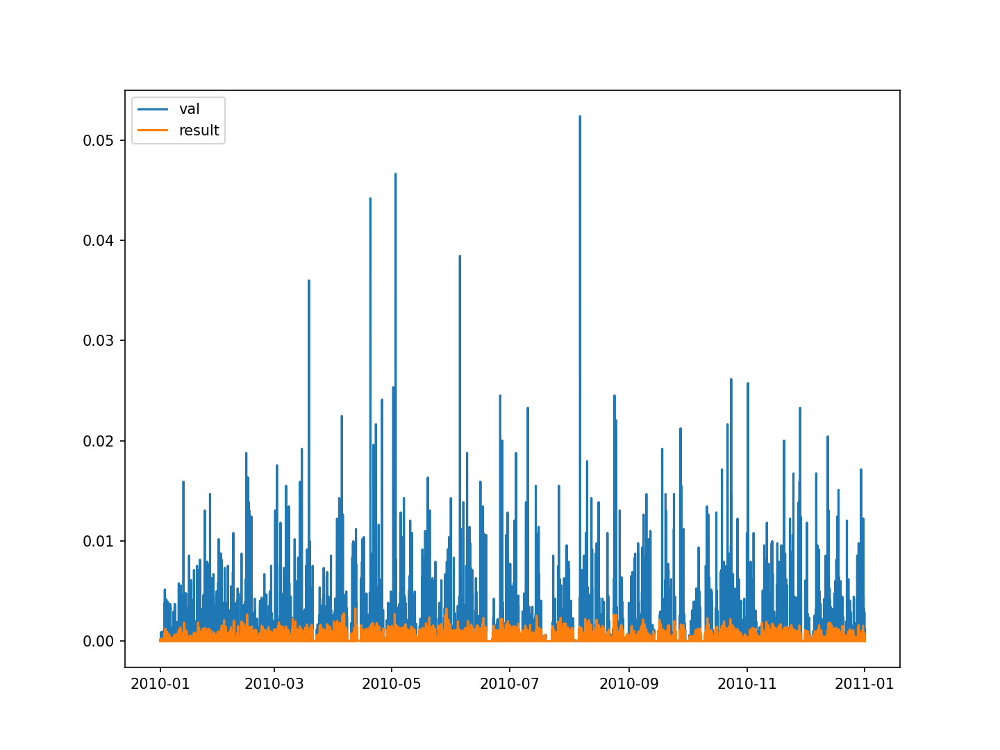

<IPython.core.display.Javascript object>


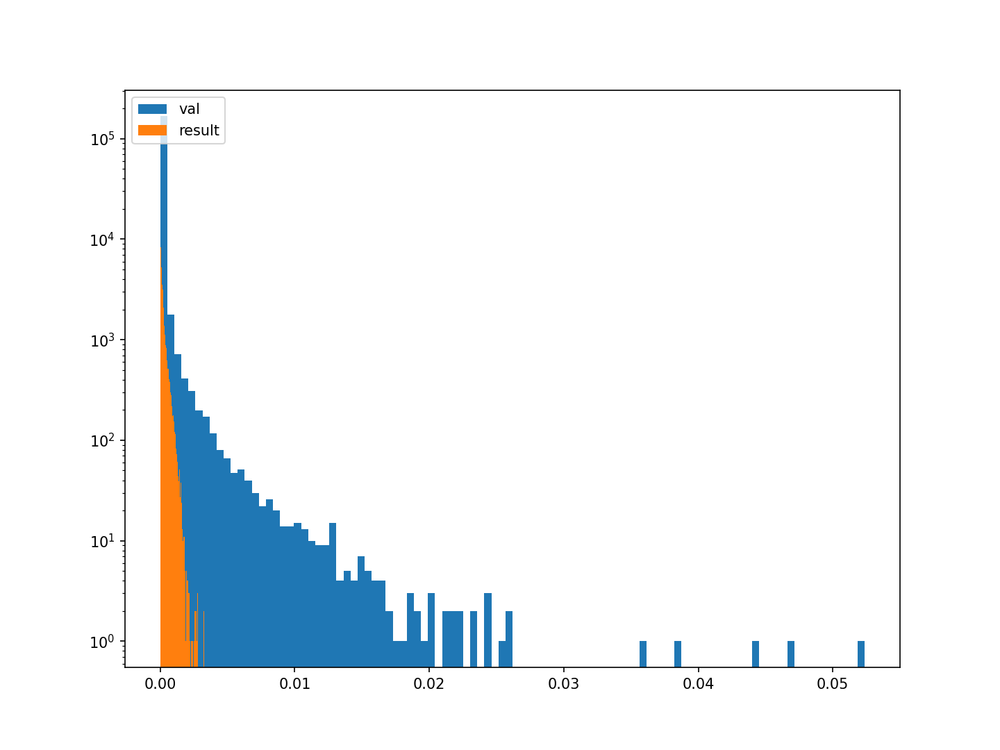

<IPython.core.display.Javascript object>


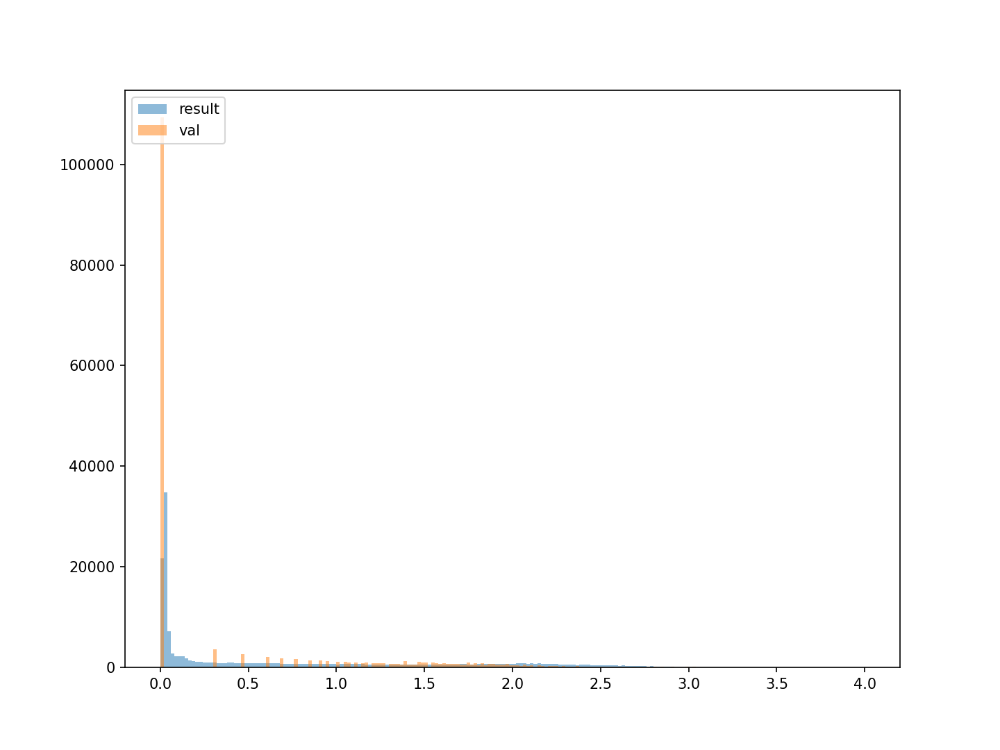

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


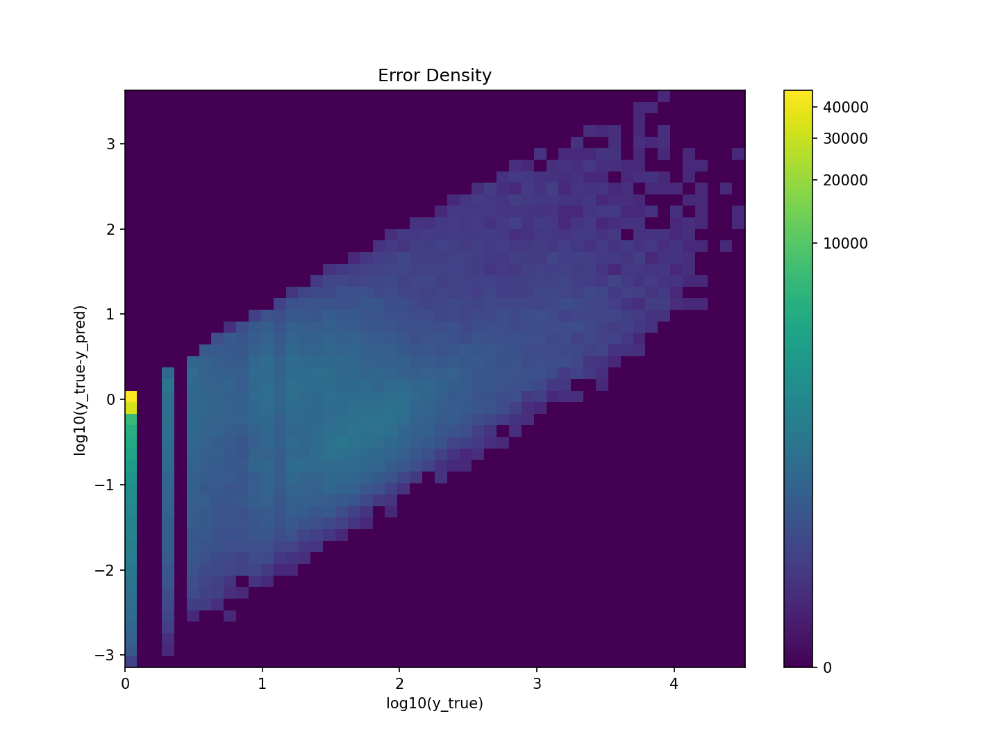

11


<IPython.core.display.Javascript object>


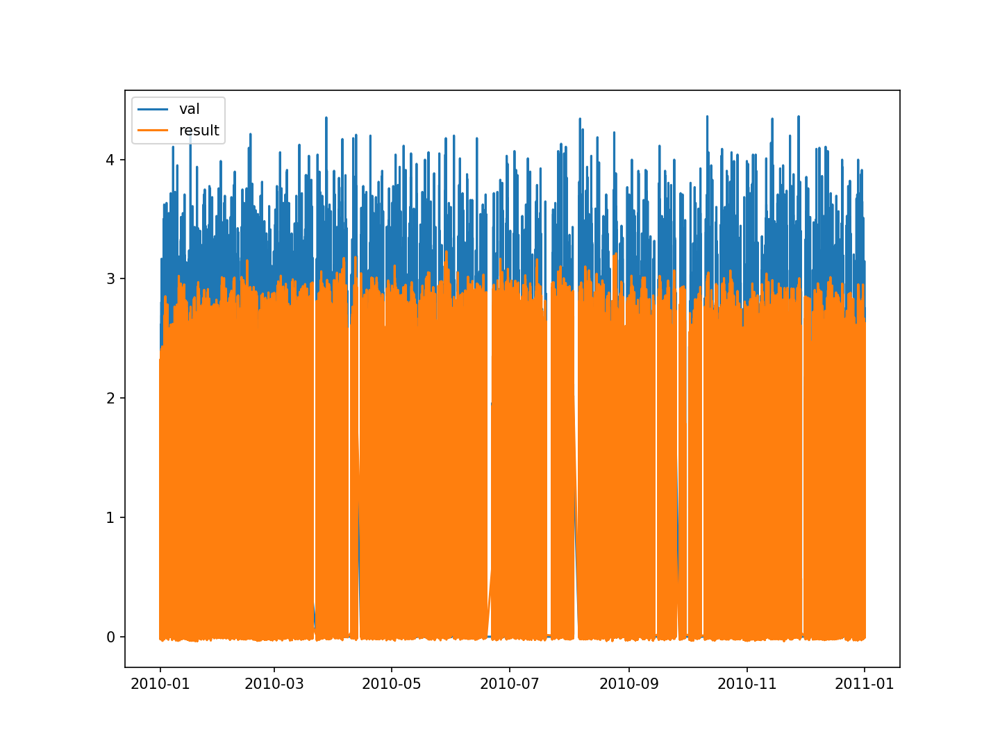

<IPython.core.display.Javascript object>


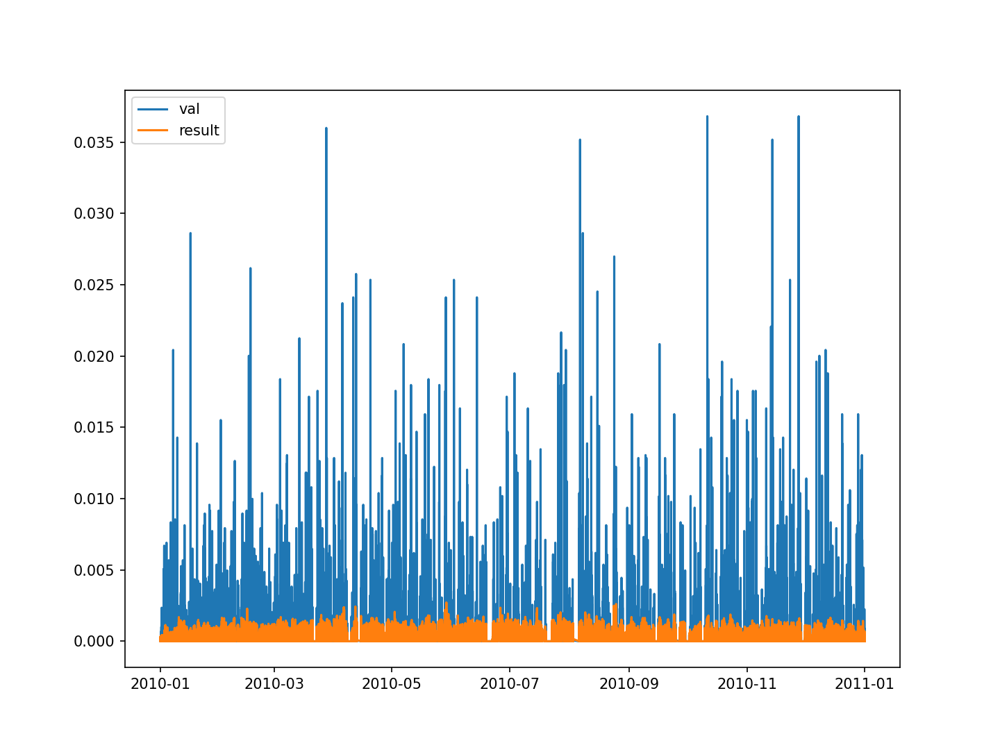

<IPython.core.display.Javascript object>


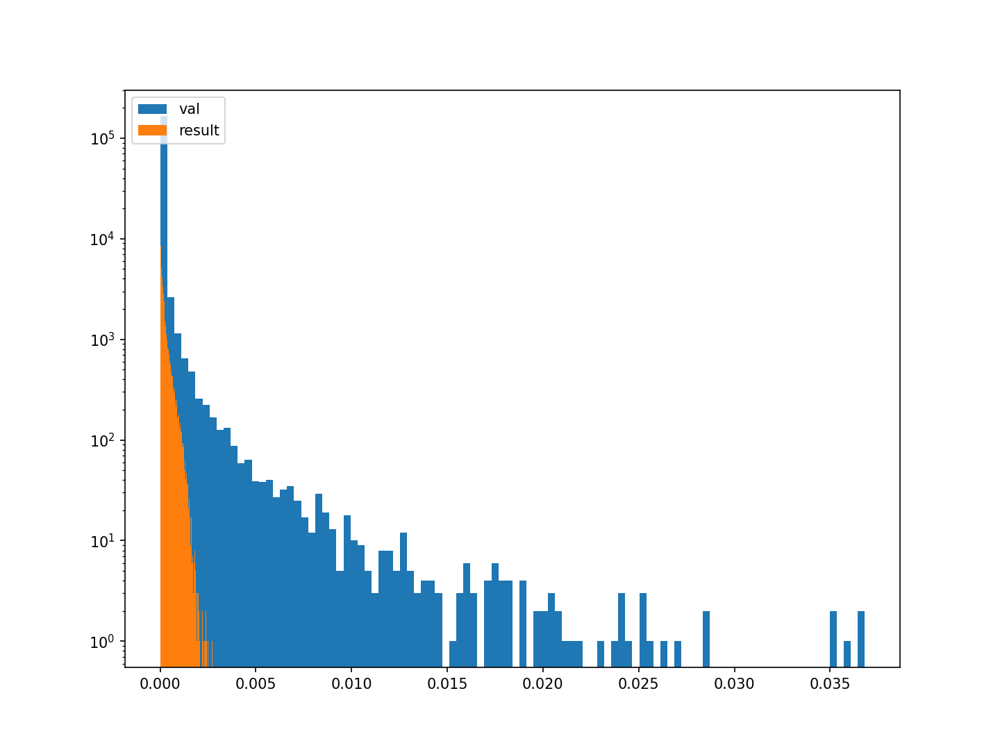

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


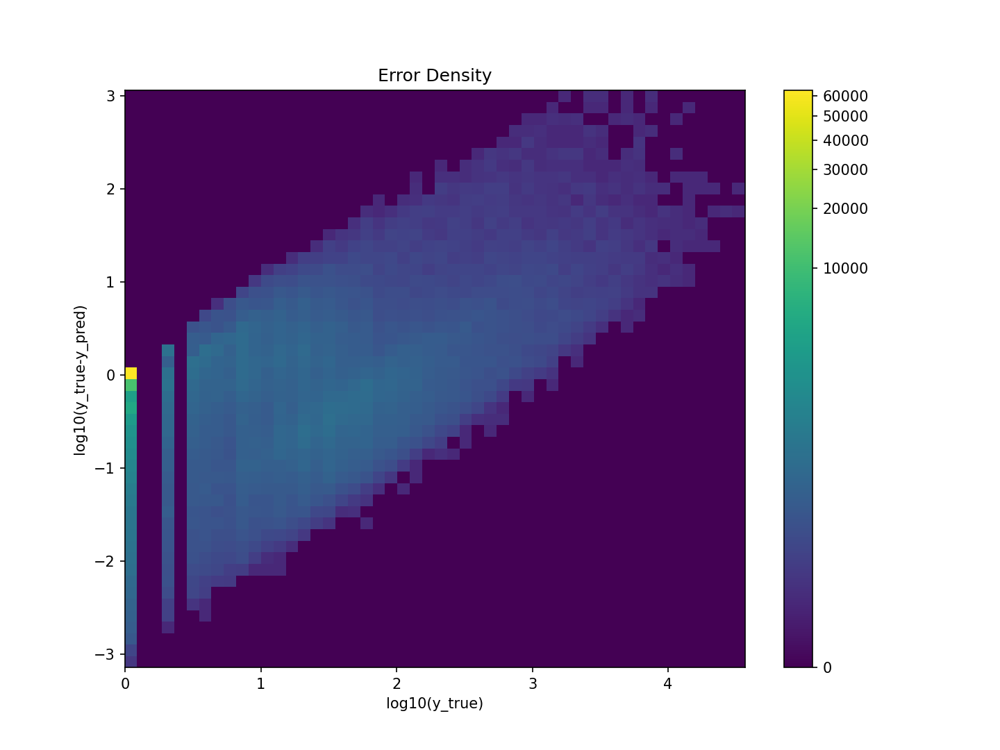

13


<IPython.core.display.Javascript object>


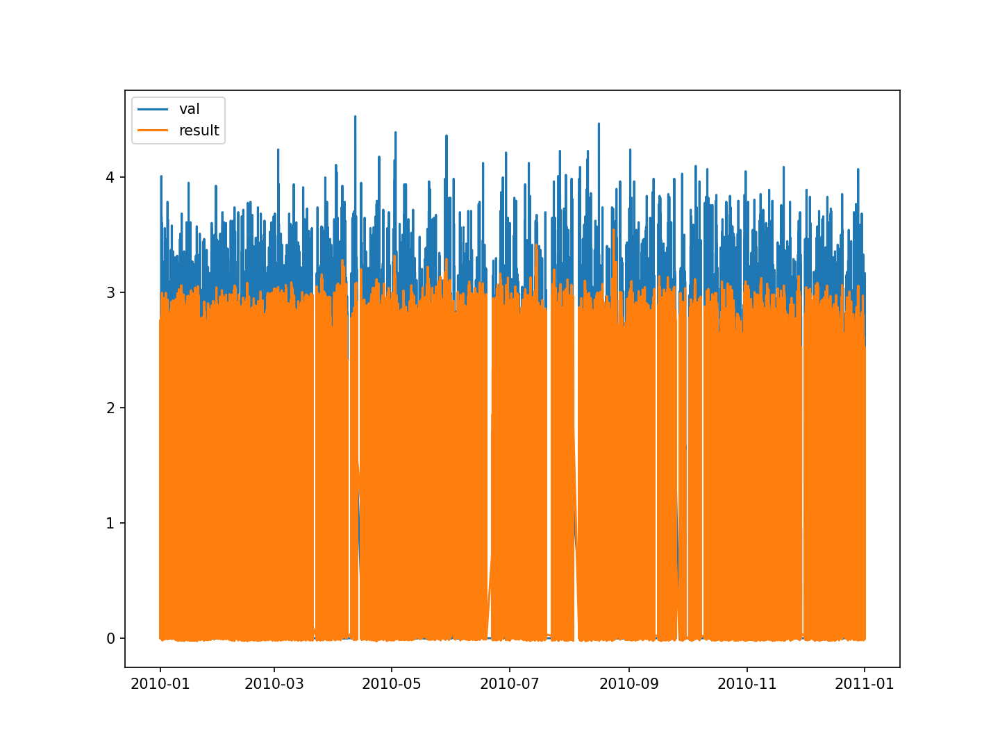

<IPython.core.display.Javascript object>


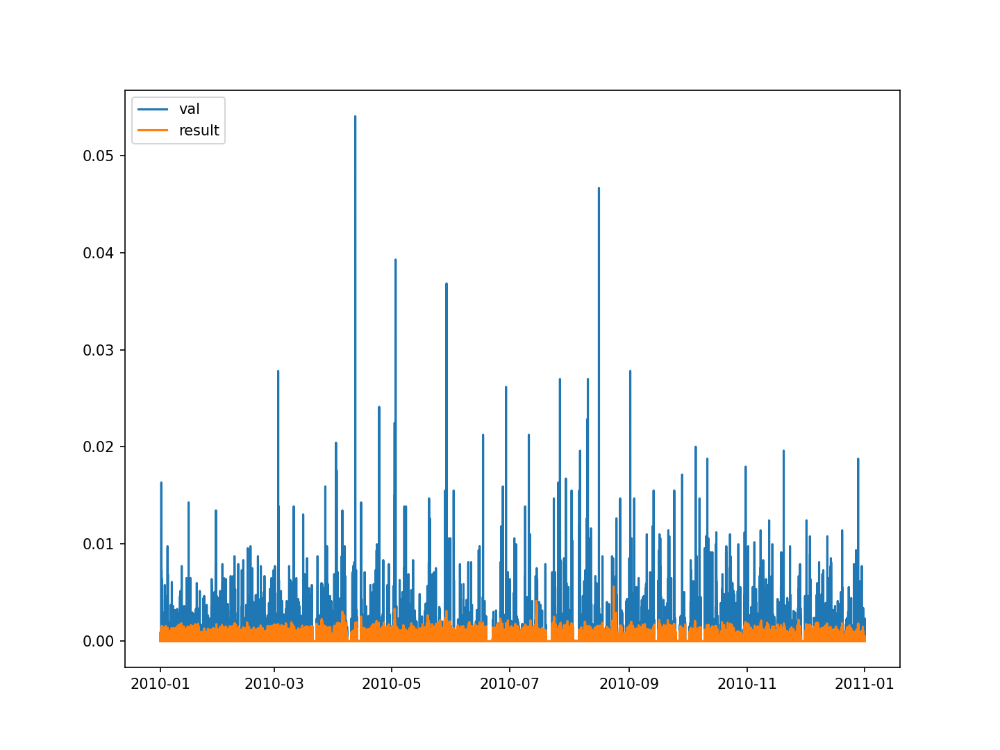

<IPython.core.display.Javascript object>


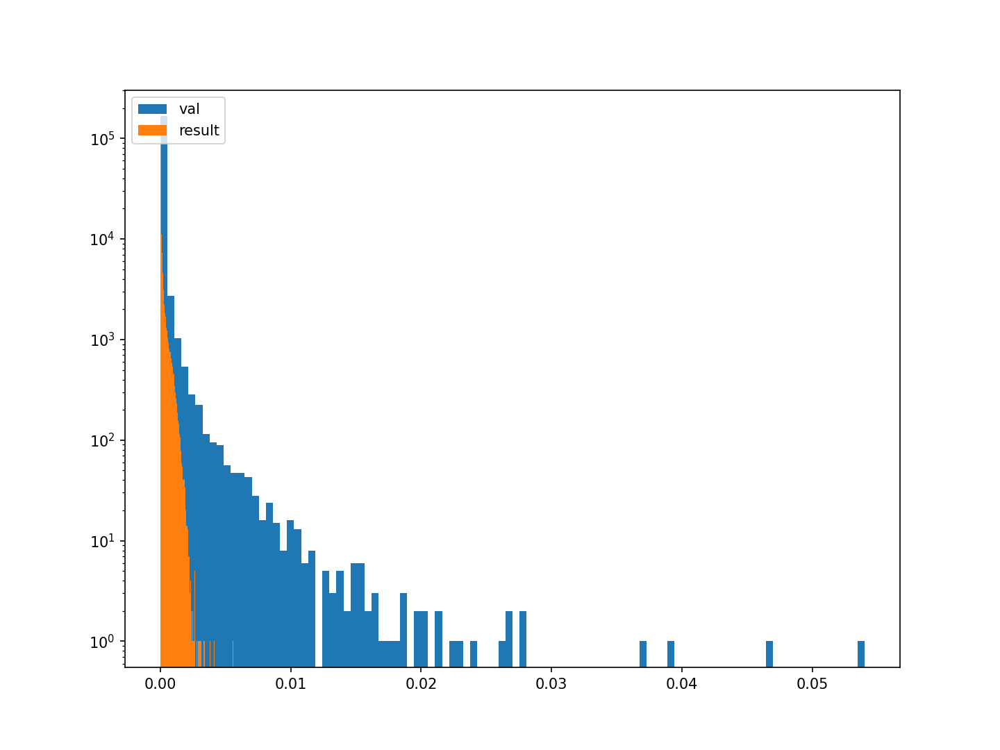

<IPython.core.display.Javascript object>


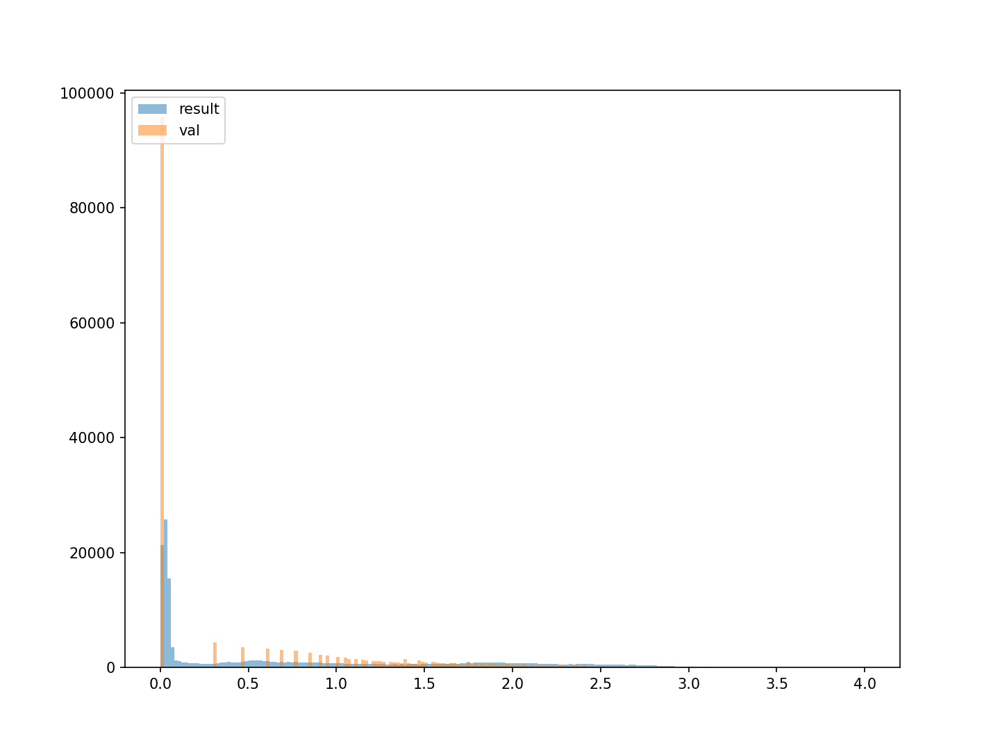

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


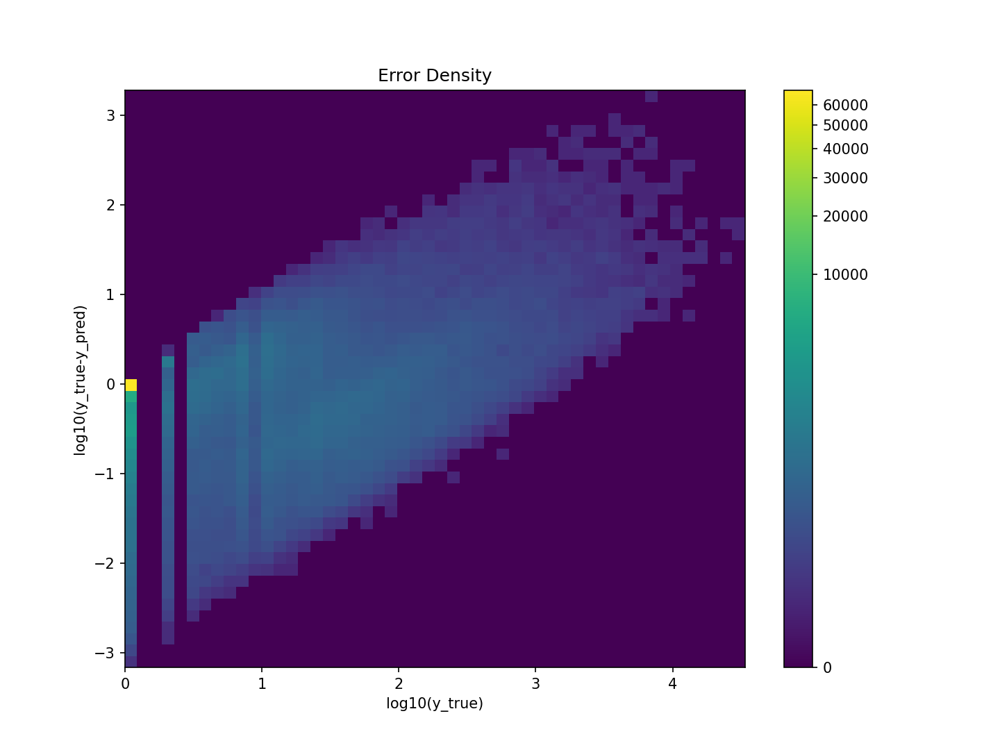

14


<IPython.core.display.Javascript object>


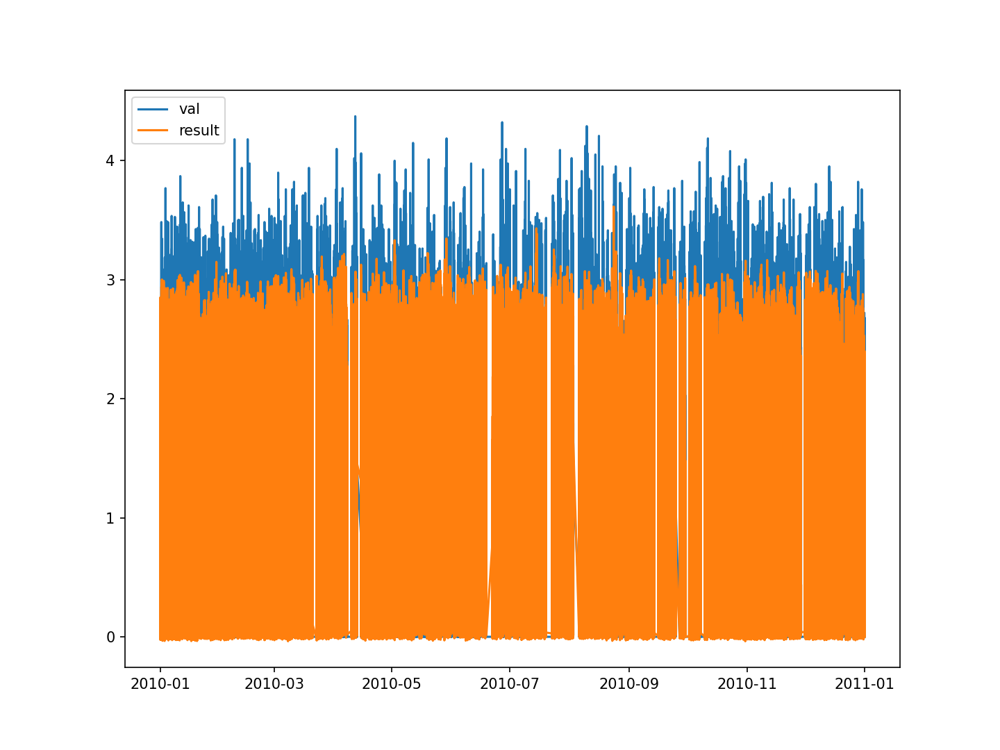

<IPython.core.display.Javascript object>


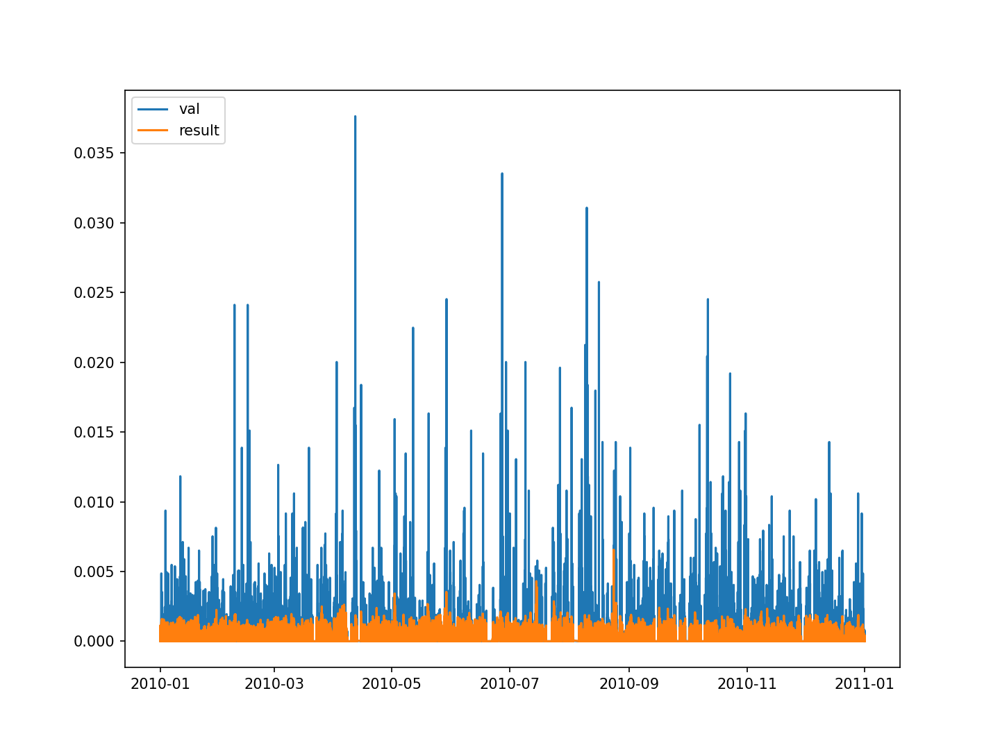

<IPython.core.display.Javascript object>


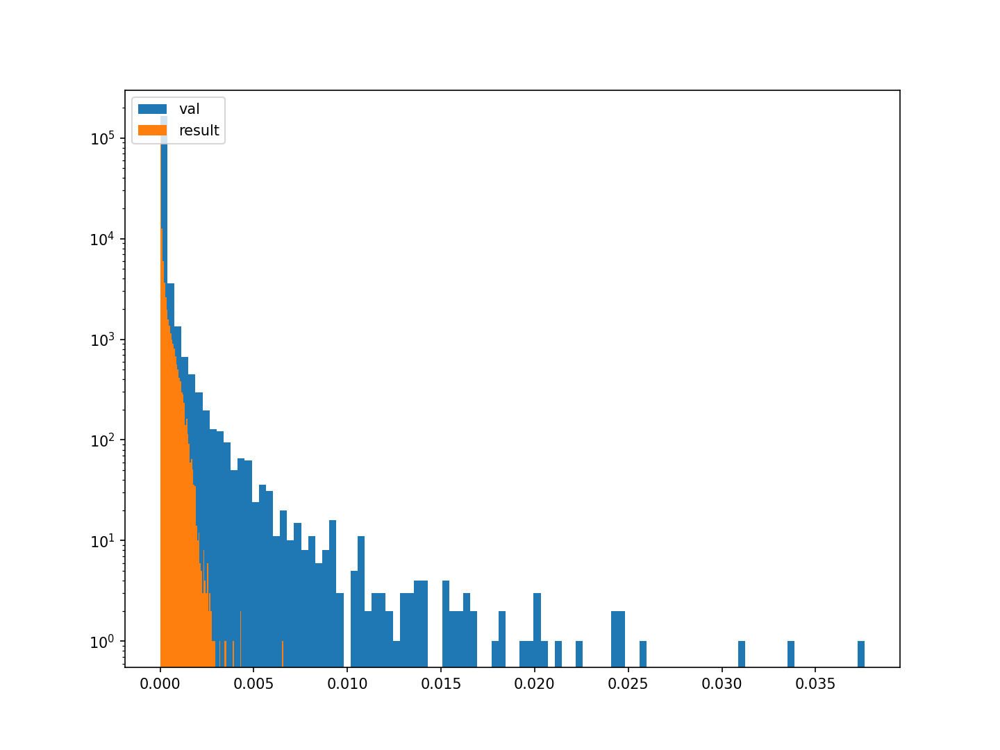

<IPython.core.display.Javascript object>


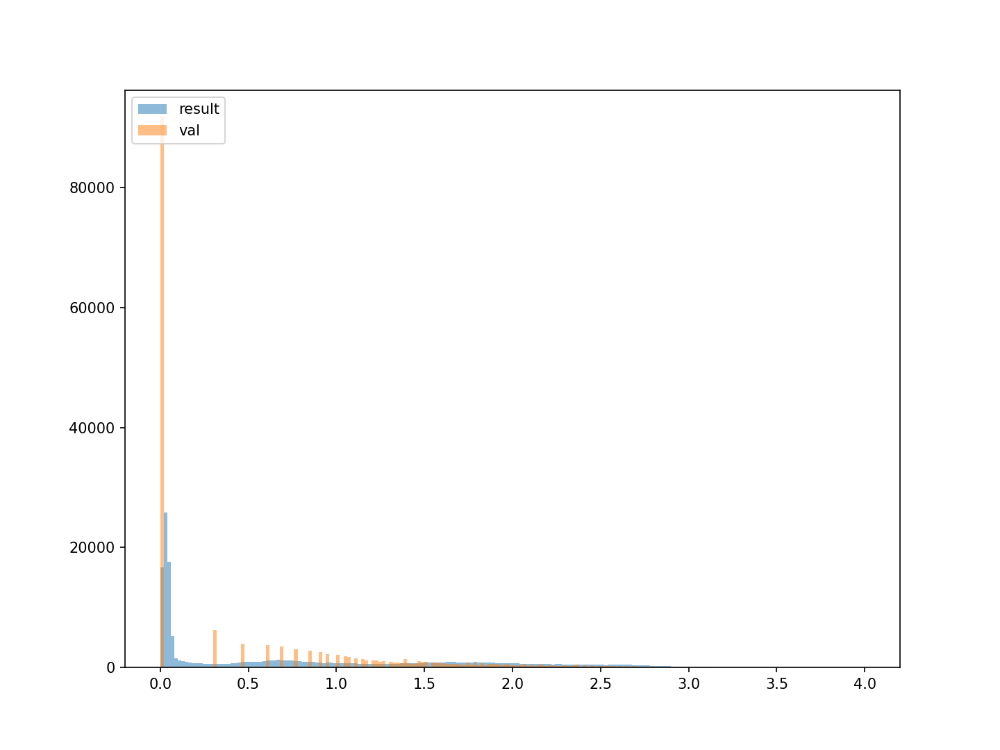

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


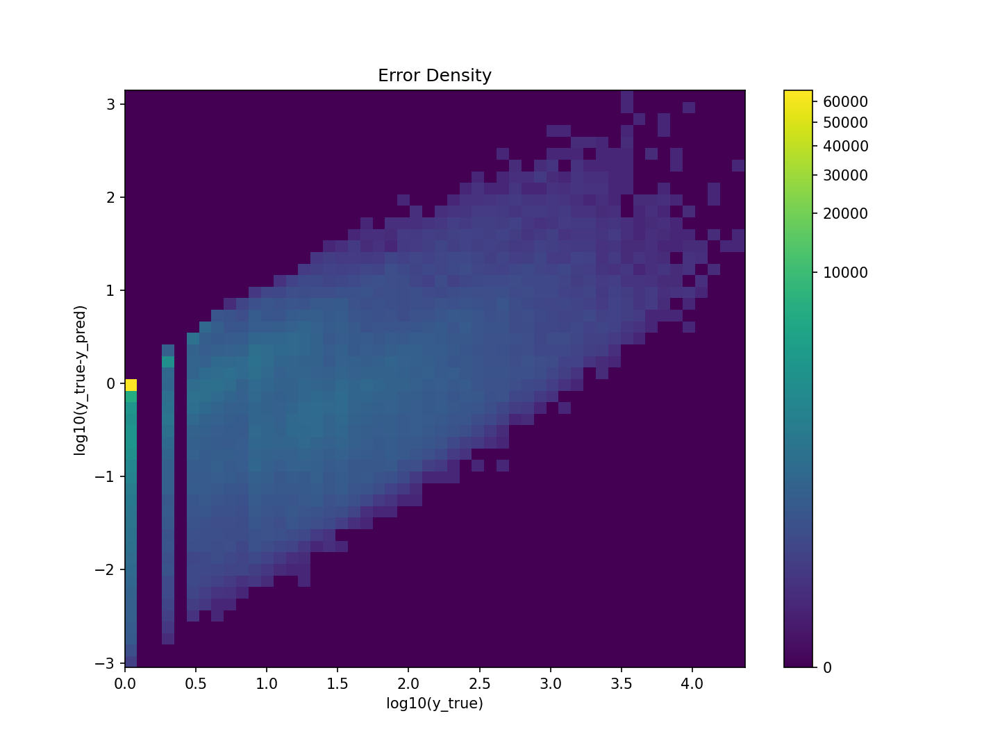

15


<IPython.core.display.Javascript object>


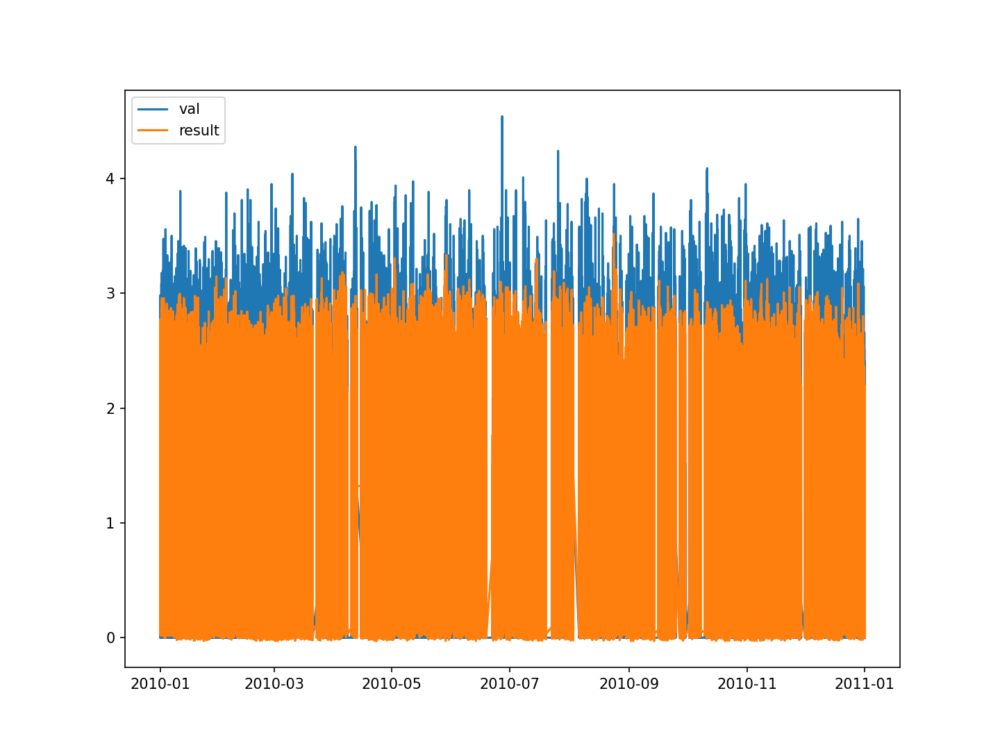

<IPython.core.display.Javascript object>


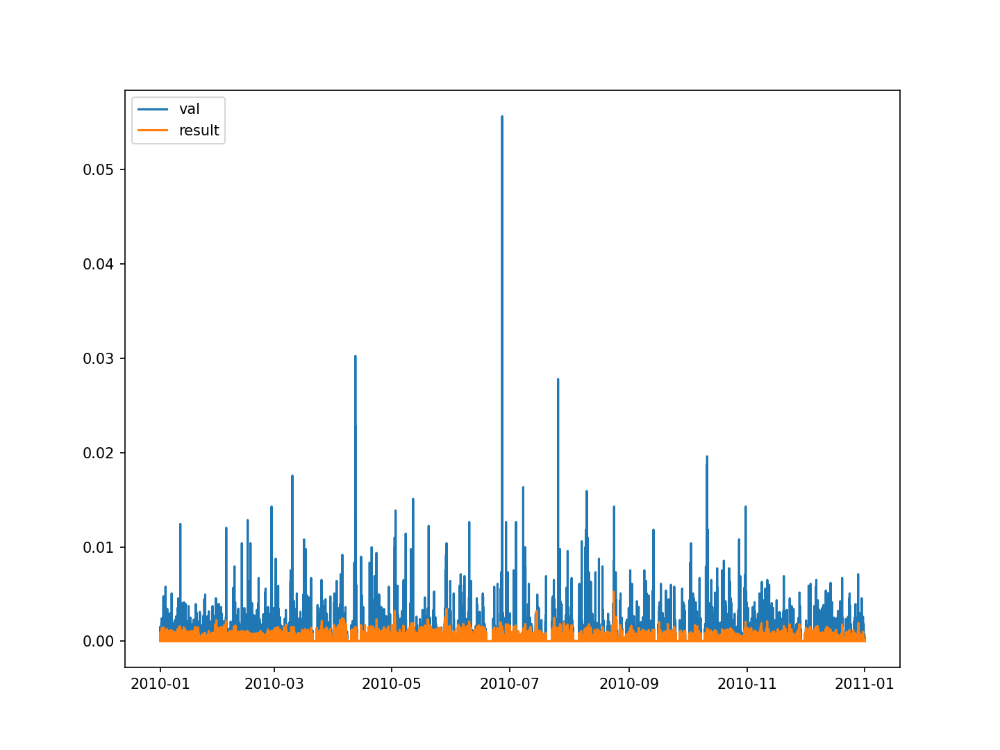

<IPython.core.display.Javascript object>


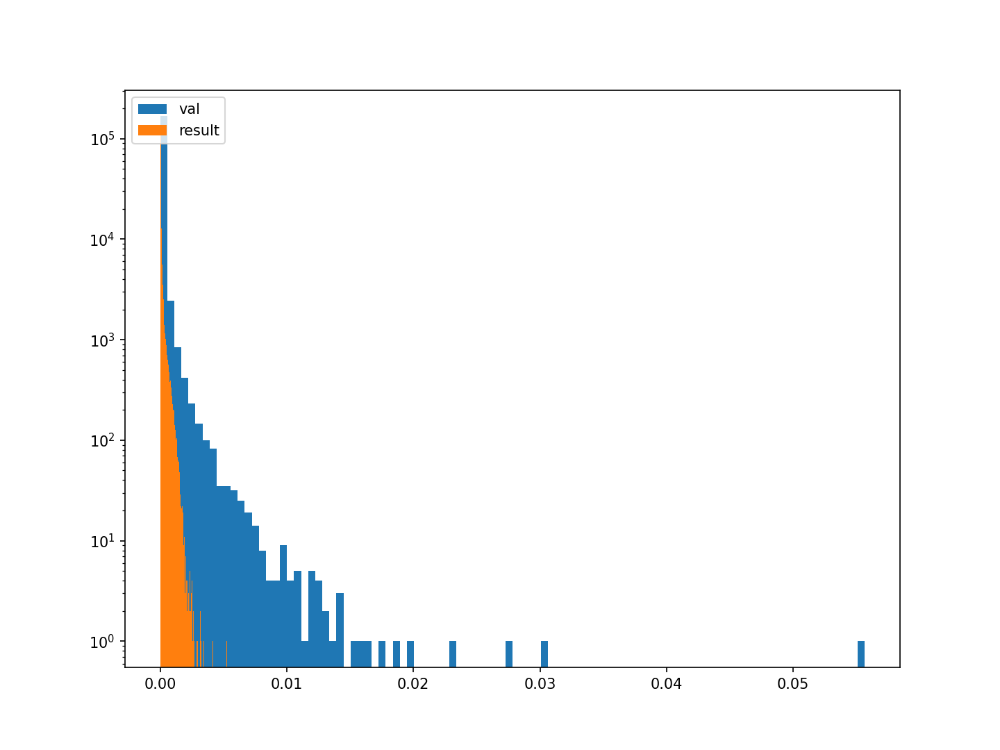

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


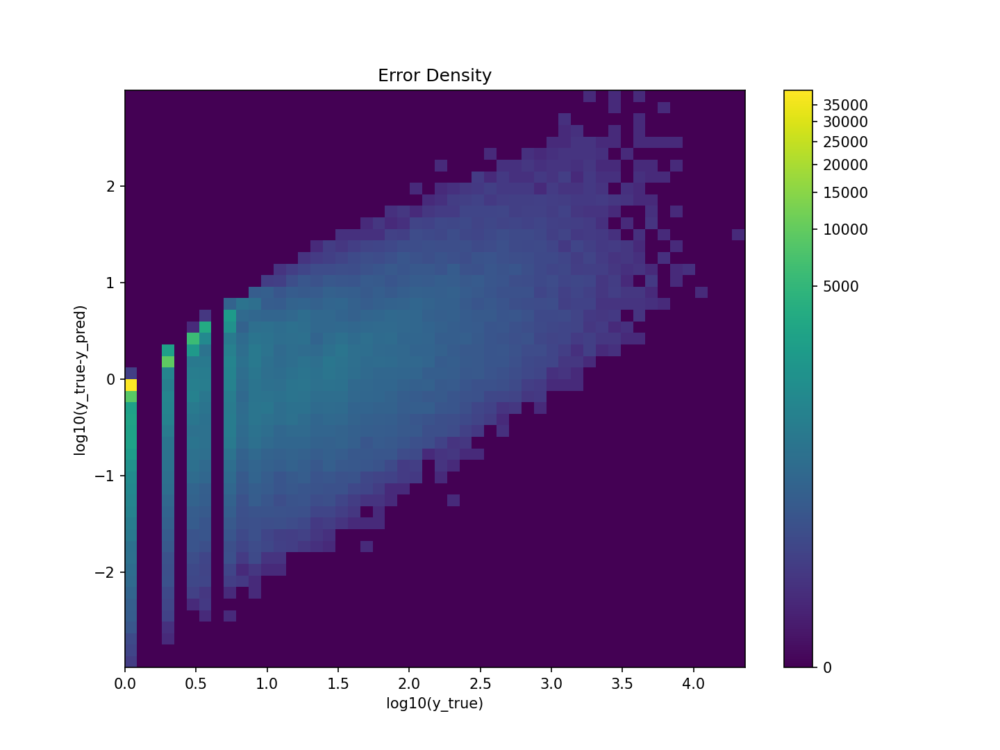

17


<IPython.core.display.Javascript object>


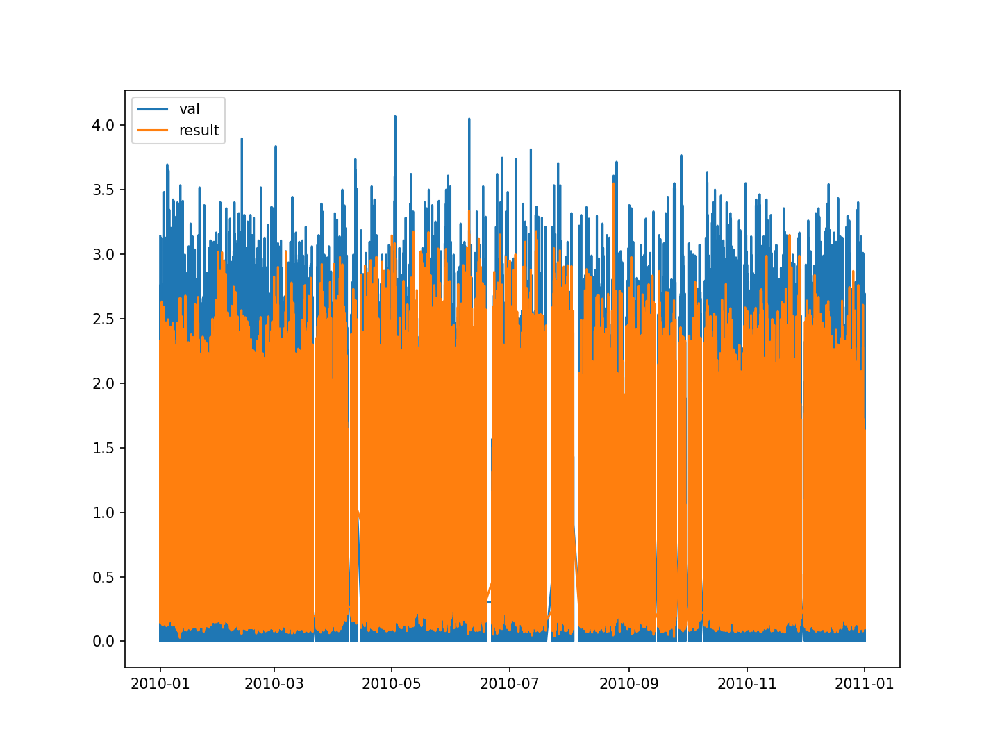

<IPython.core.display.Javascript object>


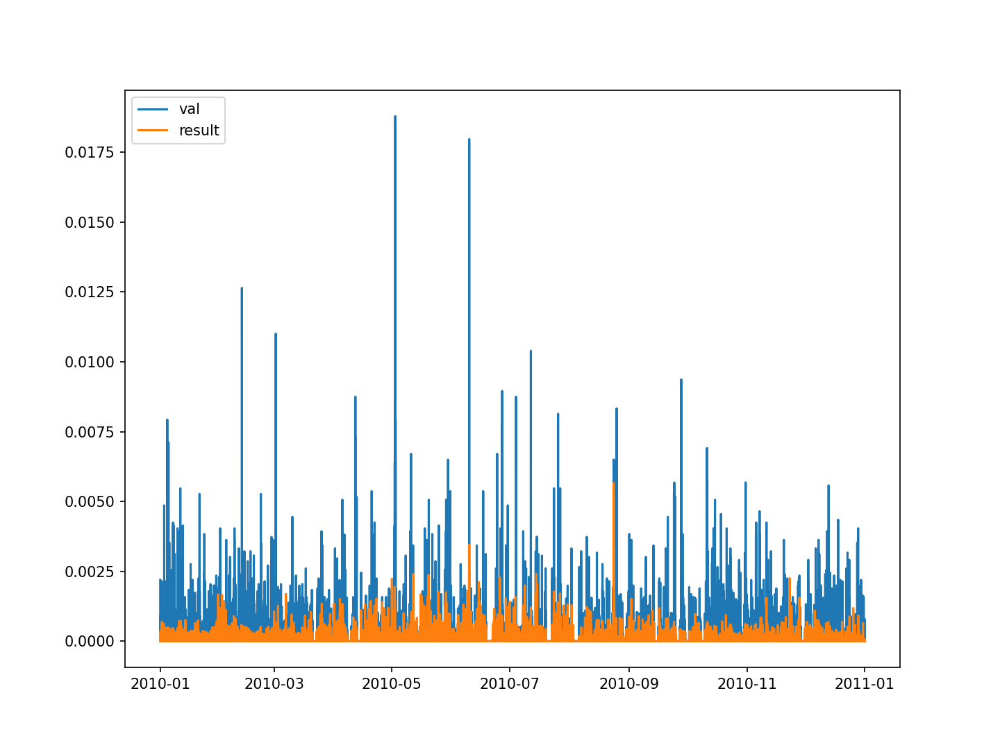

<IPython.core.display.Javascript object>


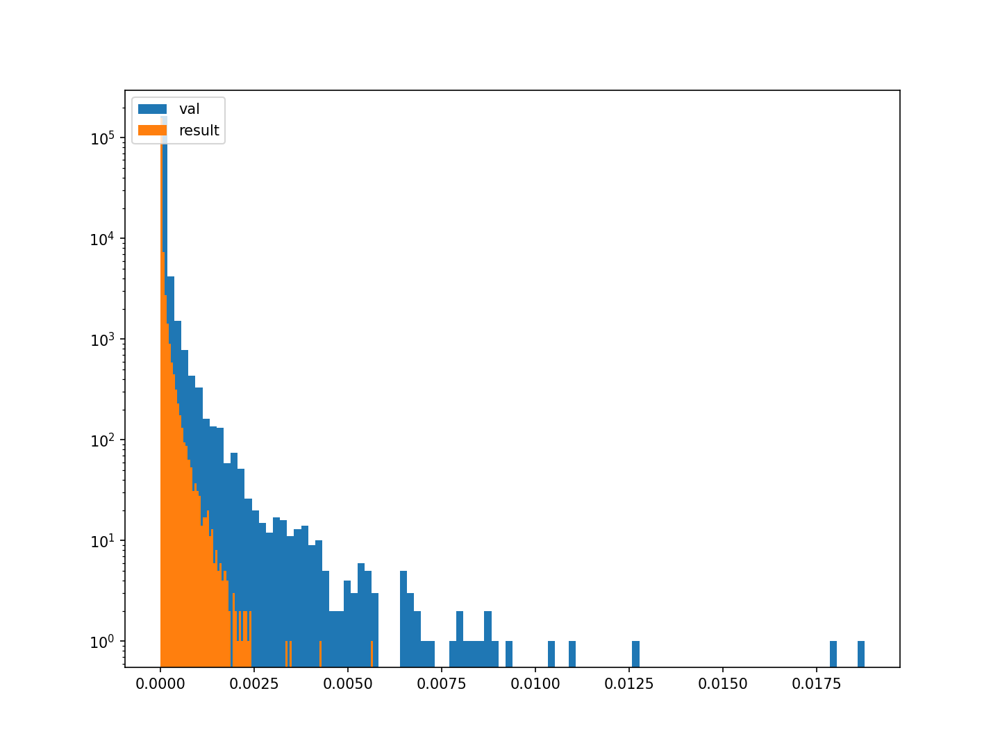

<IPython.core.display.Javascript object>


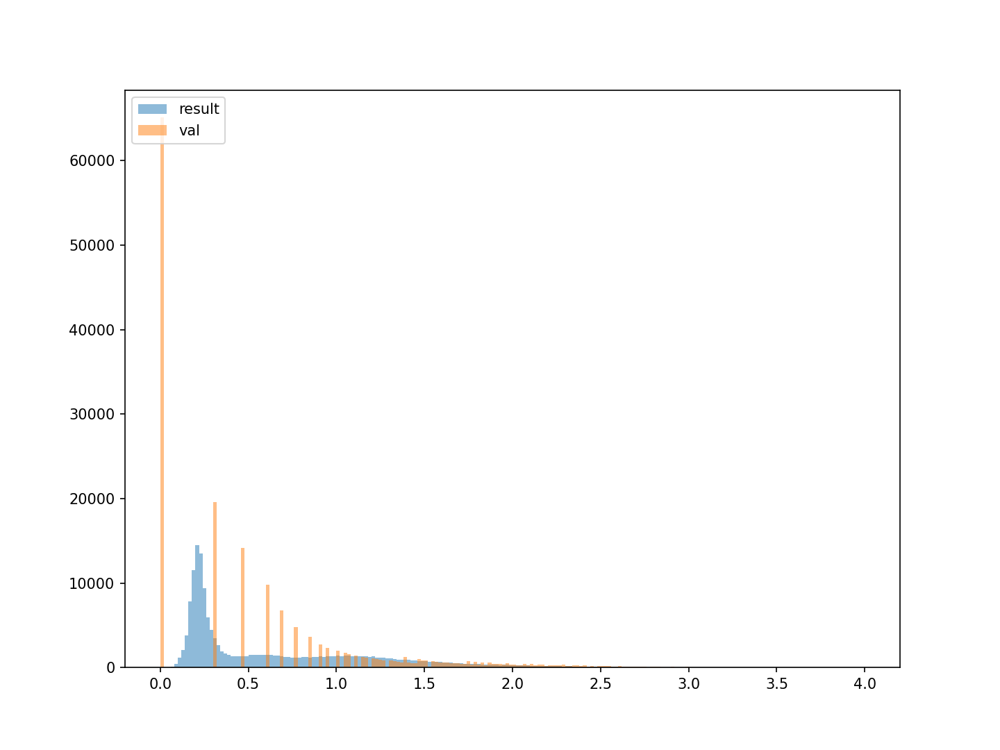

(171410, 1) (171410, 1)


<IPython.core.display.Javascript object>


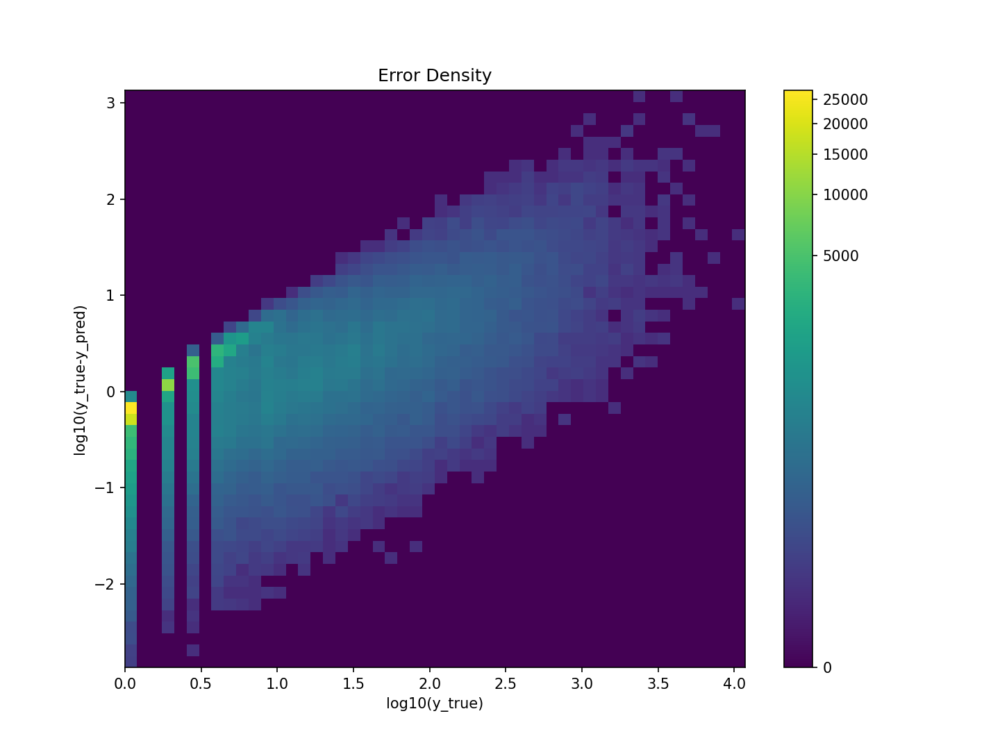

18


<IPython.core.display.Javascript object>


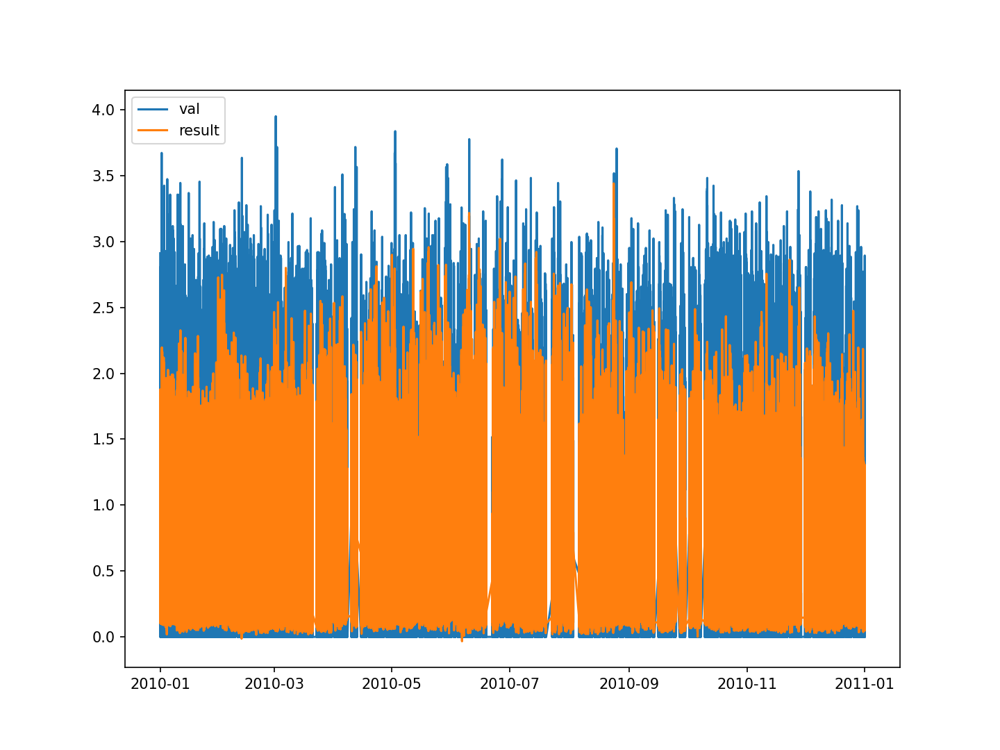

<IPython.core.display.Javascript object>


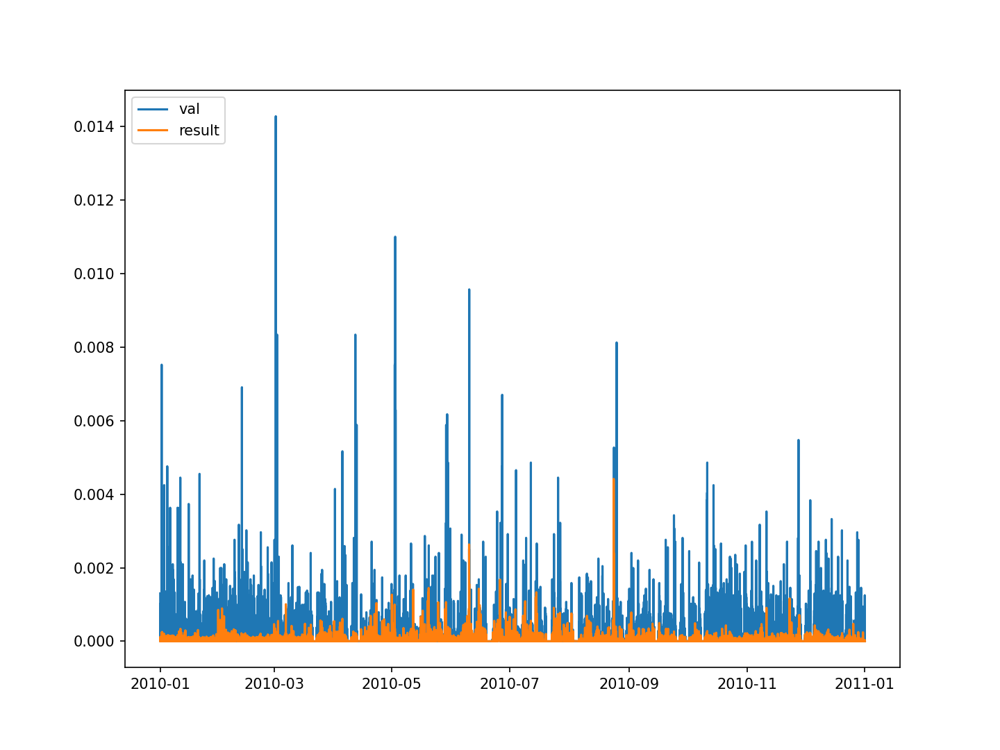

<IPython.core.display.Javascript object>


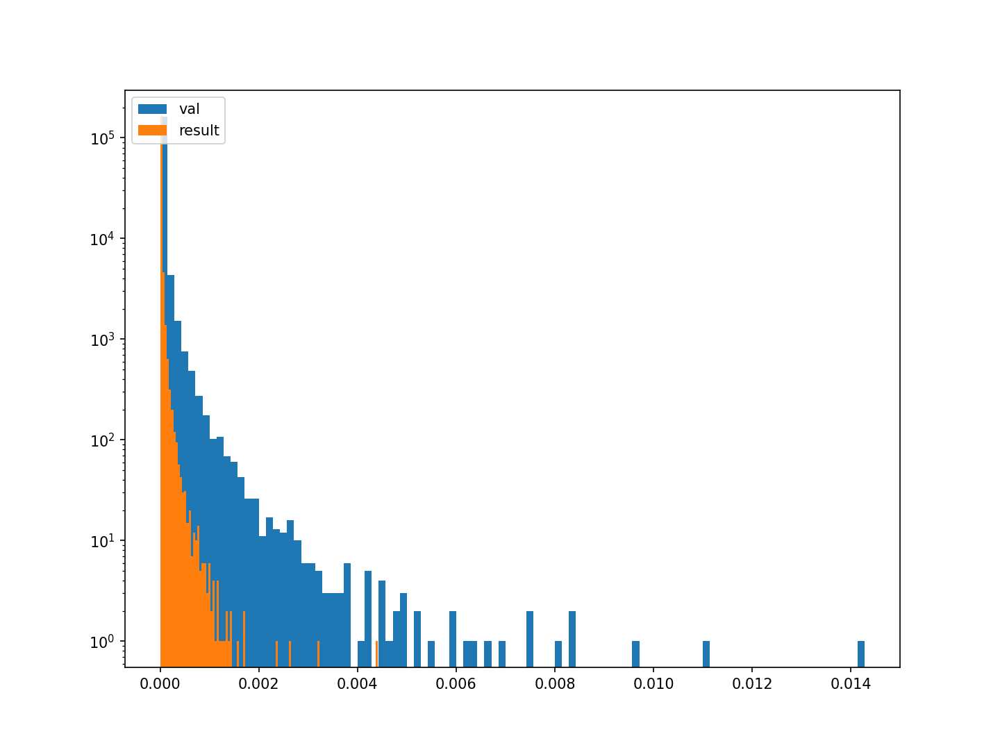

<IPython.core.display.Javascript object>


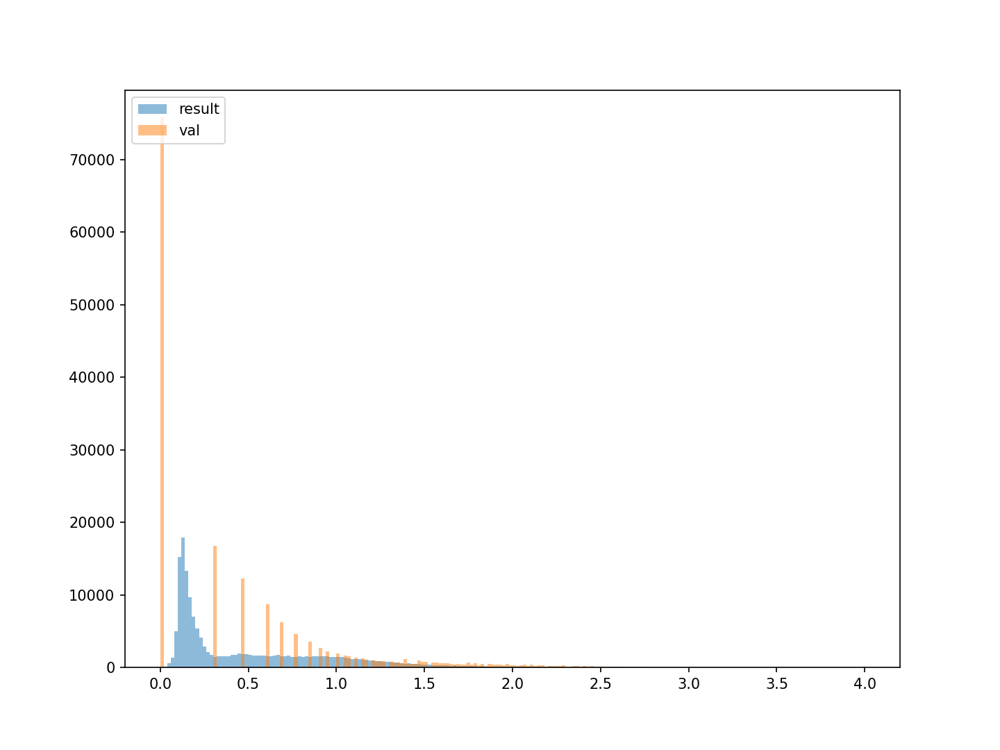

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [17]:

for k in range(0,19):
    print(k)
    df_results = pd.DataFrame(data=results[:,k], index = df_val.index)
    y_val_log = pd.DataFrame(data=temp.values[:,k], index = df_val.index)


    plt.figure()
    plt.plot(y_val_log[:])
    plt.plot(df_results[:])
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    plt.figure()
    plt.plot(10**y_val_log[:]*1.6e-6)
    plt.plot(10**df_results[:]*1.6e-6)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
    plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    minr = 0 #np.min(y_val_log.values)
    maxr = 4 #np.max(y_val_log.values)
    plt.figure()
    plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.legend(['result','val'], loc='upper left')
    plt.show()

    gamma = 0.2#[0.8, 0.5, 0.3]
    errors= y_val_log.values-df_results.values
    print(y_val_log.values.shape, errors.shape)

    plt.figure();
    plt.hist2d(y_val_log.values[:,0], errors[:,0],
                  bins=50, norm=mcolors.PowerNorm(gamma))
    plt.colorbar()
    plt.title('Error Density')
    plt.xlabel('log10(y_true)')
    plt.ylabel('log10(y_true-y_pred)')

    plt.show()


In [18]:
filename='channel_counts_tail_loss_new_pipeline_33'
model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss})

with open ('scalar_X_33_channel_counts_new_DB.pkl', 'wb') as f:
  pickle.dump(scaler_X, f)

with open ('scalar_X_33_channel_counts_new_DB.pkl', 'rb') as f:
    scalar_X =pickle.load(f)
print(model.evaluate(scaler_X.transform(X_val.values),y_val_log.values))

results = model.predict( X_test)

df_results = pd.DataFrame(data=results, index = y_val_log.index)



INFO:tensorflow:Assets written to: channel_counts_tail_loss_new_pipeline_33/assets
5357/5357 [==============================] - 6s 1ms/step - loss: 0.6524 - mean_squared_error: 0.5315
[0.6524062752723694, 0.531520664691925]
